## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'coco-indoor' 
TRANSFORM = 'gabor'
CHANNEL = 'green'
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
green_gabor_indoor_coco.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/coco/indoor/gabor/green'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 65536000,
 1: 65536000,
 2: 65536000,
 3: 65536000,
 4: 65536000,
 5: 65536000,
 6: 65536000,
 7: 65536000,
 8: 65536000,
 9: 65536000,
 10: 65536000,
 11: 65536000,
 12: 65536000,
 13: 65536000,
 14: 65536000,
 15: 65536000,
 16: 65536000,
 17: 65536000,
 18: 65536000,
 19: 65536000,
 20: 65536000,
 21: 65536000,
 22: 65536000,
 23: 65536000,
 24: 65536000,
 25: 65536000,
 26: 65536000,
 27: 65536000,
 28: 65536000,
 29: 65536000,
 30: 65536000,
 31: 65536000,
 32: 65536000,
 33: 65536000,
 34: 65536000,
 35: 65536000,
 36: 65536000,
 37: 65536000,
 38: 65536000,
 39: 65536000,
 40: 65536000,
 41: 65536000}

Running 12760 CDFs


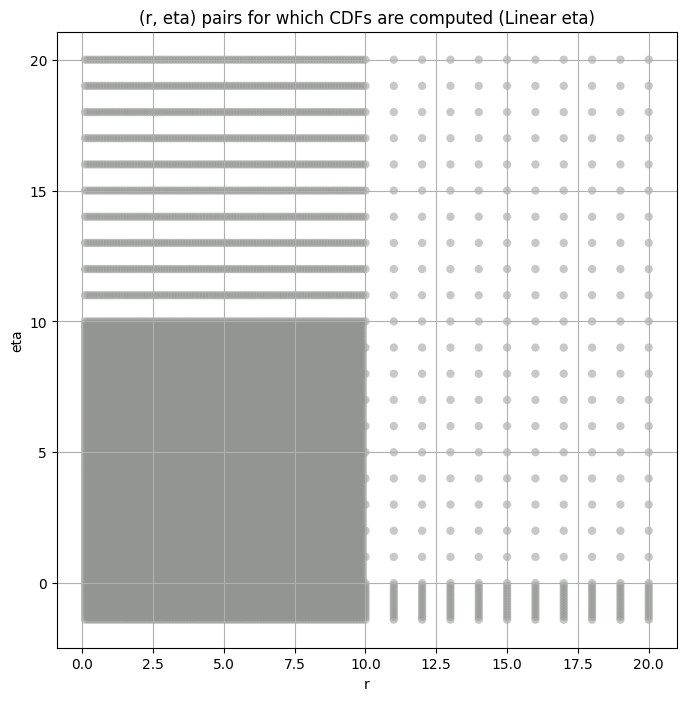

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,49240.44000,38882.65000,60244.74600,4.773906,2.801561,11.781327,65536000.0,"(2.0, 0.5, 0.044)"
1,17537.88500,13703.03100,22308.49800,6.268736,3.636876,14.473557,65536000.0,"(2.0, 0.5, 0.065)"
2,6263.64750,4817.59230,8065.39060,8.682725,4.491842,22.594627,65536000.0,"(2.0, 0.5, 0.096)"
3,2366.95400,1740.60230,3189.22300,11.592262,5.991223,32.245300,65536000.0,"(2.0, 0.5, 0.141)"
4,947.27313,670.49140,1259.57480,13.660814,7.580907,37.590374,65536000.0,"(2.0, 0.5, 0.208)"
5,332.07900,220.95845,459.92392,18.274677,8.888781,51.722927,65536000.0,"(2.0, 0.5, 0.306)"
6,206.10092,141.26283,293.74957,18.116974,9.422618,55.211193,65536000.0,"(2.0, 0.5, 0.45)"
7,69678.76000,56125.30500,86983.69000,5.744799,3.133826,17.976940,65536000.0,"(2.0, 1.0, 0.044)"
8,24894.46500,19084.35500,32298.96900,8.052679,3.912416,27.094390,65536000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,49240.44000,49240.441406,47567.019531,46445.722656,44603.152344
1,17537.88500,17537.884766,16844.732422,16382.721680,15628.656250
2,6263.64750,6263.647461,5955.544434,5756.745605,5439.666016
3,2366.95400,2366.954102,2227.281738,2137.677490,1998.309448
4,947.27313,947.273132,884.612366,845.869751,785.701538
5,332.07900,332.079010,306.244934,289.562317,264.286011
6,206.10092,206.100922,190.327484,180.119293,164.558533
7,69678.76000,69678.757812,66897.539062,65056.144531,62149.707031
8,24894.46500,24894.464844,23650.328125,22874.410156,21673.167969


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.010289977054225075 49240.44


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.010663826114000852 47567.02


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.010135146501411063 46445.723


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.01224741284845099 44603.152
Number of samples: 100000, Without approximation : 65536000.0


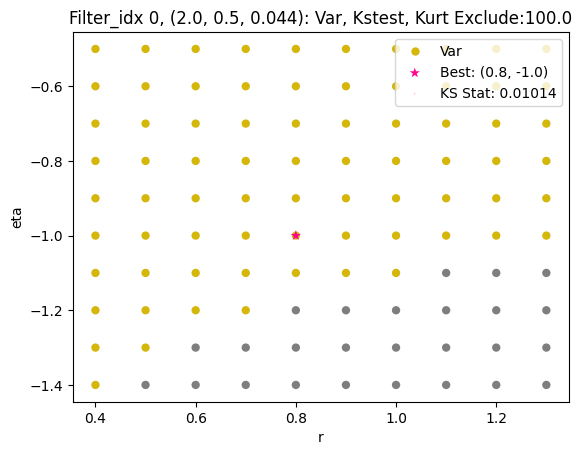

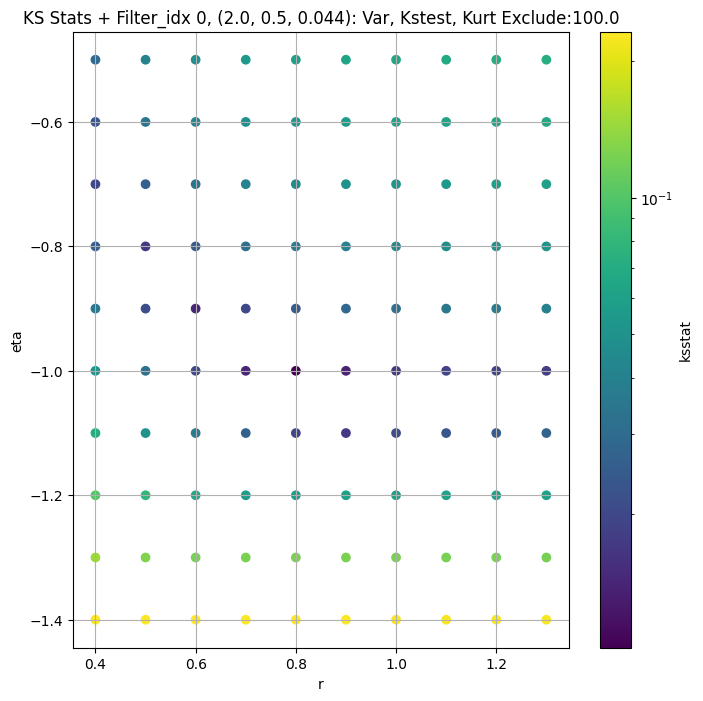

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.00746831760839517 17537.885


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.006708259495582597 16844.732


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.008197611149300066 16382.722


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.008425630086754884 15628.656
Number of samples: 100000, Without approximation : 65536000.0


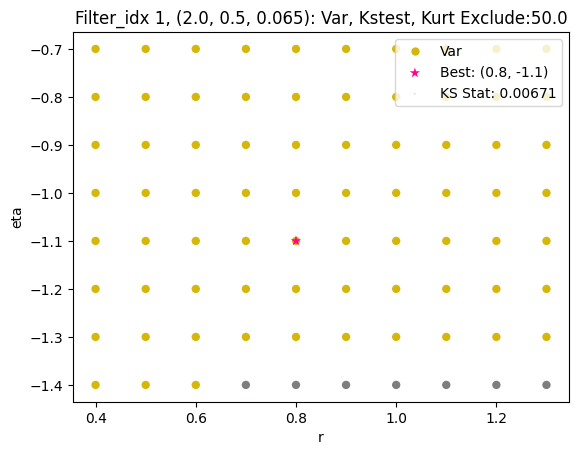

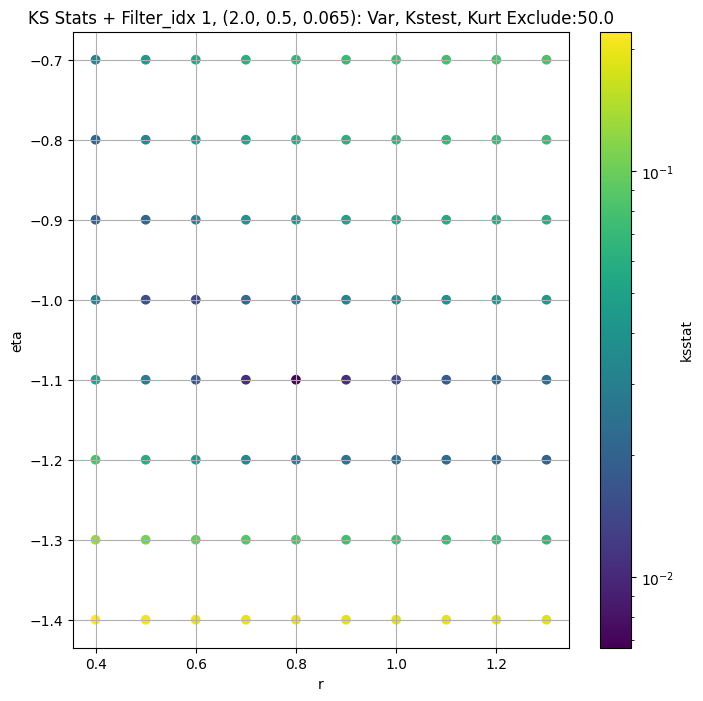

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.008868633307570761 6263.6475


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.007729854154101434 5955.5444


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.008619710995578761 5756.7456


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.011275474367573743 5439.666
Number of samples: 100000, Without approximation : 65536000.0


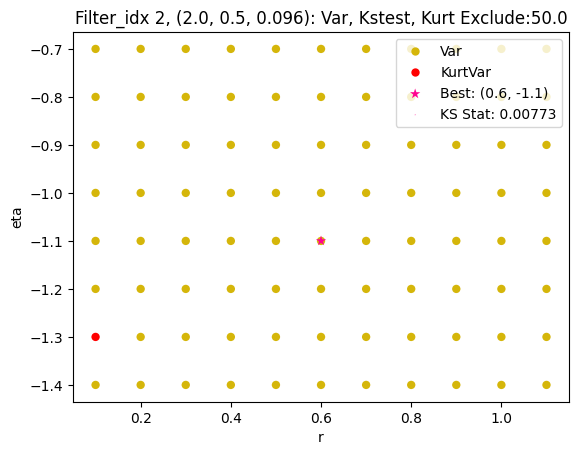

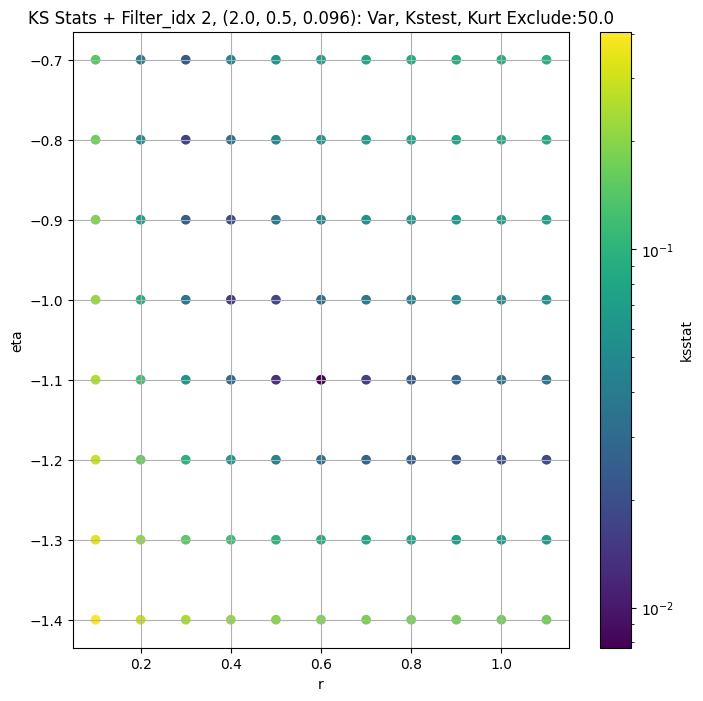

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.010779070429876247 2366.954


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.008107929581452566 2227.2817


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.008726084448291482 2137.6775


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.010465839147242417 1998.3094
Number of samples: 100000, Without approximation : 65536000.0


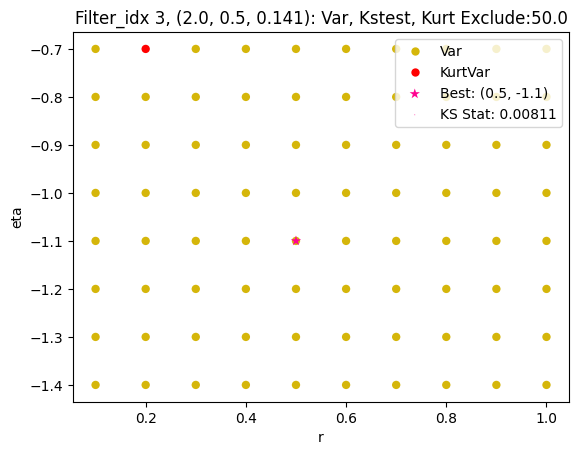

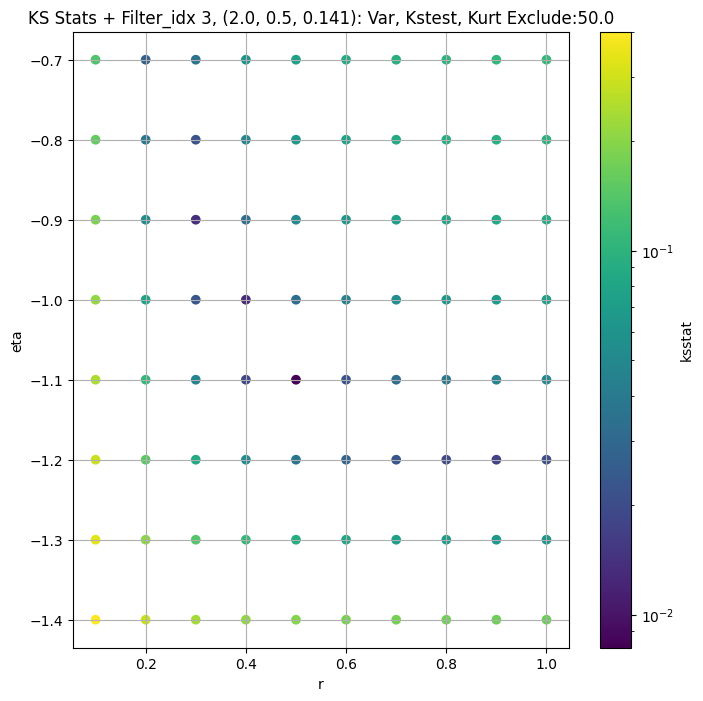

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.011090633437414676 947.27313


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.009855380966987126 884.61237


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.009956919723095481 845.86975


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.009871257609720296 785.70154
Number of samples: 100000, Without approximation : 65536000.0


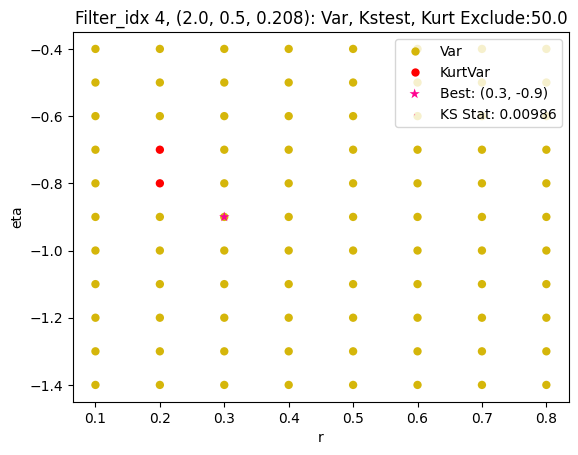

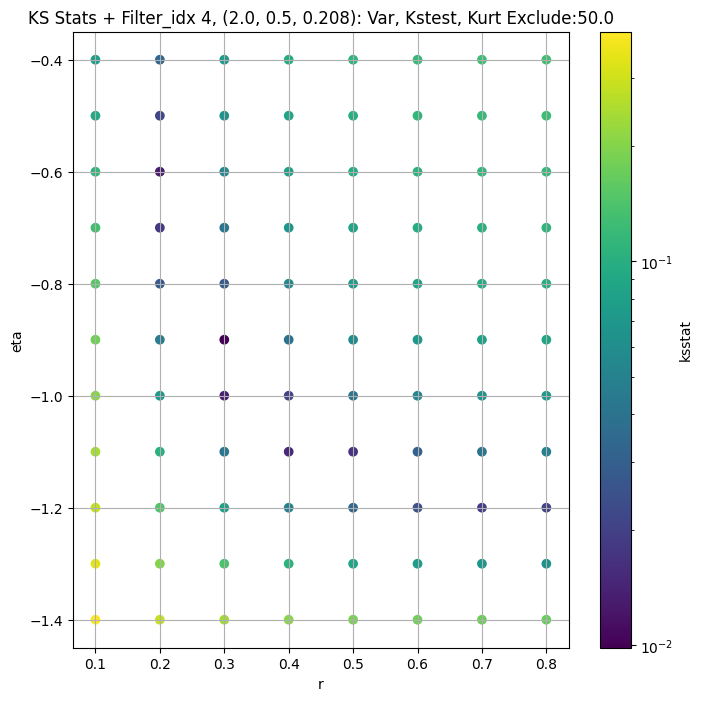

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.008182690991622166 332.079


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.008181149219023798 306.24493


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.008180045745303732 289.56232


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.010478795716557632 264.286
Number of samples: 100000, Without approximation : 65536000.0


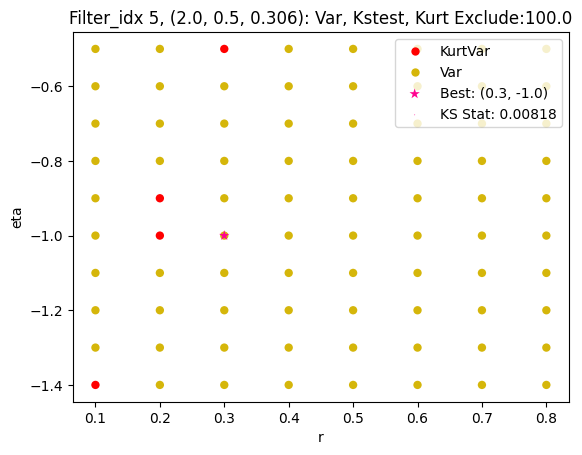

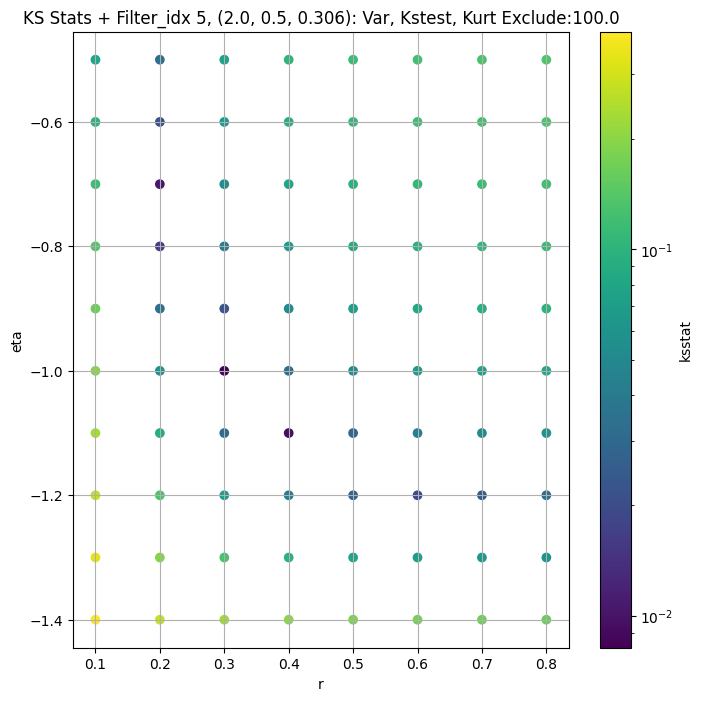

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.010542818058721759 206.10092


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.010450902662988537 190.32748


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.010444782107843442 180.1193


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.01042416137150648 164.55853
Number of samples: 100000, Without approximation : 65536000.0


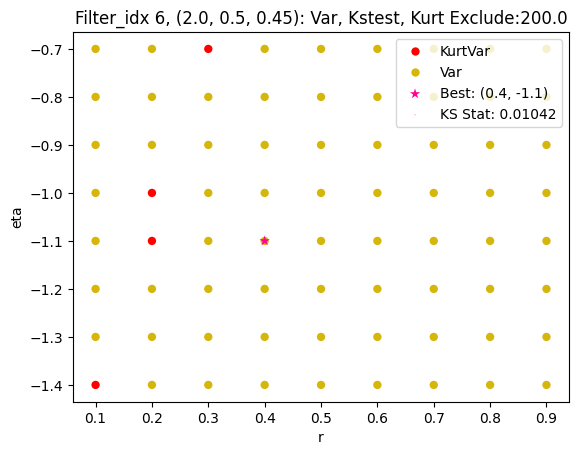

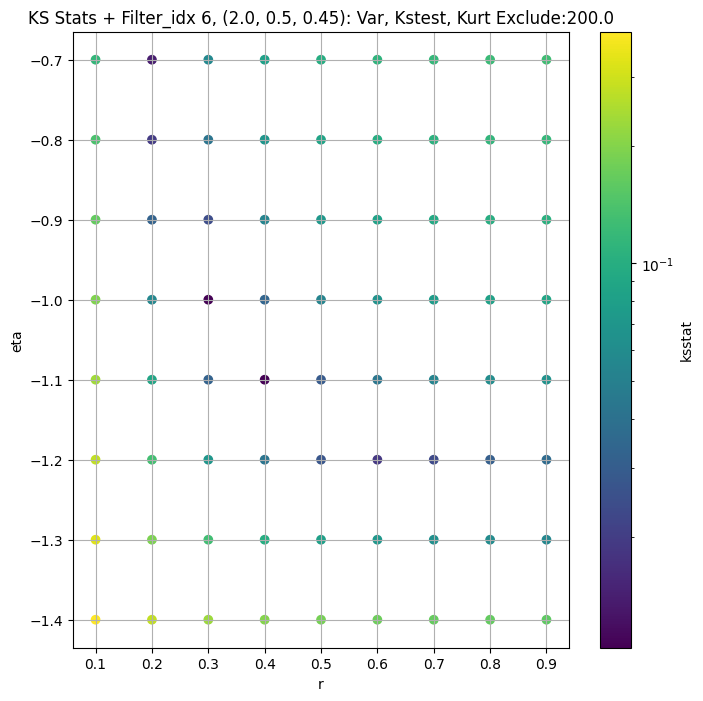

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.006721110033888755 69678.76


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.006721110033888755 66897.54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.008256694803578934 65056.145


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.008977016313109876 62149.707
Number of samples: 100000, Without approximation : 65536000.0


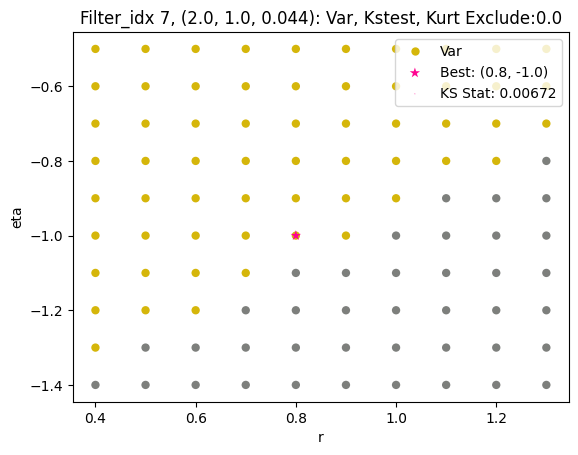

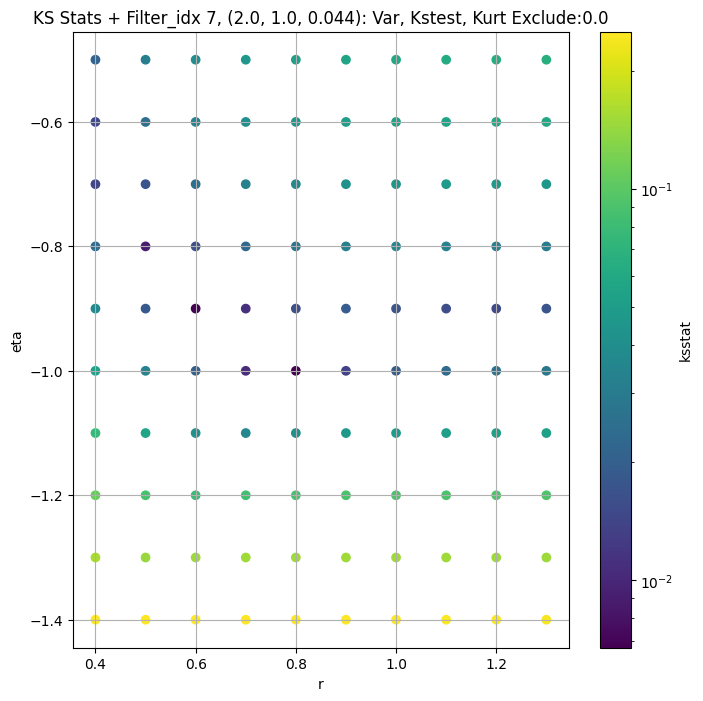

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.005341313413873894 24894.465


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.00484597682663418 23650.328


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.004815102574435681 22874.41


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.004756229529365247 21673.168
Number of samples: 100000, Without approximation : 65536000.0


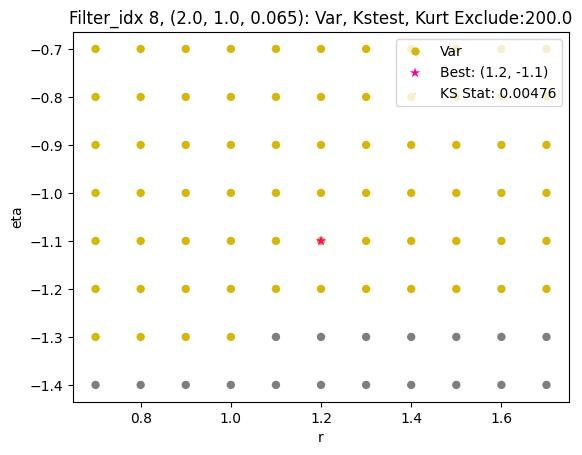

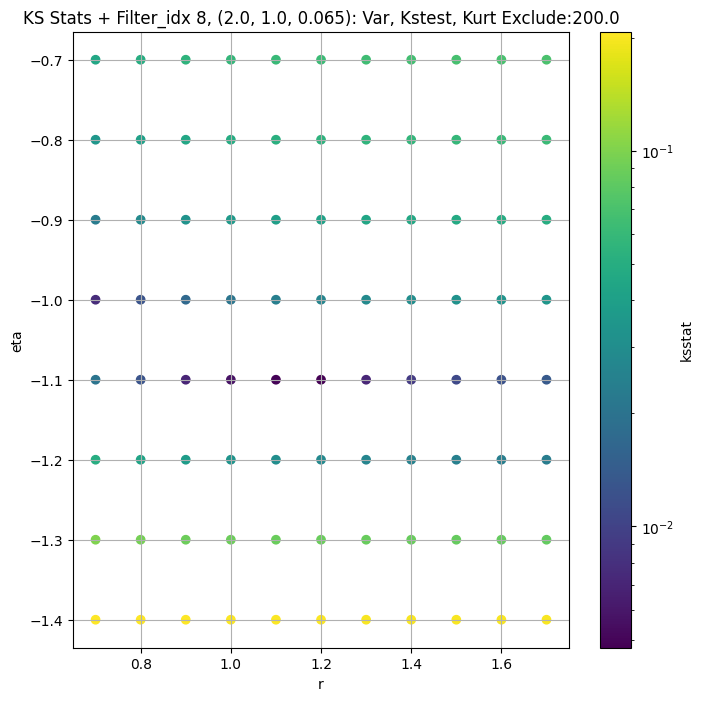

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.007225968784411063 9170.179


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.007676415453719665 8643.808


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.005892483548716521 8314.747


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.006246534118370242 7812.0664
Number of samples: 100000, Without approximation : 65536000.0


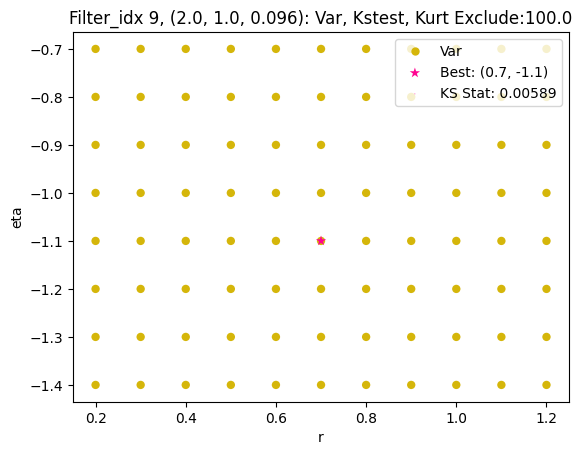

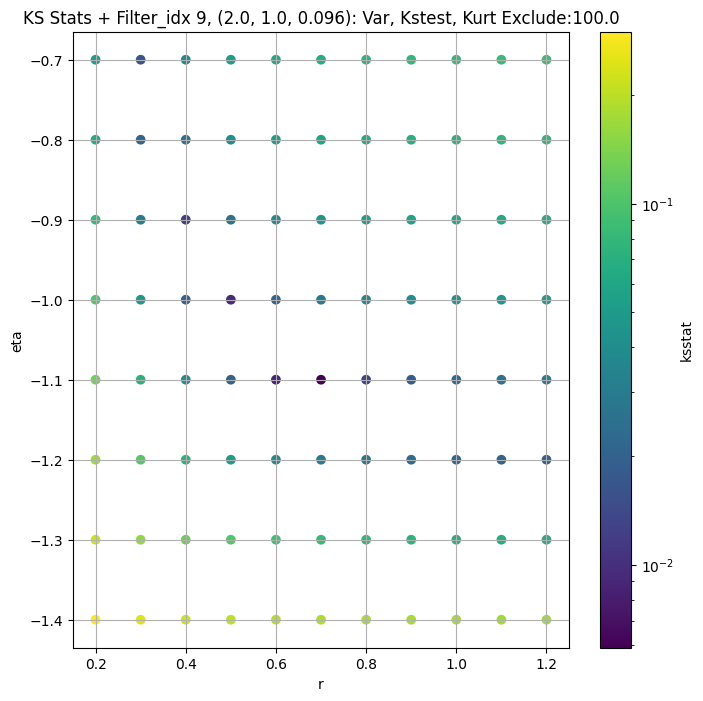

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.006535530868118644 3411.786


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.007310724141543226 3183.9238


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.009033654497644483 3043.1523


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.007174093136527948 2831.7476
Number of samples: 100000, Without approximation : 65536000.0


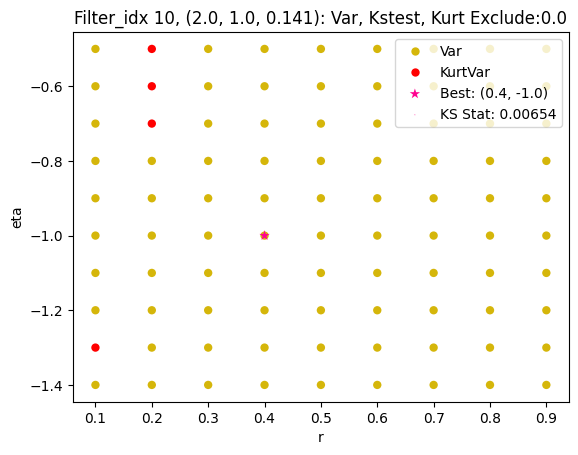

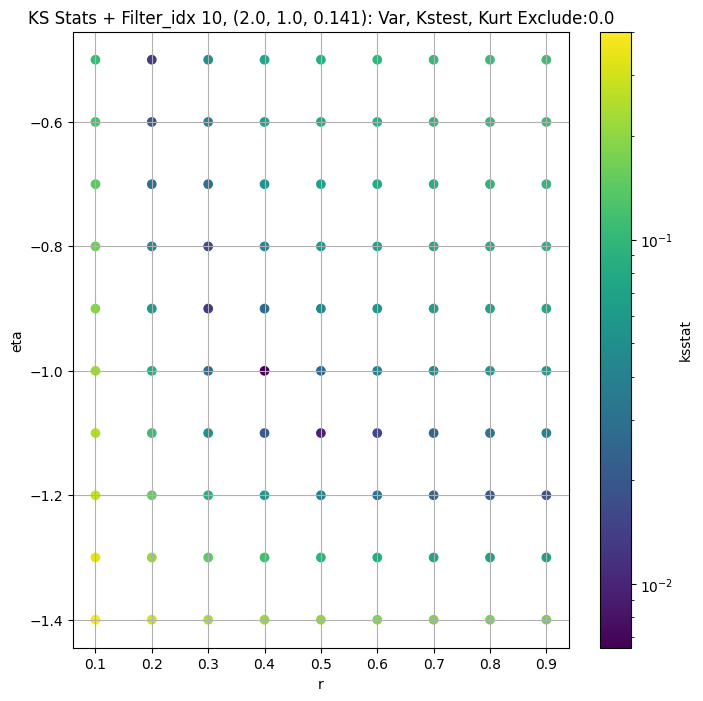

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.0071001074800405295 1237.6008


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.007628957294525063 1139.0726


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.007818473807335857 1081.3073


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.007713384353554065 994.53516
Number of samples: 100000, Without approximation : 65536000.0


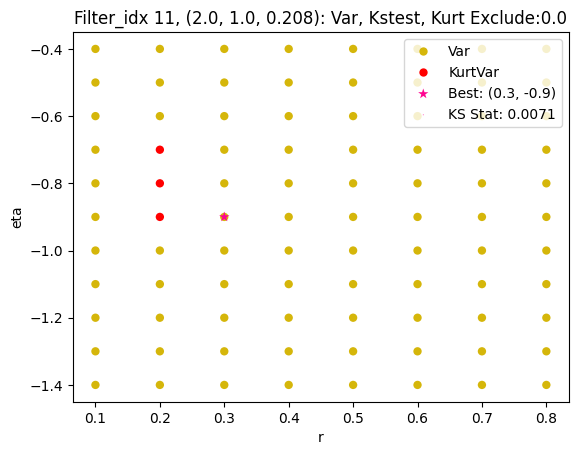

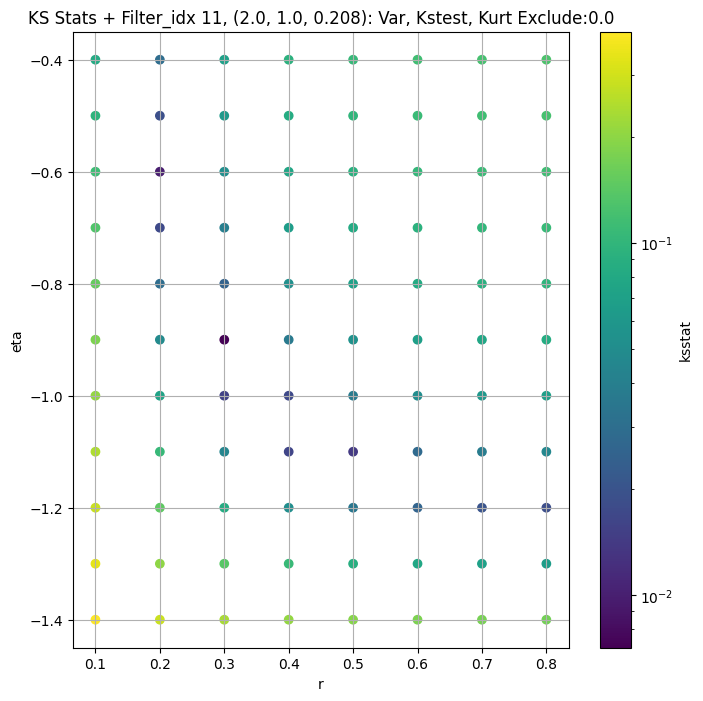

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.0064702579191266985 476.75684


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.008692870695836907 432.71375


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.010350947900454155 407.36838


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.008885940441705542 370.82425
Number of samples: 100000, Without approximation : 65536000.0


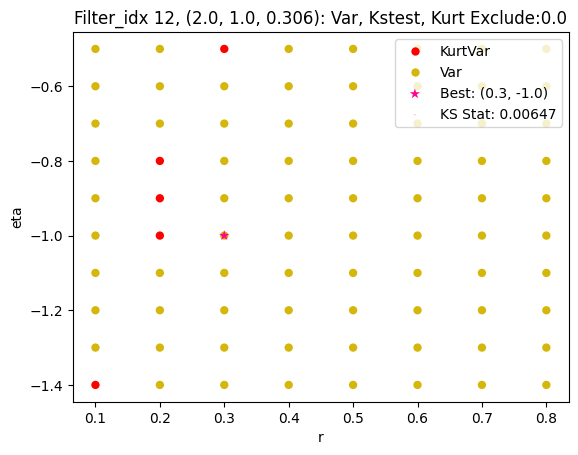

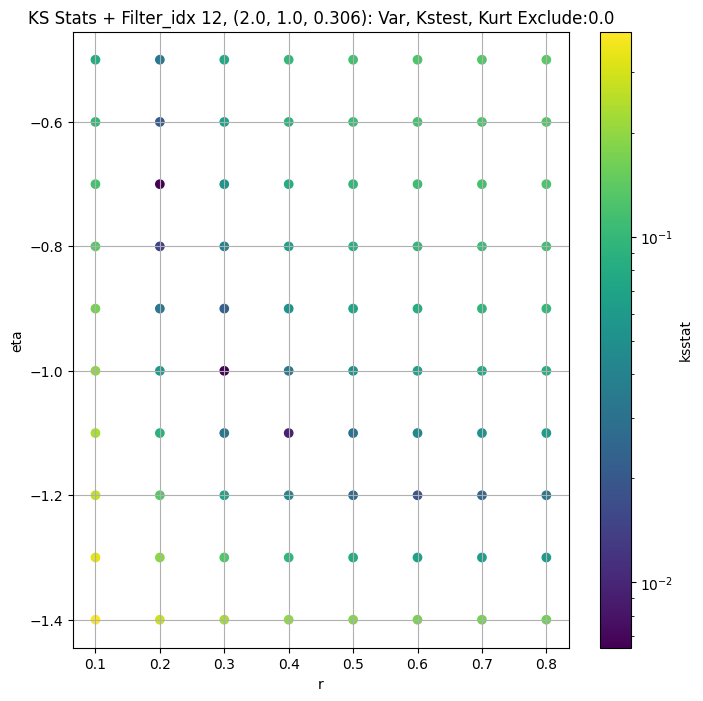

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.009566173026533509 219.55444


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.010251334123815181 196.11433


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.009546785779534939 182.9929


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.009531339054206556 163.71443
Number of samples: 100000, Without approximation : 65536000.0


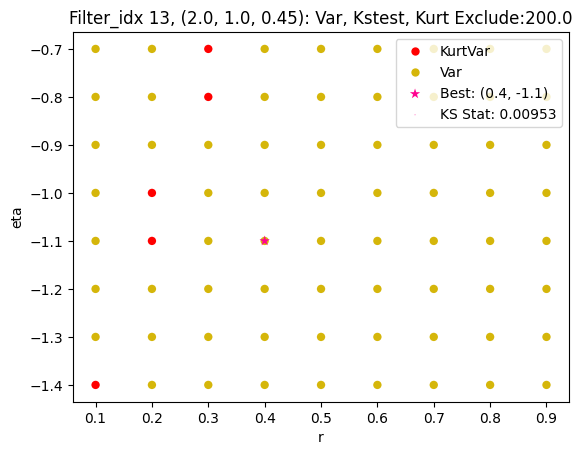

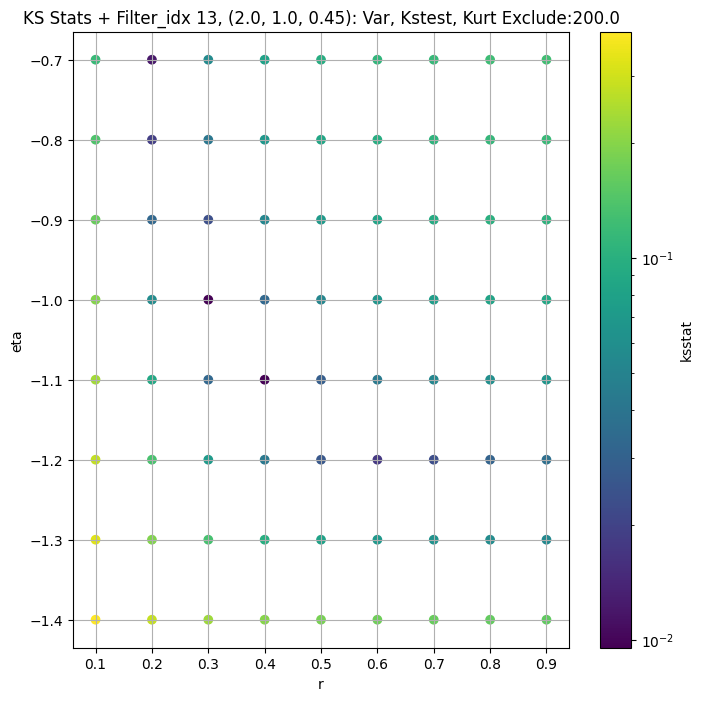

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.005726823810624726 46275.812


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.005775708585485595 44380.54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.006692374354159258 43158.133


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.008995211091085073 41213.645
Number of samples: 100000, Without approximation : 65536000.0


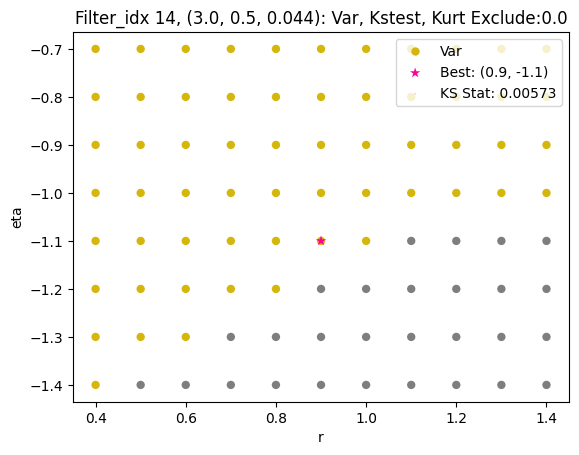

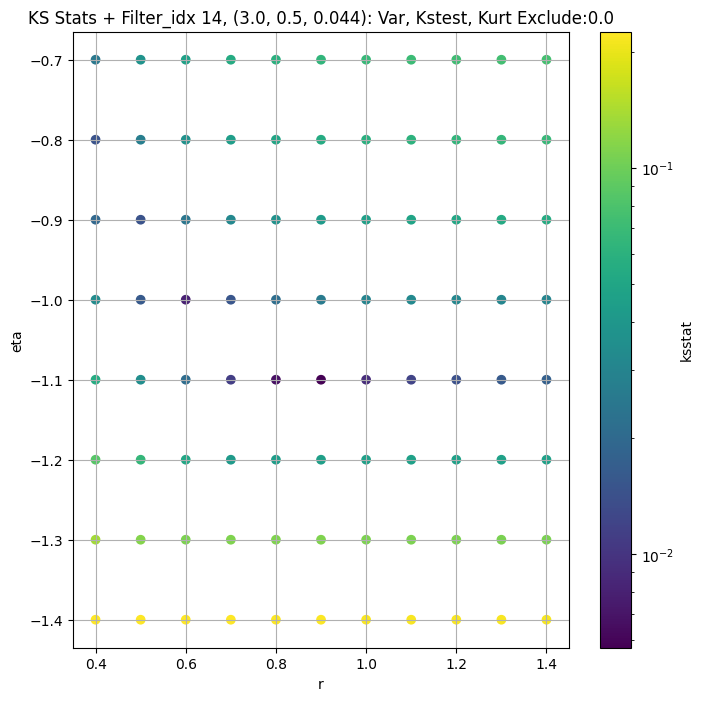

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.007171757017501057 16272.881


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.007786242985253489 15450.383


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.008247175035984267 14933.116


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.008978666586253237 14120.05
Number of samples: 100000, Without approximation : 65536000.0


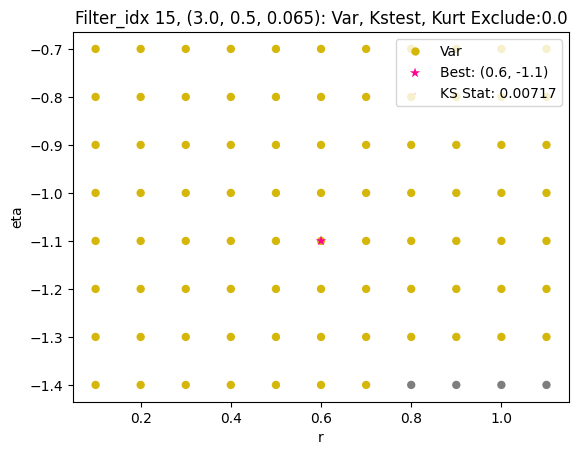

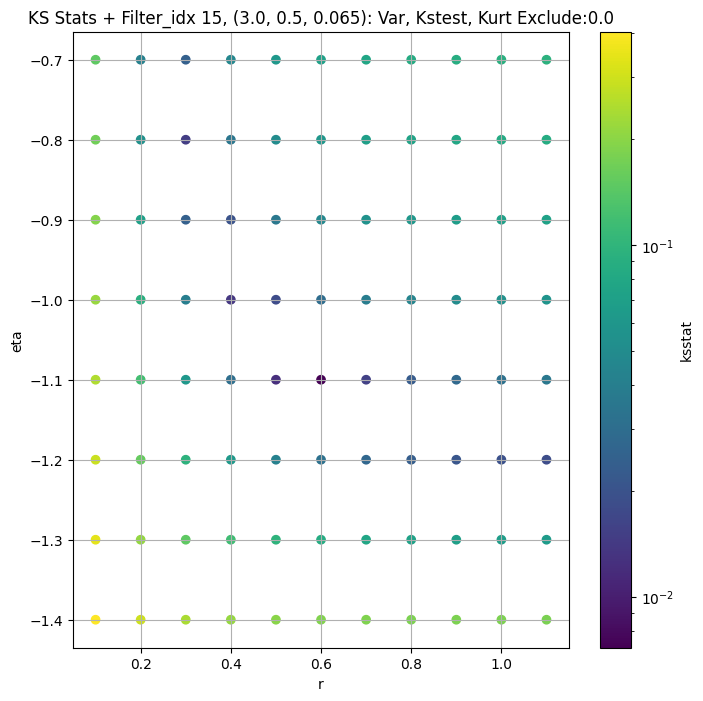

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.011152796984216562 5788.9126


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.009667636991228745 5445.4473


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.01029203950582891 5233.932


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.011370399098734829 4904.817
Number of samples: 100000, Without approximation : 65536000.0


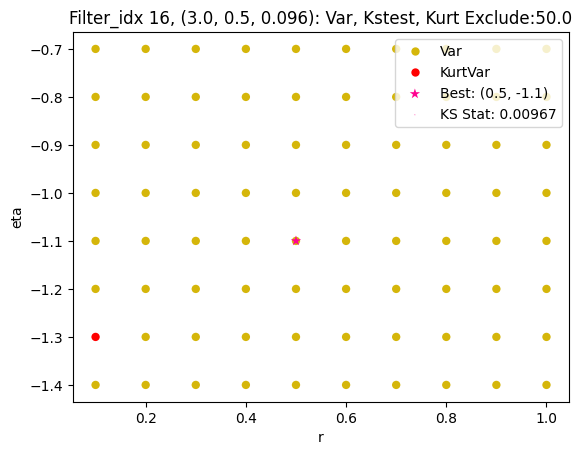

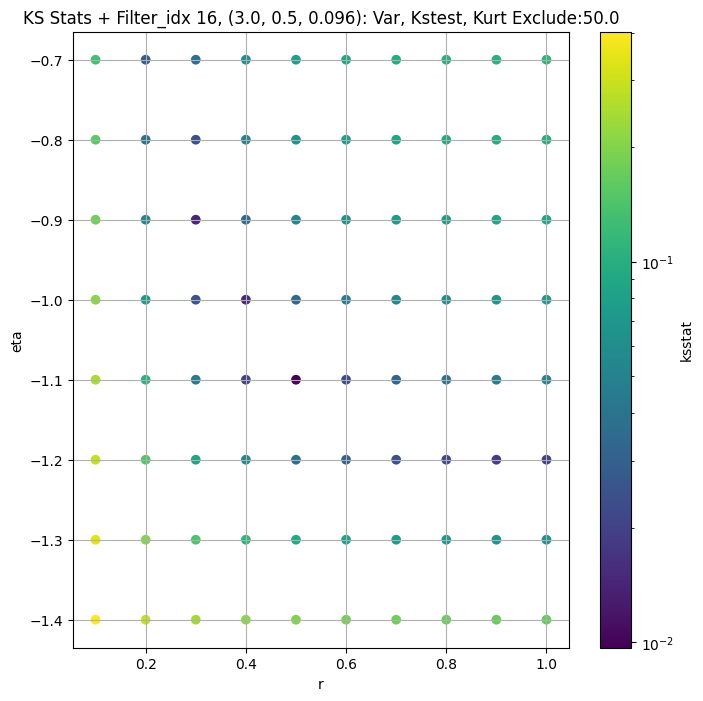

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.011311095396907611 2220.192


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.013279446906646897 2052.5625


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.013446913330243879 1955.0228


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.011712082443659289 1806.9886
Number of samples: 100000, Without approximation : 65536000.0


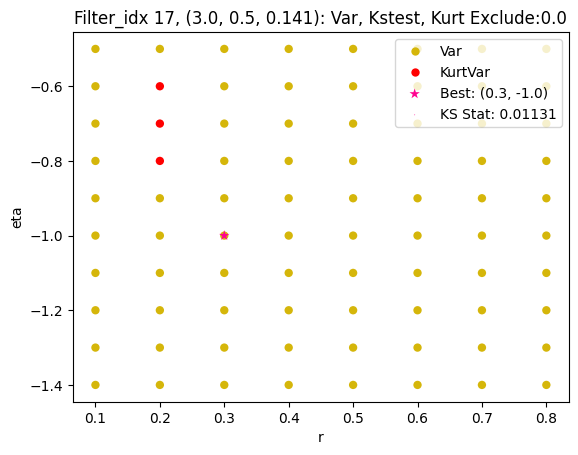

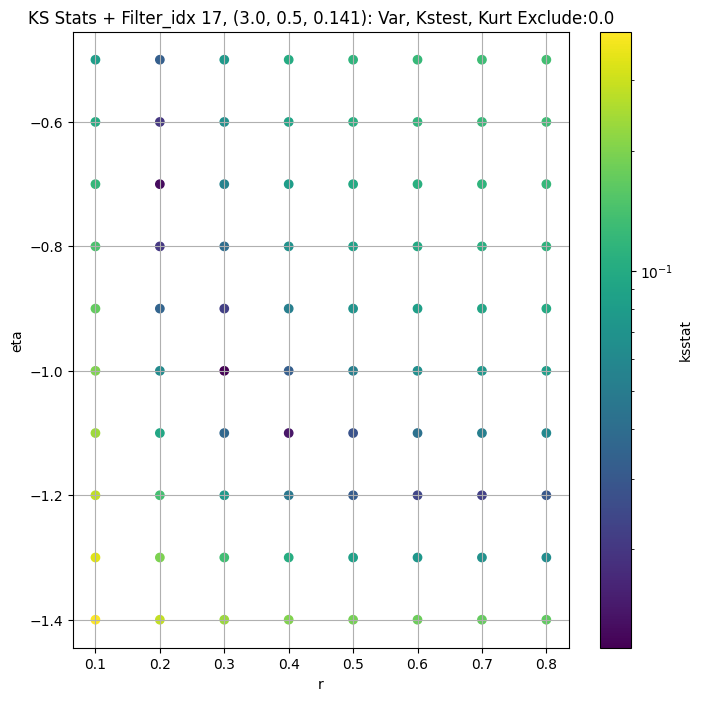

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.00985416479020075 881.74634


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.008571504751433312 804.38086


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.00987993076751087 760.64716


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.011545256063403564 695.81854
Number of samples: 100000, Without approximation : 65536000.0


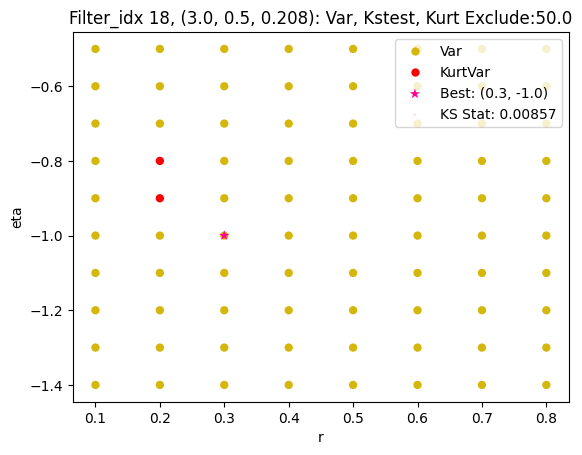

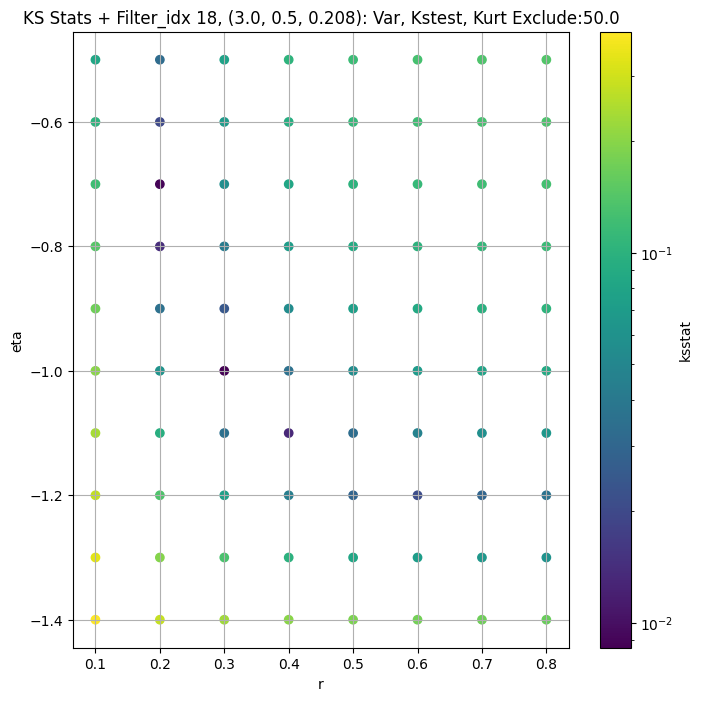

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.007504664885331469 324.85986


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.007393949980747494 291.95532


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.009602495707742825 273.20377


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.007095510737492067 245.04263
Number of samples: 100000, Without approximation : 65536000.0


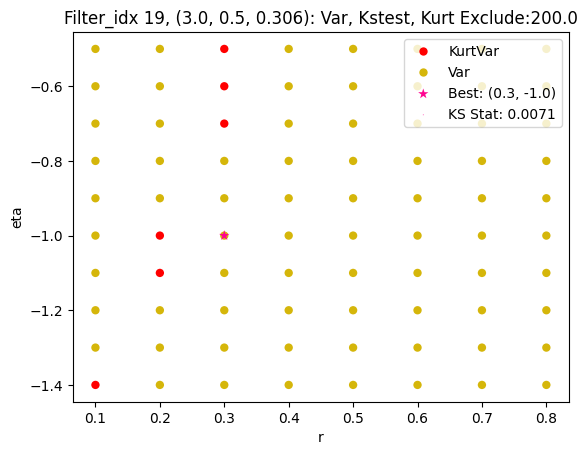

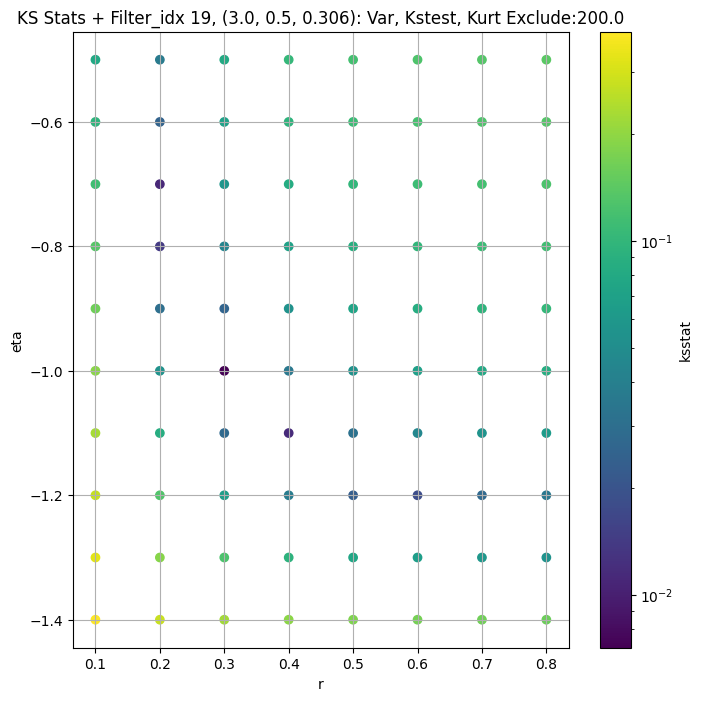

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.012185503054771951 165.35185


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.009232195399603349 146.85681


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.011895046984859214 136.27818


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.016465753706591868 120.80008
Number of samples: 100000, Without approximation : 65536000.0


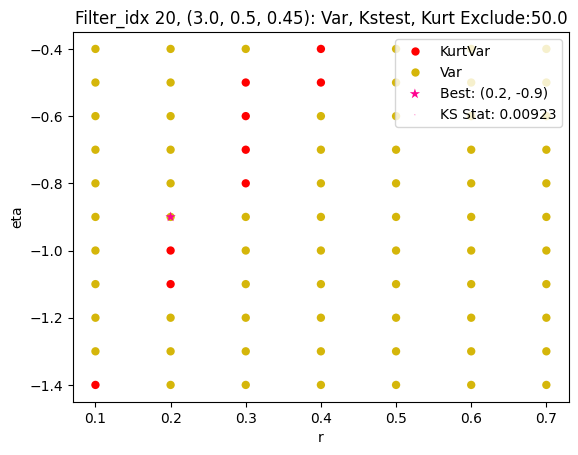

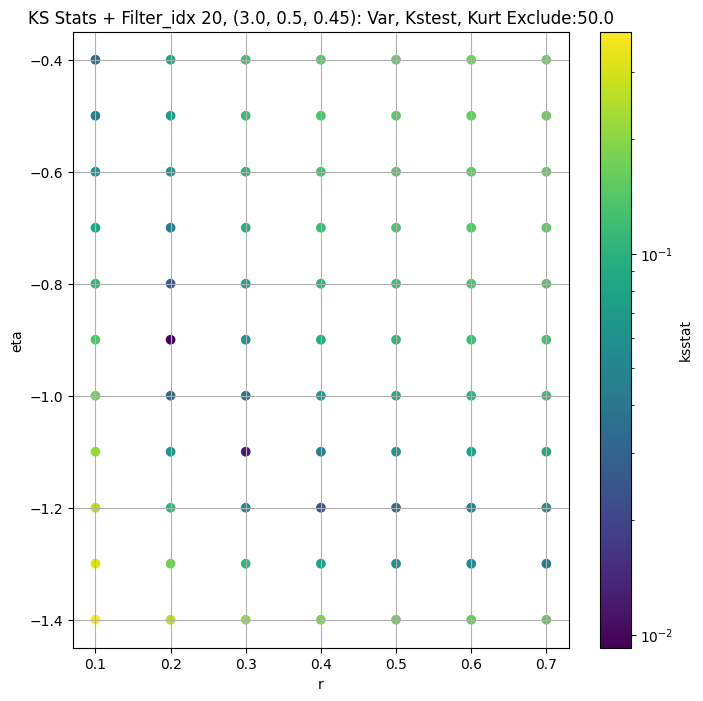

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.007631244930030423 55034.55


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.00672514844979466 51872.047


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.006017013759552575 49892.57


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.009571484392419075 46851.844
Number of samples: 100000, Without approximation : 65536000.0


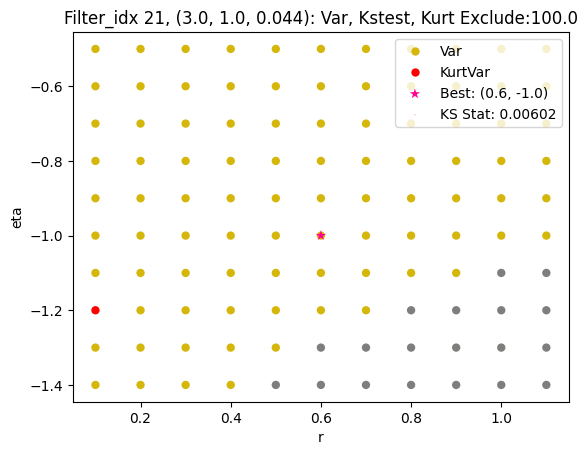

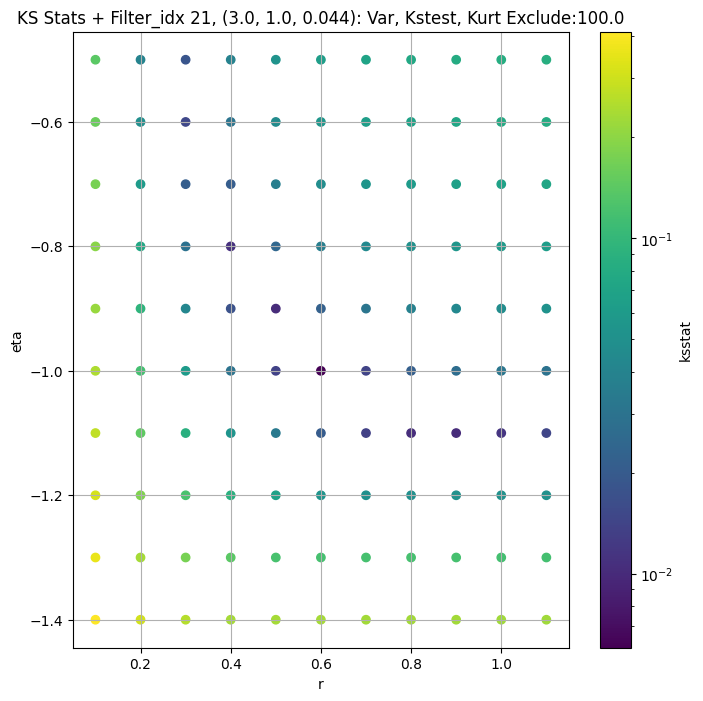

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.00801402571190439 19405.799


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.010485035612595839 18157.203


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.01116328677830869 17345.447


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.008909184227154476 16124.54
Number of samples: 100000, Without approximation : 65536000.0


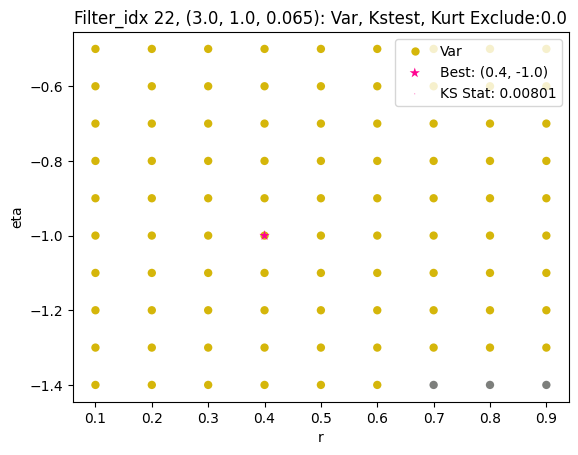

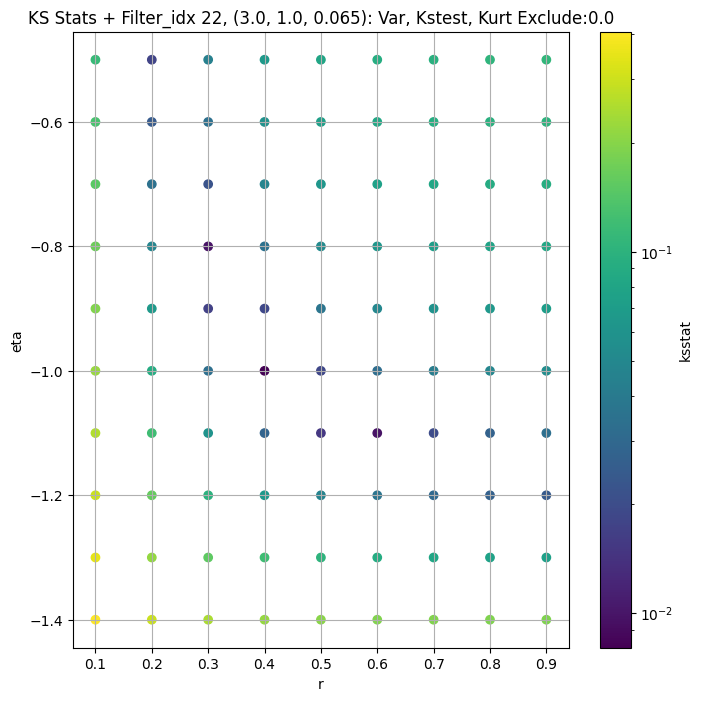

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.011689172786341073 7223.4434


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.009133390362803986 6641.382


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.01097217387502114 6285.958


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.010162230875972456 5759.4795
Number of samples: 100000, Without approximation : 65536000.0


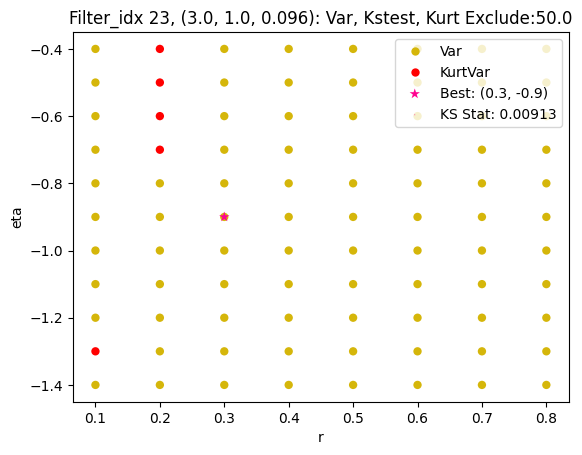

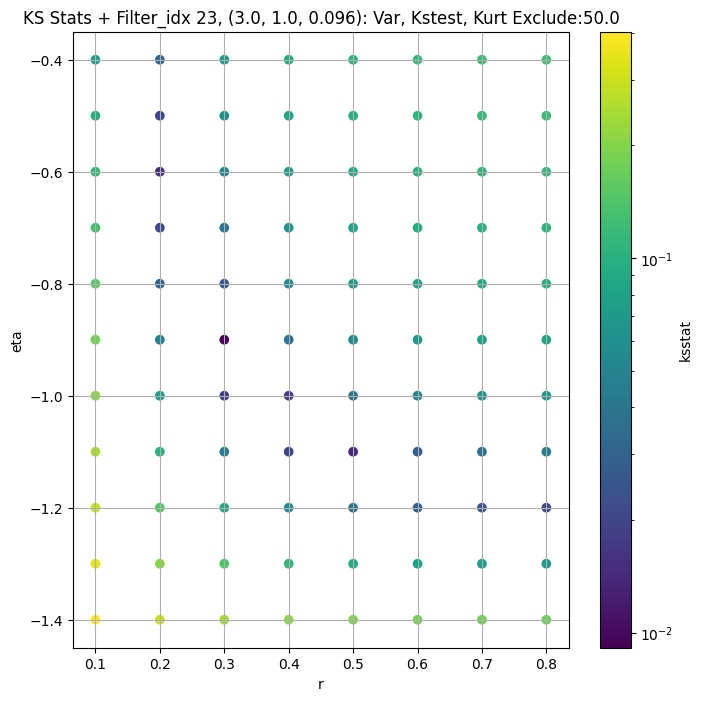

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.007877992027738145 2550.4194


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.011561985060423052 2291.717


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.012645975616076055 2143.4282


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.010239435938262265 1934.0385
Number of samples: 100000, Without approximation : 65536000.0


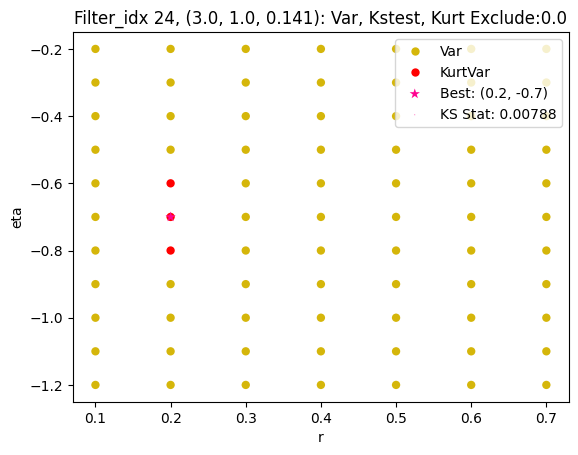

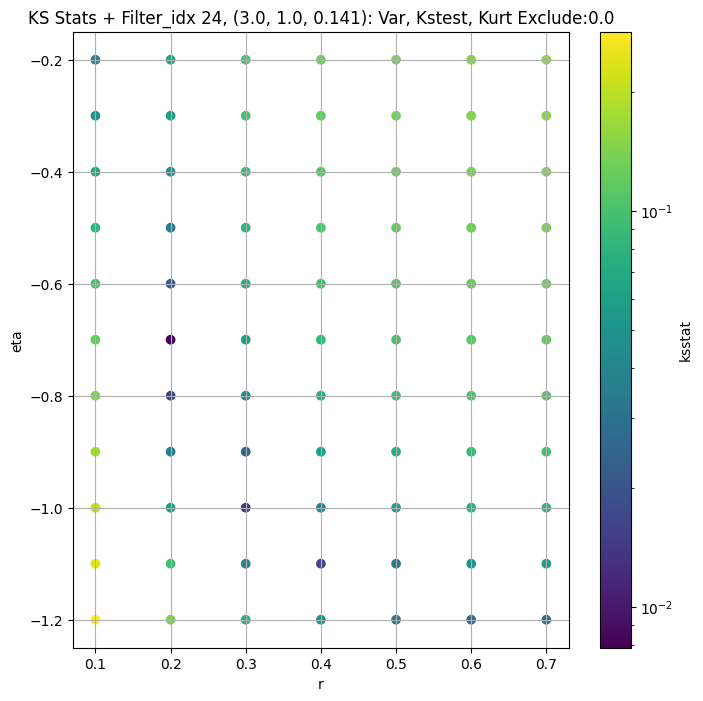

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.00867004590445275 993.3363


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.010374177347440505 877.4543


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.008046033194740065 814.34564


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.011648557058718922 725.81995
Number of samples: 100000, Without approximation : 65536000.0


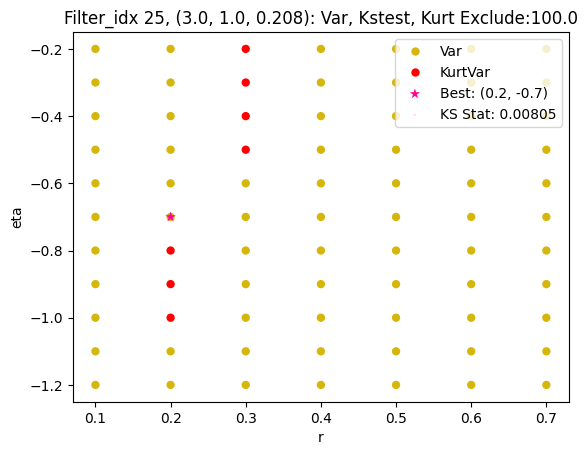

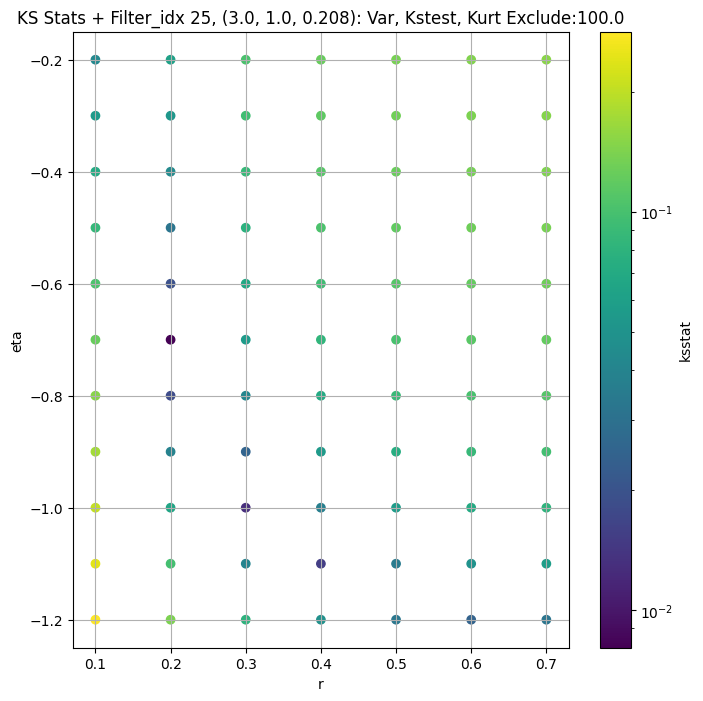

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.008494709457586735 378.0453


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.005097853234668416 325.42987


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.007167806774356578 297.9253


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.006722236542343496 261.14517
Number of samples: 100000, Without approximation : 65536000.0


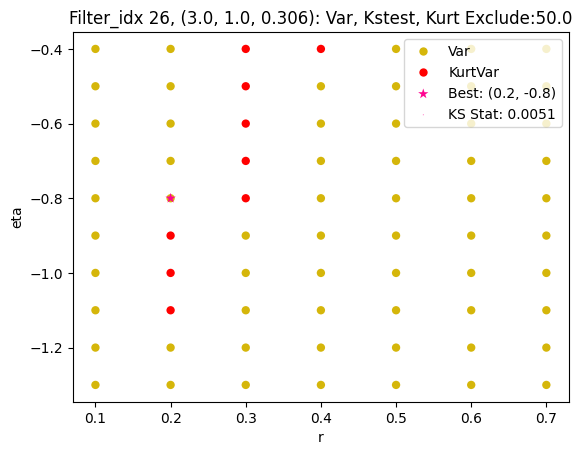

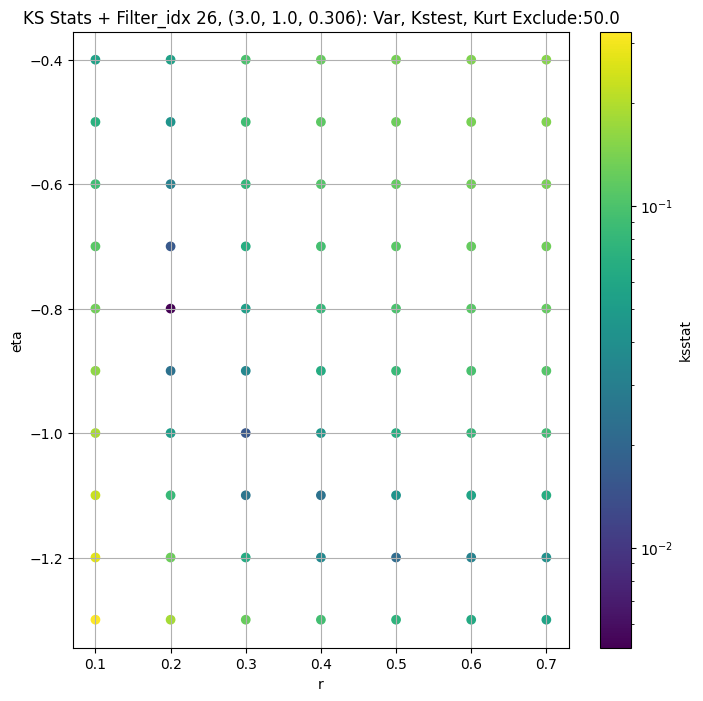

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.009852953017958965 170.64552


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.00880734246884507 143.7198


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.011856597470930041 130.05449


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.011372422846886998 112.67359
Number of samples: 100000, Without approximation : 65536000.0


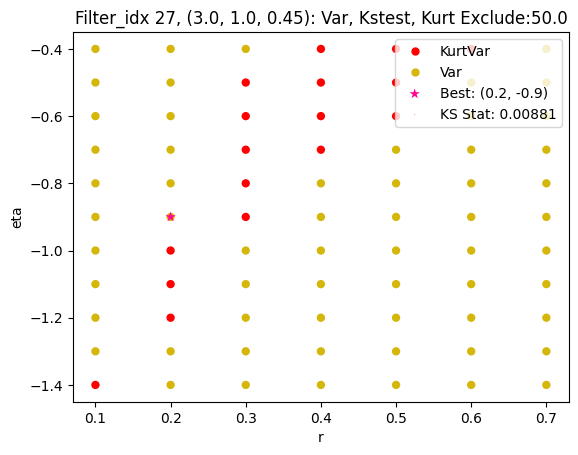

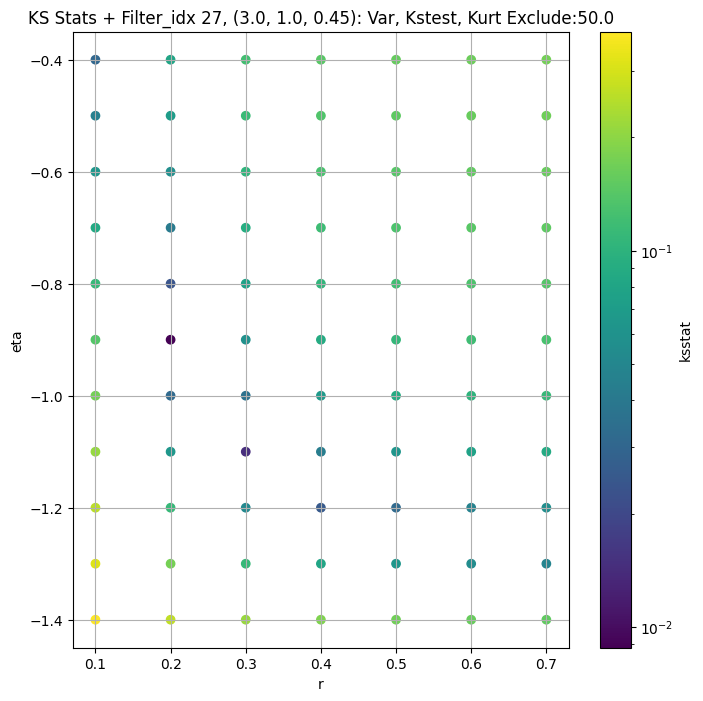

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.007378394622987949 44368.473


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.008993541817273298 42447.17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.008046692527956478 41222.477


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.010230229297507332 39301.79
Number of samples: 100000, Without approximation : 65536000.0


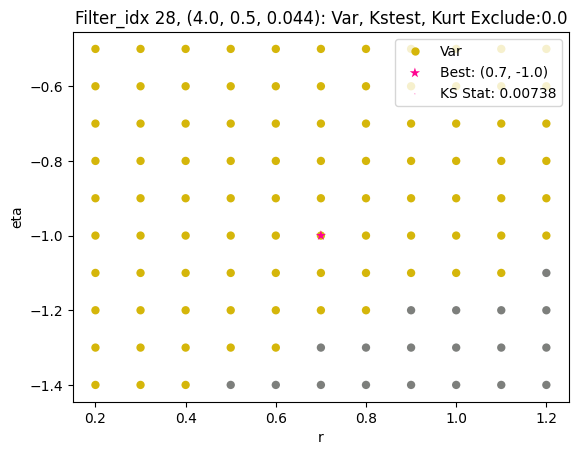

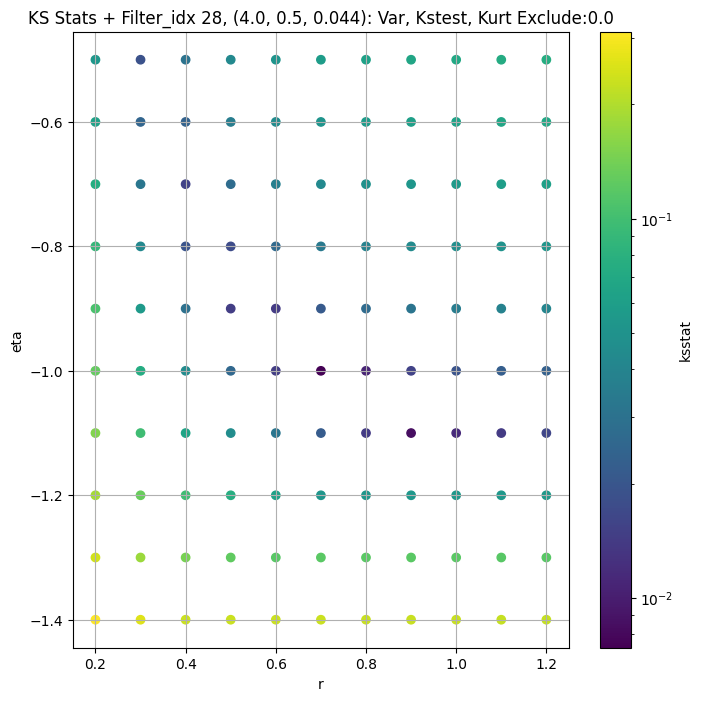

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.0073876053190579105 15727.403


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.007998466230970114 14869.8125


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.008417046105602621 14350.221


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.008208904055861166 13547.274
Number of samples: 100000, Without approximation : 65536000.0


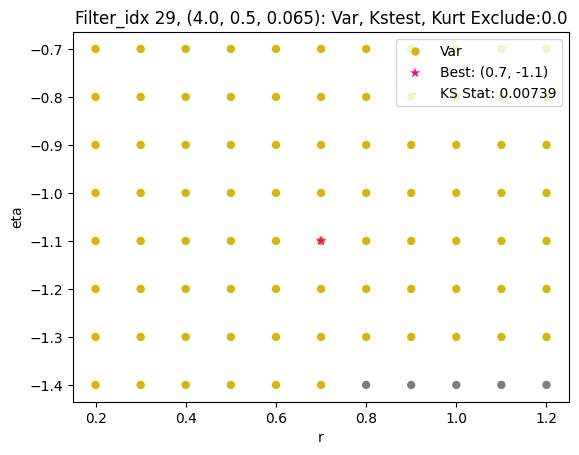

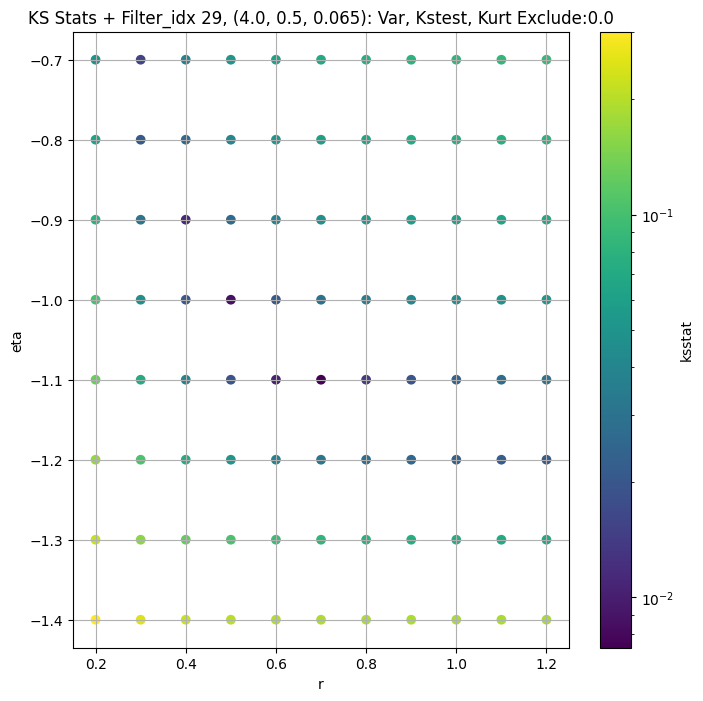

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.01013973494479592 5532.0737


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.011163113139727343 5159.0884


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.011840150746549094 4939.1685


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.013628255513982057 4608.1543
Number of samples: 100000, Without approximation : 65536000.0


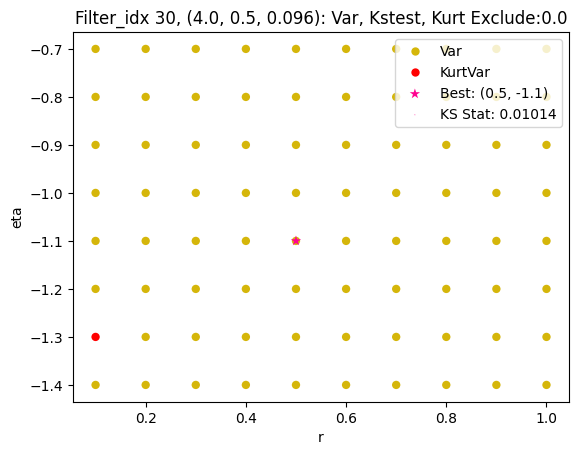

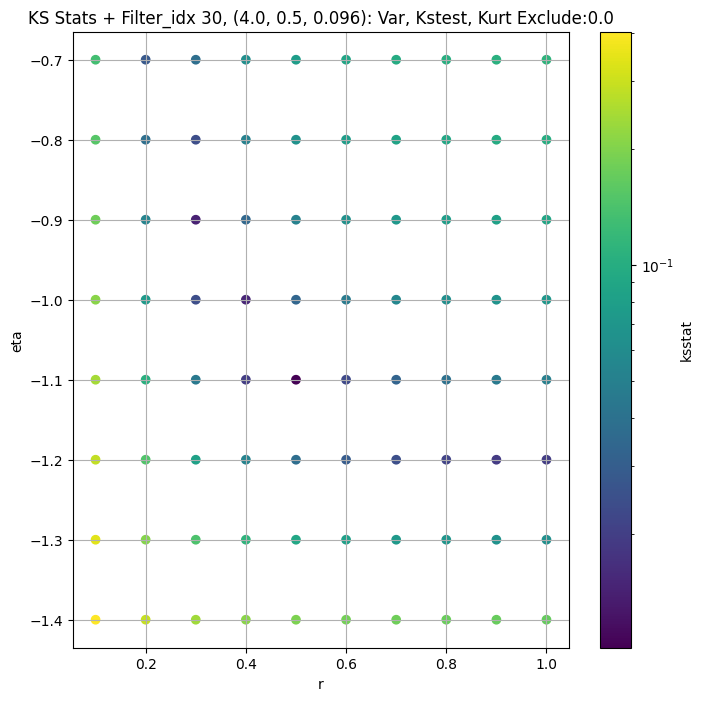

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.01371074760341956 2144.1028


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.011935251726980789 1973.4135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.011933226215629644 1876.5714


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.011021130271421709 1733.7667
Number of samples: 100000, Without approximation : 65536000.0


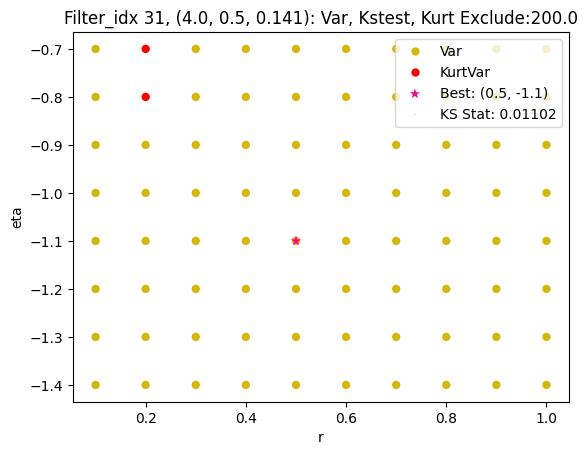

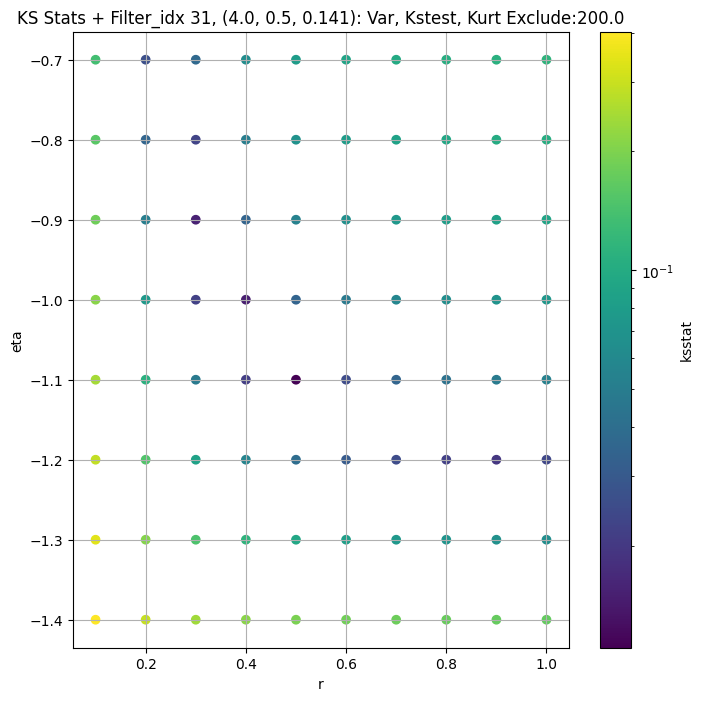

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.009378868236500255 836.75854


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.008816240414076915 751.42926


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.01029357854628099 706.7017


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.012098513050242787 642.9875
Number of samples: 100000, Without approximation : 65536000.0


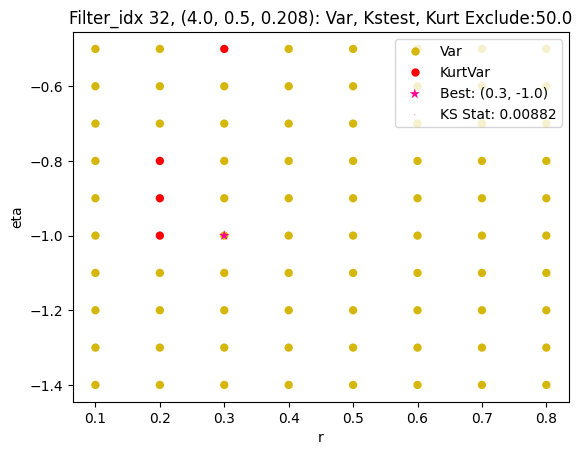

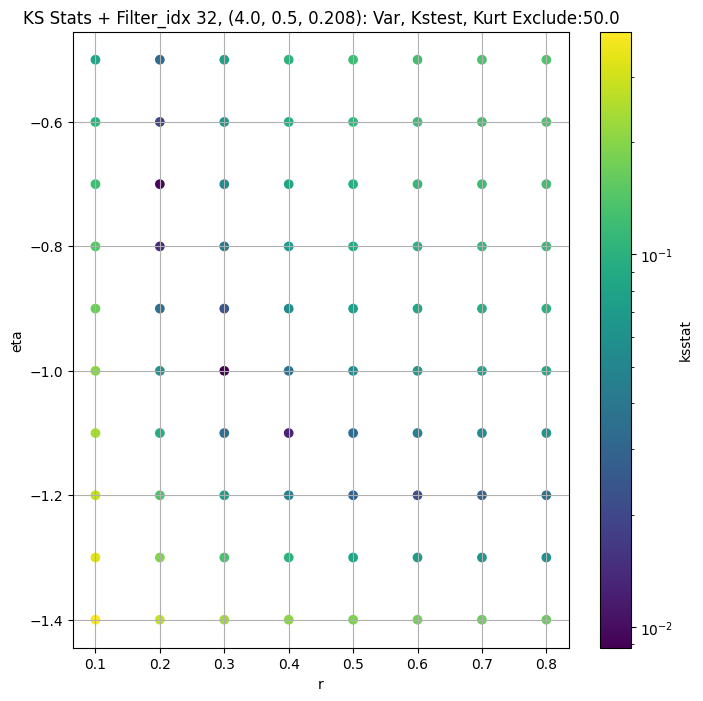

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.005385779470105878 344.8192


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.009018484077987332 306.81058


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.005848150939904206 286.96216


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.008001121487092033 258.706
Number of samples: 100000, Without approximation : 65536000.0


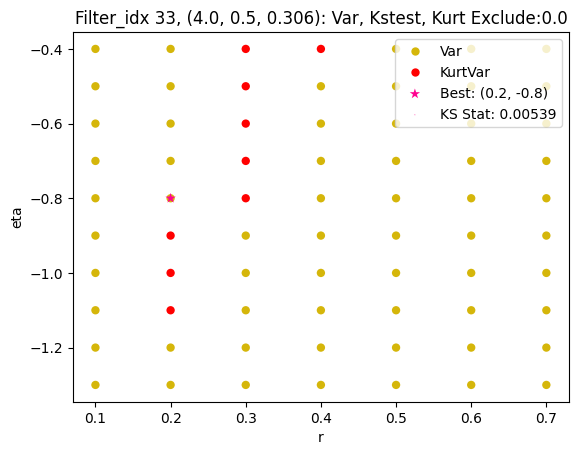

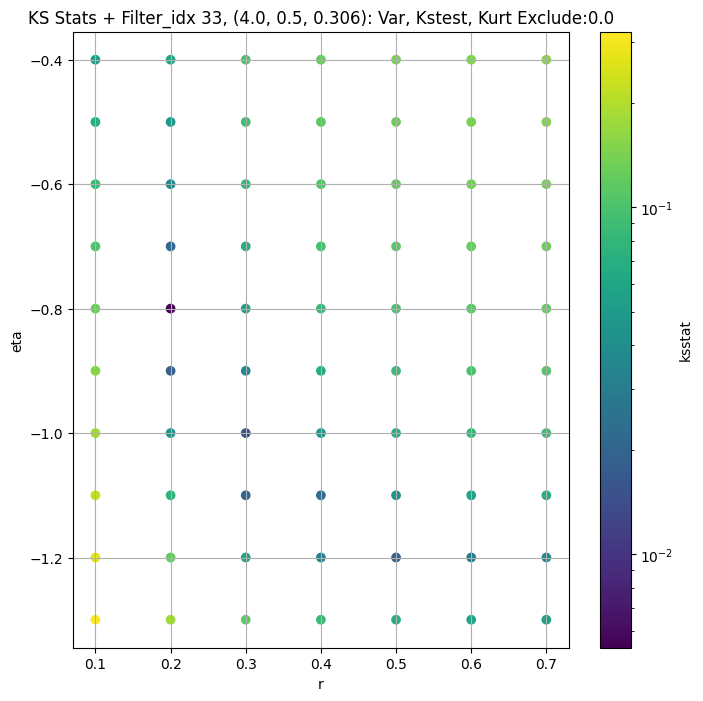

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.014492720353714517 138.96523


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.016725910567836788 122.64658


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.016021189630606503 113.8615


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.013405631389735828 101.086365
Number of samples: 100000, Without approximation : 65536000.0


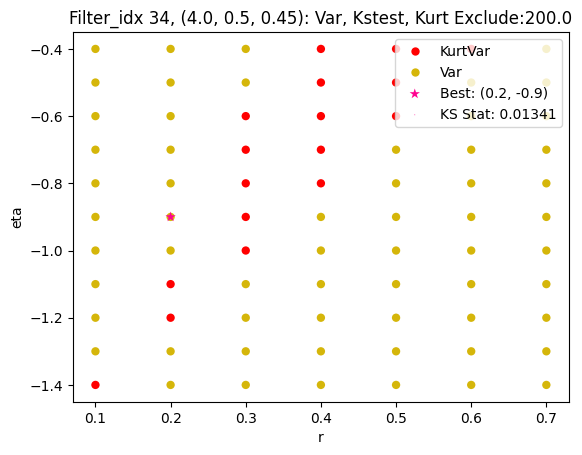

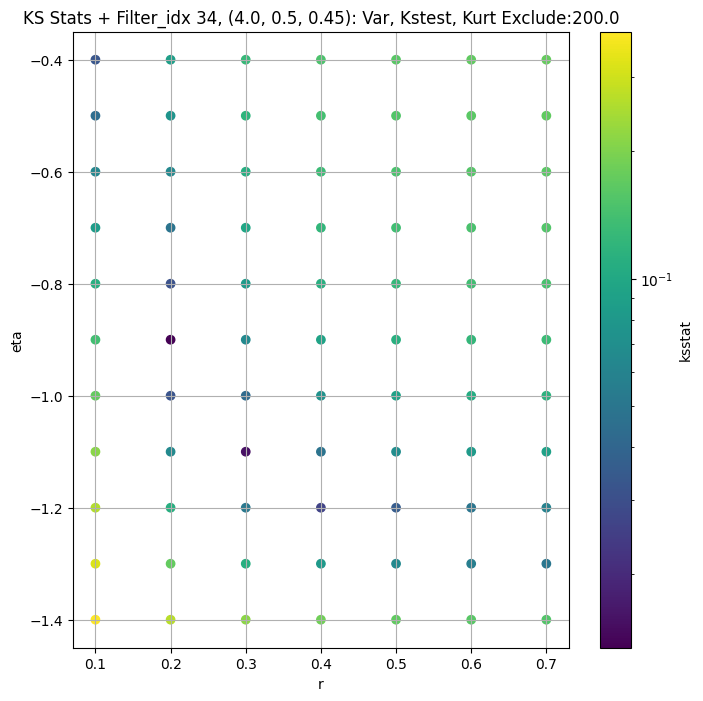

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.005775471570769686 49227.17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.0032972238949350308 46268.543


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.0030571833793734404 44399.97


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.0066589381965271865 41542.78
Number of samples: 100000, Without approximation : 65536000.0


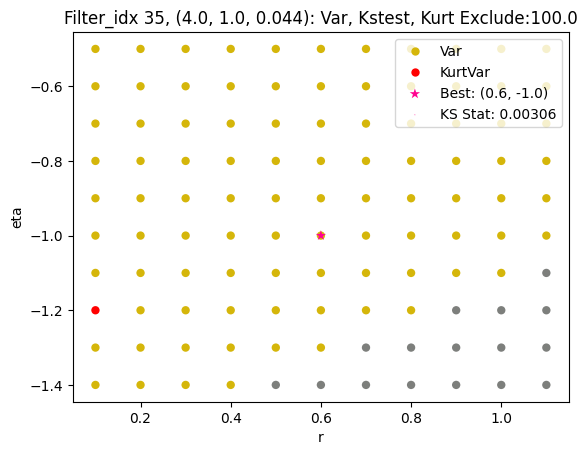

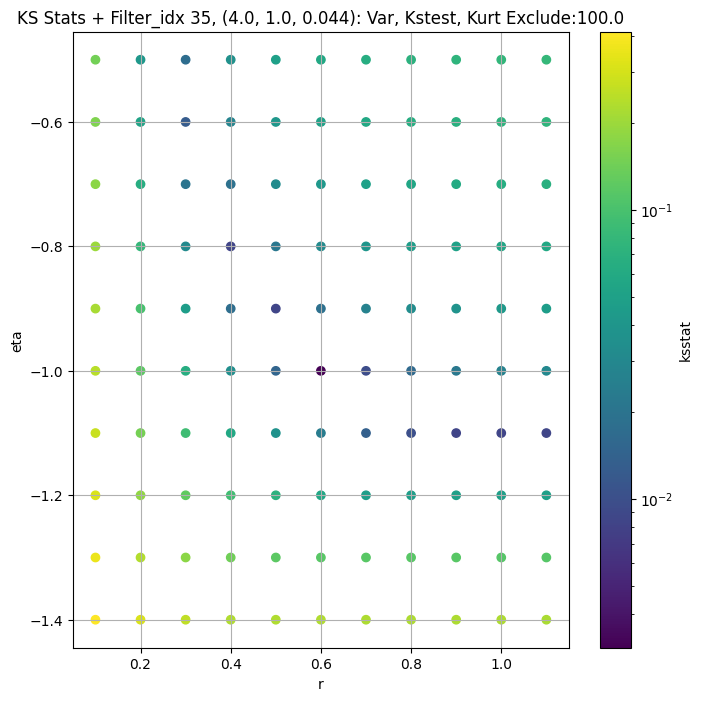

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.0058157818123602545 18242.844


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.007488007829259319 16783.475


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.0100602462335031 15927.687


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.007944682343142717 14666.071
Number of samples: 100000, Without approximation : 65536000.0


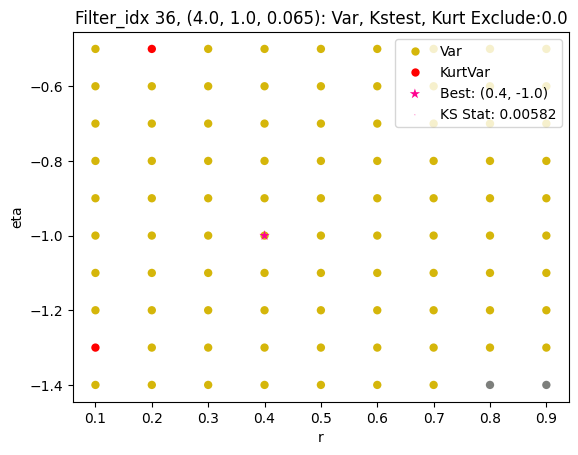

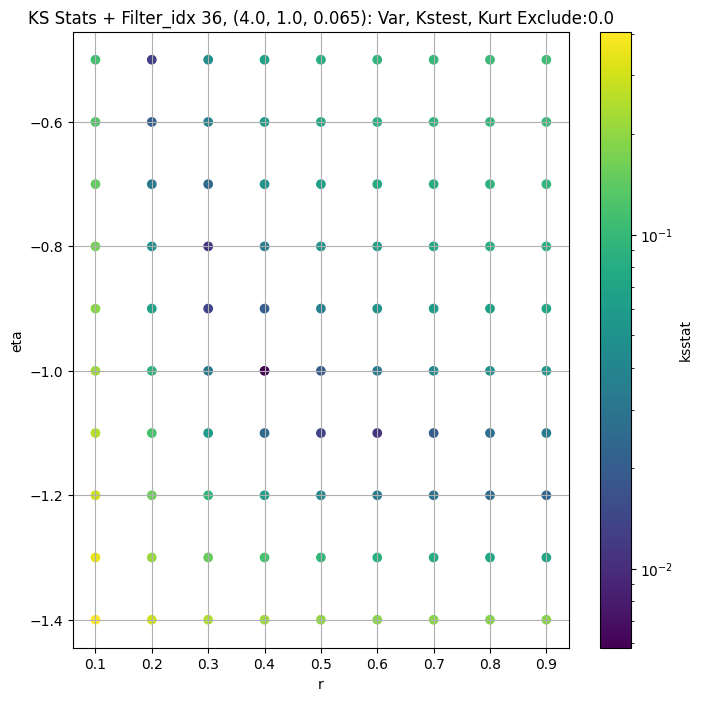

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.011016284685920197 6475.4277


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.0067146200732297046 5909.2065


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.009379992653498759 5569.9897


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.007864240746385587 5072.679
Number of samples: 100000, Without approximation : 65536000.0


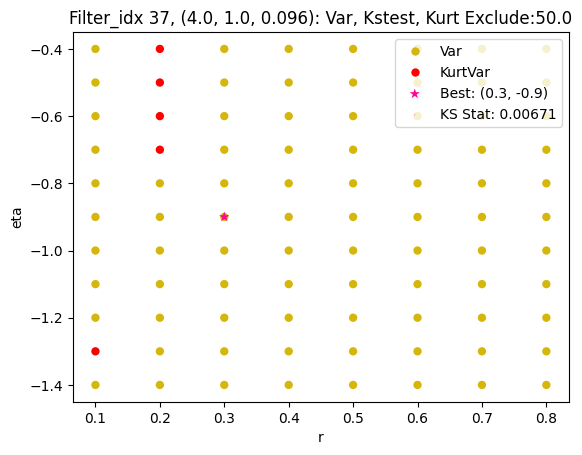

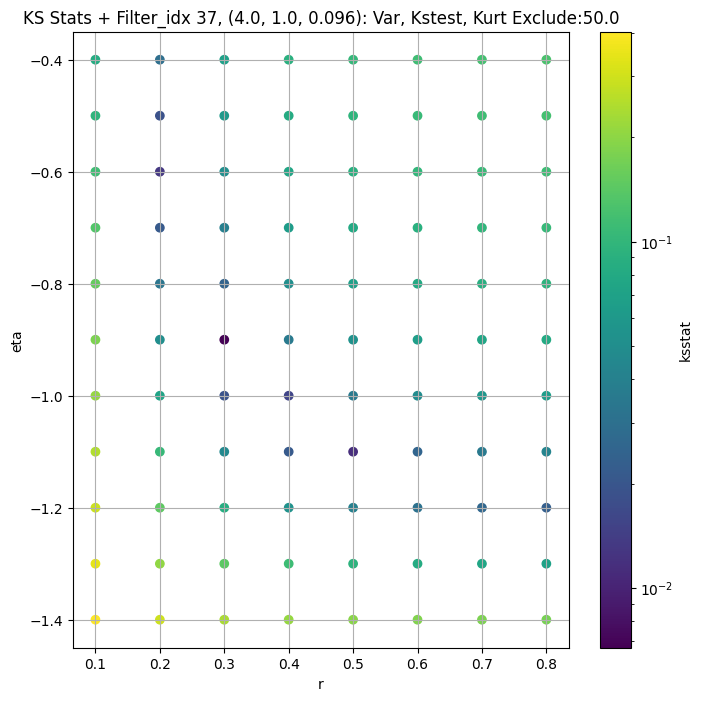

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.010490729477537791 2418.4358


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.007781489693872379 2161.5662


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.010926651062655446 2007.8282


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.012032767685122625 1791.3143
Number of samples: 100000, Without approximation : 65536000.0


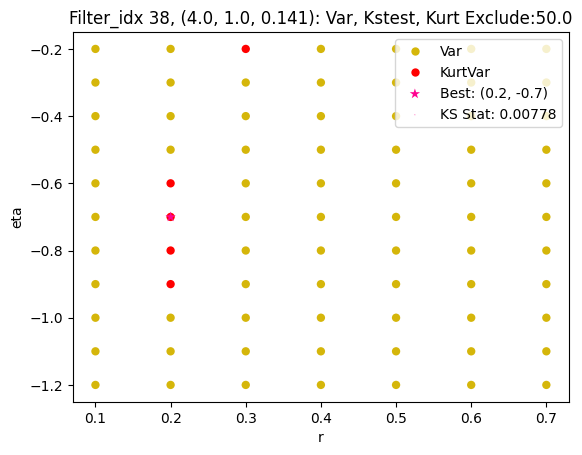

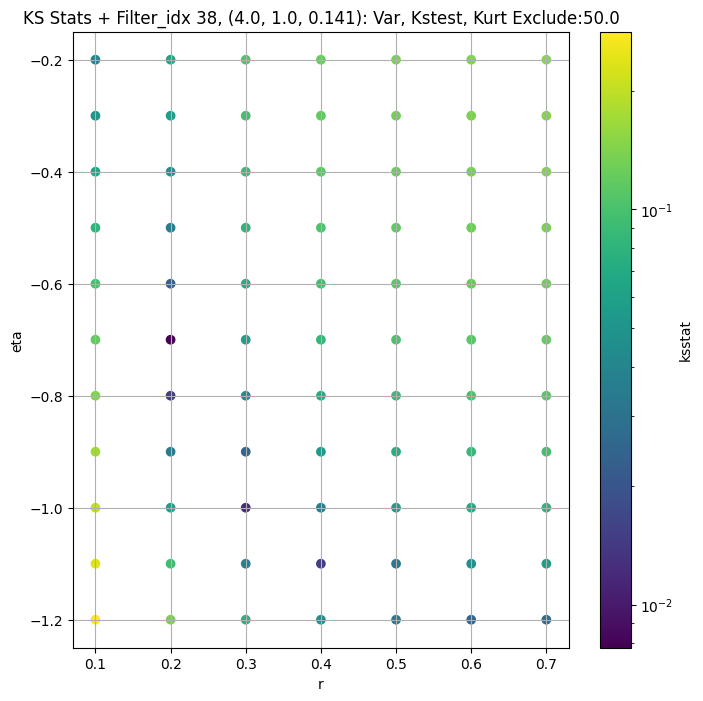

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.005296814080301804 964.7728


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.00763119548989033 825.4808


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.008907036987548578 757.7803


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.00803060058993188 664.5869
Number of samples: 100000, Without approximation : 65536000.0


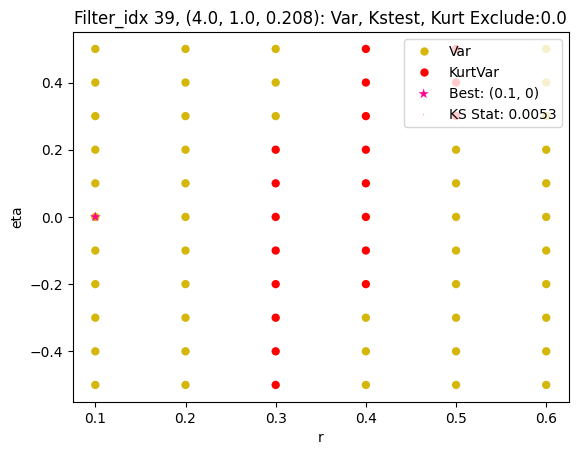

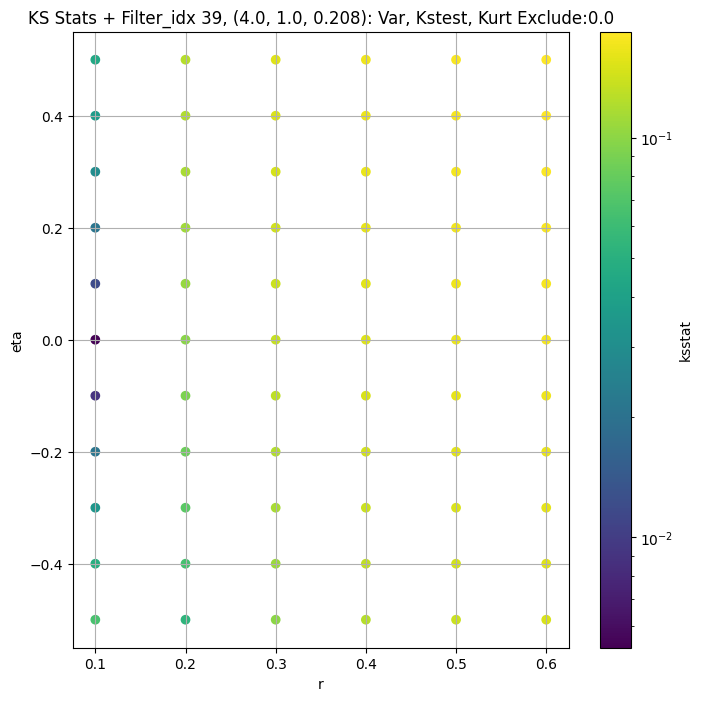

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.004761832974008132 374.26288


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.003944018539249888 313.11636


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.004941587482618193 284.51688


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.005230872933957076 246.72136
Number of samples: 100000, Without approximation : 65536000.0


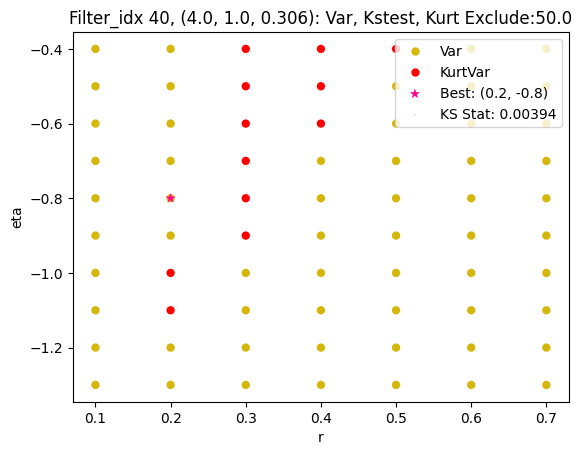

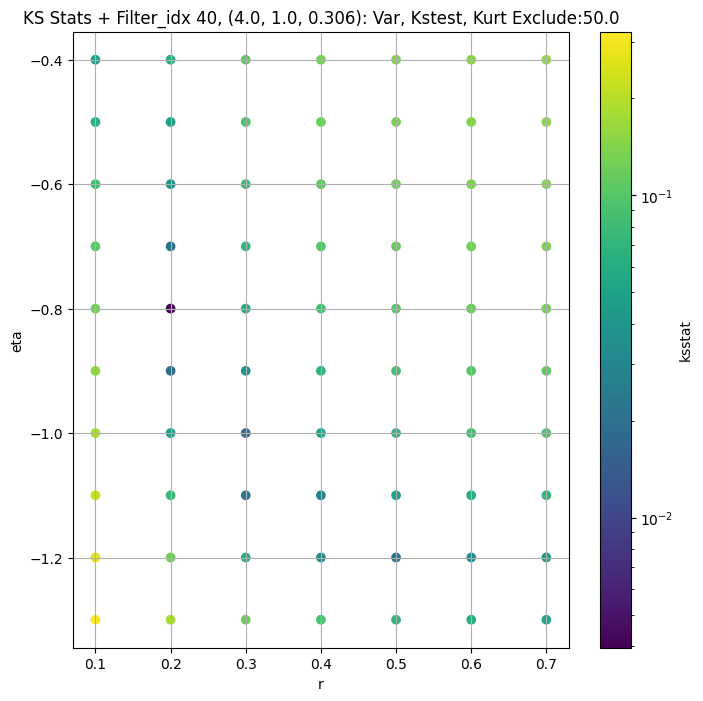

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.009889836153159498 161.1464


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.012506306612715616 130.22737


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.015665786576862906 115.95443


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.011047866220292801 98.385925
Number of samples: 100000, Without approximation : 65536000.0


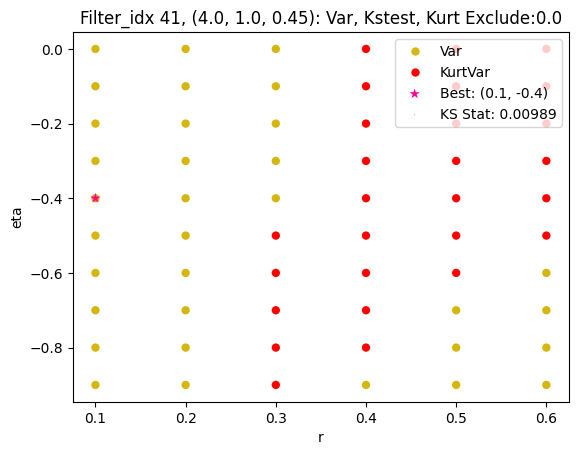

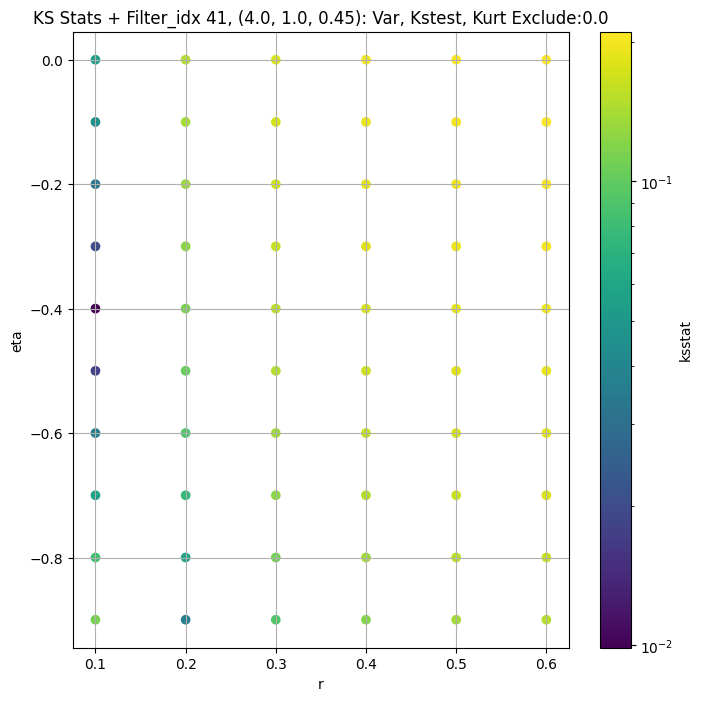

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",49240.44000,38882.65000,60244.74600,4.773906,2.801561,11.781327,65536000.0,"(2.0, 0.5, 0.044)",0.010135,0.8,-1.0,6.988049e+04,100.0,46445.723000,0.000168
1,"(2.0, 0.5, 0.065)",17537.88500,13703.03100,22308.49800,6.268736,3.636876,14.473557,65536000.0,"(2.0, 0.5, 0.065)",0.006708,0.8,-1.1,3.248583e+04,50.0,16844.732000,0.000168
2,"(2.0, 0.5, 0.096)",6263.64750,4817.59230,8065.39060,8.682725,4.491842,22.594627,65536000.0,"(2.0, 0.5, 0.096)",0.007730,0.6,-1.1,6.773260e+03,50.0,5955.544400,0.000168
3,"(2.0, 0.5, 0.141)",2366.95400,1740.60230,3189.22300,11.592262,5.991223,32.245300,65536000.0,"(2.0, 0.5, 0.141)",0.008108,0.5,-1.1,1.546723e+03,50.0,2227.281700,0.000168
4,"(2.0, 0.5, 0.208)",947.27313,670.49140,1259.57480,13.660814,7.580907,37.590374,65536000.0,"(2.0, 0.5, 0.208)",0.009855,0.3,-0.9,2.204424e+01,50.0,884.612370,0.000168
5,"(2.0, 0.5, 0.306)",332.07900,220.95845,459.92392,18.274677,8.888781,51.722927,65536000.0,"(2.0, 0.5, 0.306)",0.008180,0.3,-1.0,1.089171e+01,100.0,289.562320,0.000168
6,"(2.0, 0.5, 0.45)",206.10092,141.26283,293.74957,18.116974,9.422618,55.211193,65536000.0,"(2.0, 0.5, 0.45)",0.010424,0.4,-1.1,4.951585e+01,200.0,164.558530,0.000168
7,"(2.0, 1.0, 0.044)",69678.76000,56125.30500,86983.69000,5.744799,3.133826,17.976940,65536000.0,"(2.0, 1.0, 0.044)",0.006721,0.8,-1.0,1.000000e+05,0.0,69678.760000,0.000168
8,"(2.0, 1.0, 0.065)",24894.46500,19084.35500,32298.96900,8.052679,3.912416,27.094390,65536000.0,"(2.0, 1.0, 0.065)",0.004756,1.2,-1.1,6.258475e+04,200.0,21673.168000,0.000168


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 100.0 + 100 = 200, ksstat: 0.009773337851117891, var: 44603.15234375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 100.0 + 75 = 175, ksstat: 0.009205058492077325, var: 45031.9375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 100.0 + 50 = 150, ksstat: 0.008619870551811681, var: 45480.17578125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 100.0 + 25 = 125, ksstat: 0.00897456440813954, var: 45949.03125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 100.0 + 0 = 100, ksstat: 0.008903690379106544, var: 46445.72265625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 100.0 + -25 = 75, ksstat: 0.008627842454052903, var: 46980.6796875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 100.0 + -50 = 50, ksstat: 0.007935373564660217, var: 47567.01953125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 100.0 + -75 = 25, ksstat: 0.007586082920243542, var: 48238.171875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 100.0 + -100 = 0, ksstat: 0.006353637863748901, var: 49240.44140625
Number of samples: 100000, Without approximation : 65536000.0


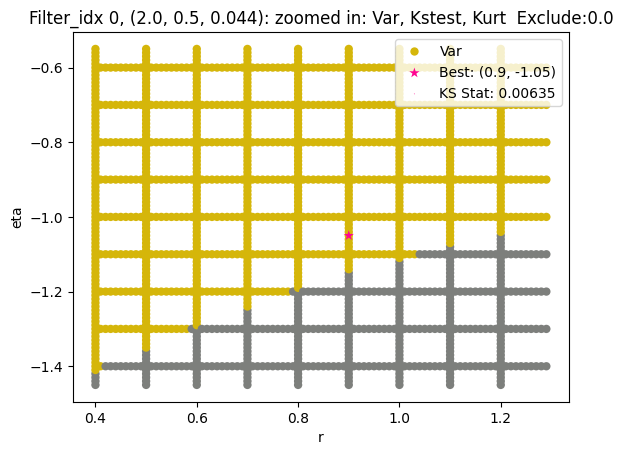

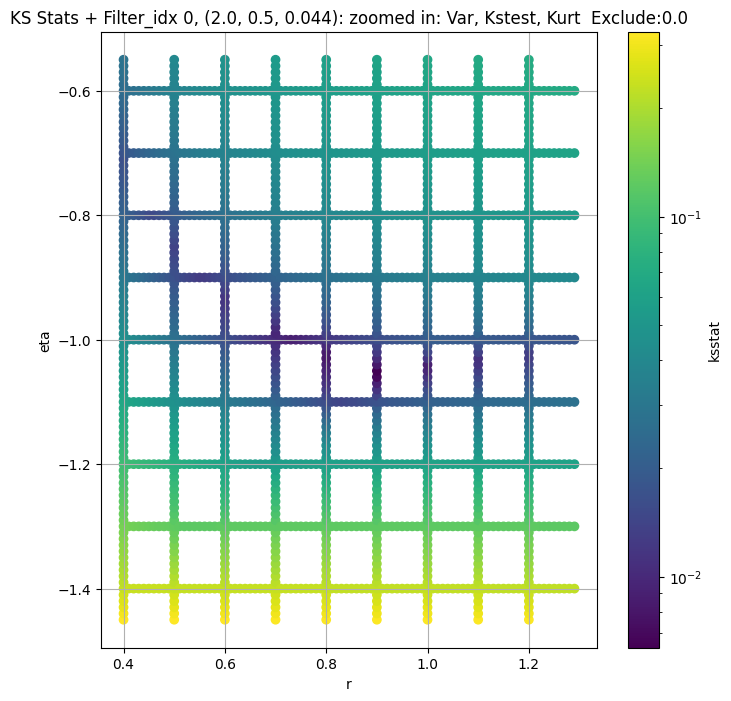

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 50.0 + 100 = 150, ksstat: 0.006836249867394062, var: 15986.7431640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 50.0 + 75 = 125, ksstat: 0.007043072282810869, var: 16178.5791015625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 50.0 + 50 = 100, ksstat: 0.006748505576762098, var: 16382.7216796875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 50.0 + 25 = 75, ksstat: 0.0067239385770735405, var: 16602.69140625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 50.0 + 0 = 50, ksstat: 0.006449756177985391, var: 16844.732421875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 50.0 + -25 = 25, ksstat: 0.006112895910006189, var: 17123.1640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 1, 50.0 + -50 = 0, ksstat: 0.005706512750005055, var: 17537.884765625
Number of samples: 100000, Without approximation : 65536000.0


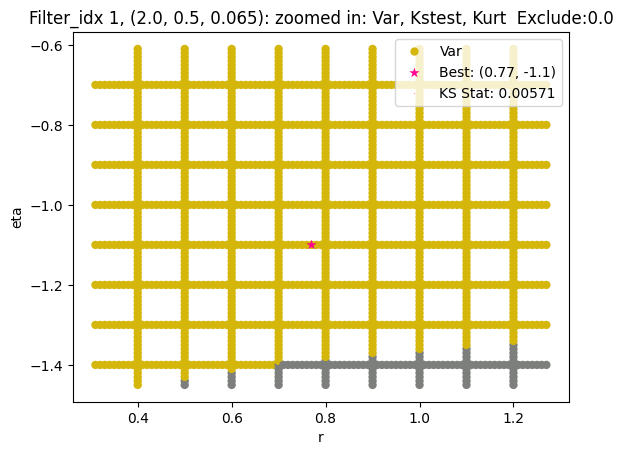

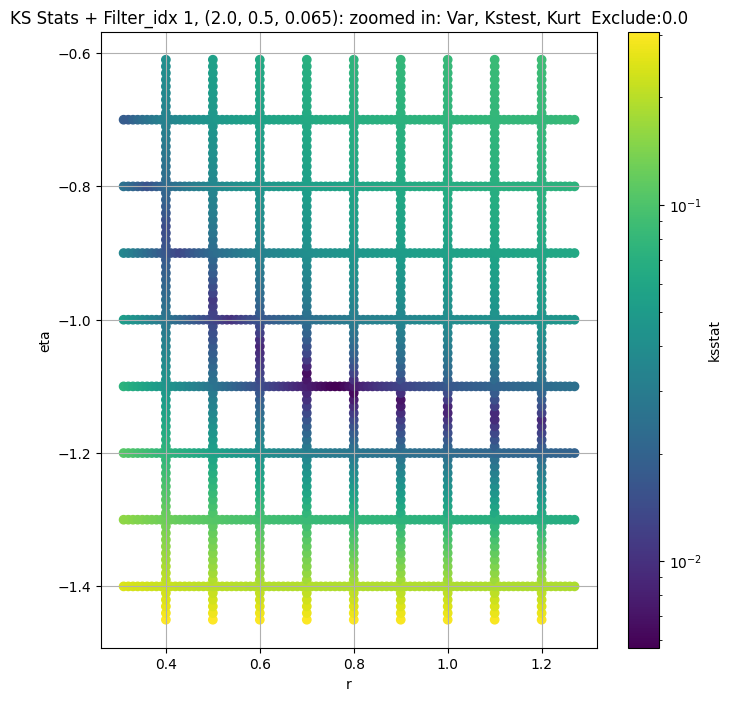

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 100 = 150, ksstat: 0.00839293258491458, var: 5588.67431640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 75 = 125, ksstat: 0.008137601927153737, var: 5669.72705078125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 50 = 100, ksstat: 0.007872396046781152, var: 5756.74560546875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 25 = 75, ksstat: 0.0075900155518346946, var: 5851.228515625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + 0 = 50, ksstat: 0.007467383940079453, var: 5955.54443359375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + -25 = 25, ksstat: 0.007471321320558277, var: 6077.48095703125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 50.0 + -50 = 0, ksstat: 0.007655723249856028, var: 6263.6474609375
Number of samples: 100000, Without approximation : 65536000.0


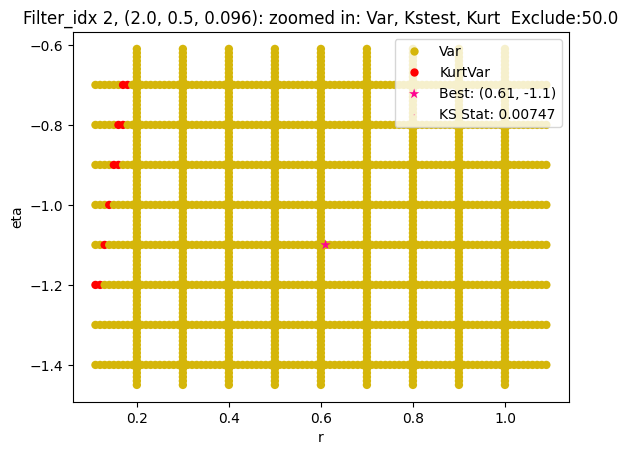

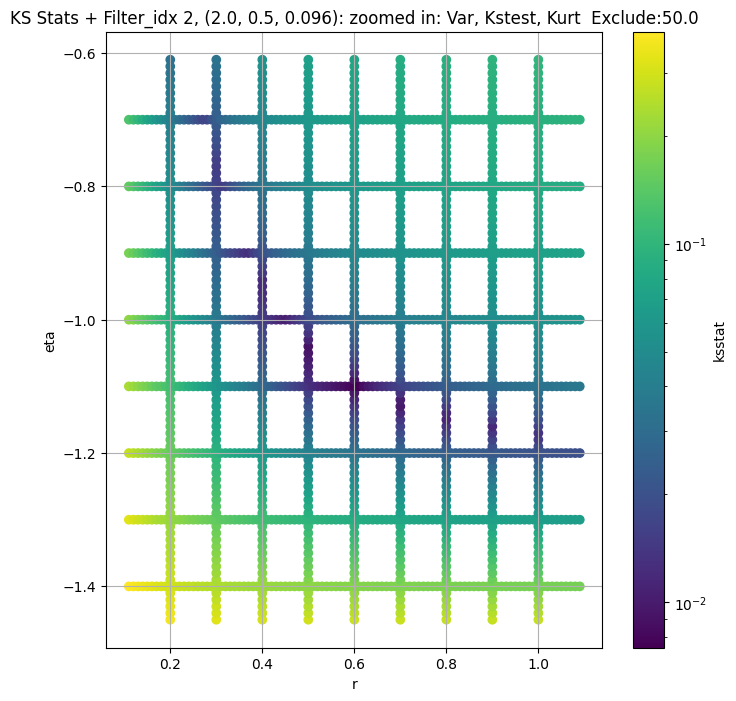

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 50.0 + 100 = 150, ksstat: 0.008320195124264407, var: 2063.212646484375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 50.0 + 75 = 125, ksstat: 0.007906163137816336, var: 2098.994140625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 50.0 + 50 = 100, ksstat: 0.008097029209096385, var: 2137.677490234375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 50.0 + 25 = 75, ksstat: 0.00835734701247165, var: 2180.070556640625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 50.0 + 0 = 50, ksstat: 0.008107929581452566, var: 2227.28173828125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 50.0 + -25 = 25, ksstat: 0.008059131768812303, var: 2281.750732421875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 50.0 + -50 = 0, ksstat: 0.007010594748050658, var: 2366.9541015625
Number of samples: 100000, Without approximation : 65536000.0


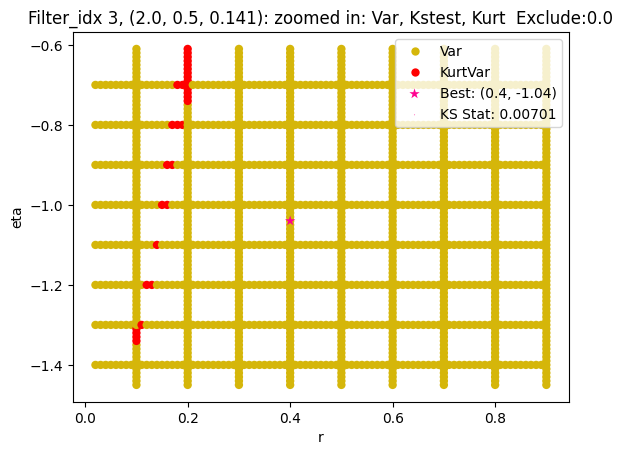

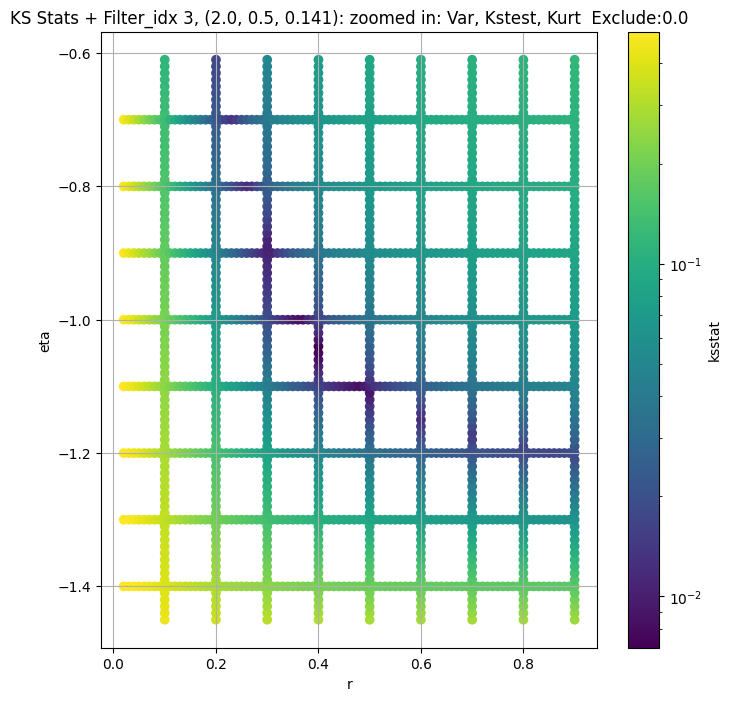

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 50.0 + 100 = 150, ksstat: 0.007990647373126603, var: 813.72412109375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 50.0 + 75 = 125, ksstat: 0.007639196800883652, var: 829.1600341796875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 50.0 + 50 = 100, ksstat: 0.007452862972993524, var: 845.8697509765625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 50.0 + 25 = 75, ksstat: 0.007030260335595402, var: 864.070556640625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 50.0 + 0 = 50, ksstat: 0.006268607572286422, var: 884.6123657226562


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 50.0 + -25 = 25, ksstat: 0.007200092404103332, var: 909.1575317382812


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 50.0 + -50 = 0, ksstat: 0.006581437627530606, var: 947.2731323242188
Number of samples: 100000, Without approximation : 65536000.0


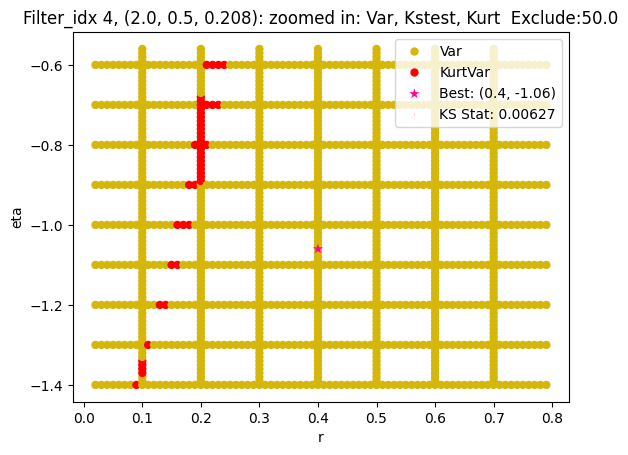

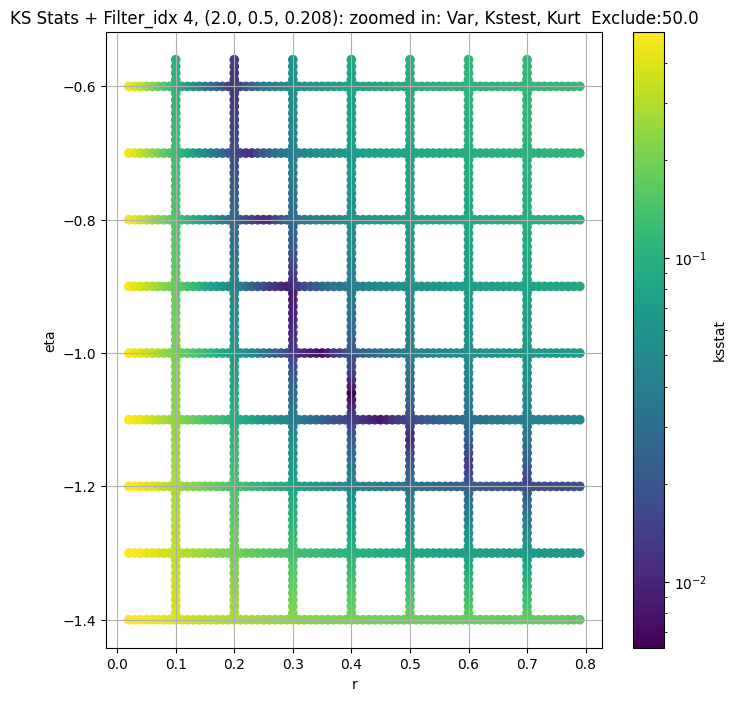

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 100.0 + 100 = 200, ksstat: 0.008175258353504078, var: 264.2860107421875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 100.0 + 75 = 175, ksstat: 0.008180650906935427, var: 269.9313659667969


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 100.0 + 50 = 150, ksstat: 0.008173164549305945, var: 275.9718017578125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 100.0 + 25 = 125, ksstat: 0.008177098649607473, var: 282.47601318359375


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 100.0 + 0 = 100, ksstat: 0.008177503716218948, var: 289.56231689453125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 100.0 + -25 = 75, ksstat: 0.008177807902577106, var: 297.3992919921875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 100.0 + -50 = 50, ksstat: 0.008173863203805476, var: 306.24493408203125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 100.0 + -75 = 25, ksstat: 0.008174450799343369, var: 316.4530029296875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 100.0 + -100 = 0, ksstat: 0.00817529722311866, var: 332.0790100097656
Number of samples: 100000, Without approximation : 65536000.0


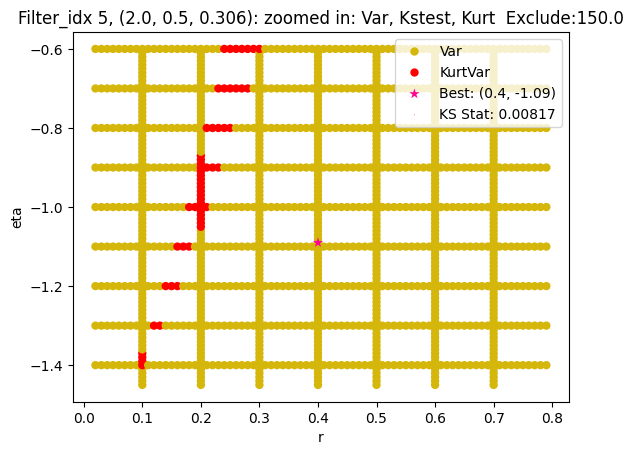

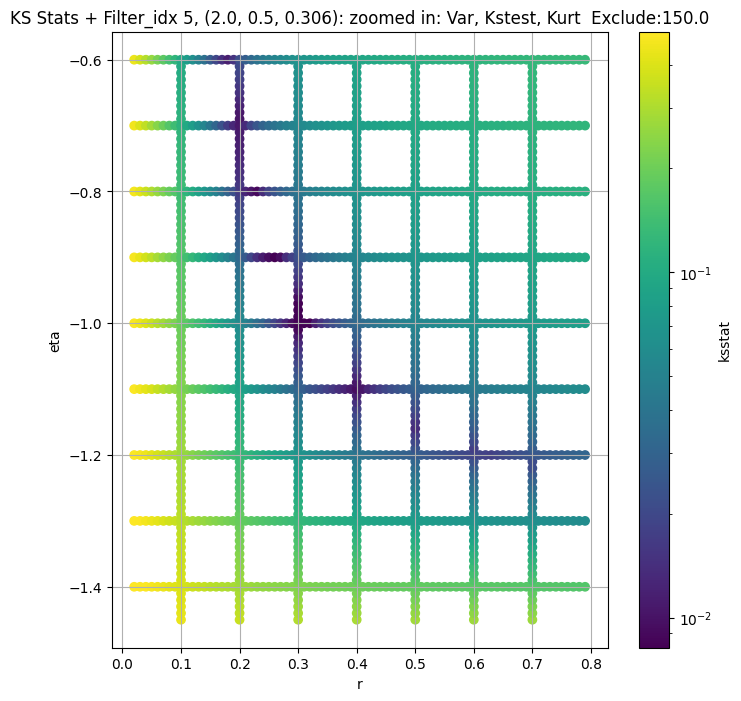

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 200.0 + 100 = 300, ksstat: 0.010413453581003651, var: 152.4326629638672


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 200.0 + 75 = 275, ksstat: 0.010413875958366625, var: 155.2373046875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 200.0 + 50 = 250, ksstat: 0.01041430731055848, var: 158.18218994140625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 200.0 + 25 = 225, ksstat: 0.010414748608497115, var: 161.2825469970703


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 200.0 + 0 = 200, ksstat: 0.01042416137150648, var: 164.55853271484375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 200.0 + -25 = 175, ksstat: 0.010424534460159118, var: 168.0389862060547


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 200.0 + -50 = 150, ksstat: 0.010412524262425948, var: 171.7593536376953


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 200.0 + -75 = 125, ksstat: 0.010413068390272617, var: 175.7653350830078


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 200.0 + -100 = 100, ksstat: 0.010427381841887406, var: 180.11929321289062
Number of samples: 100000, Without approximation : 65536000.0


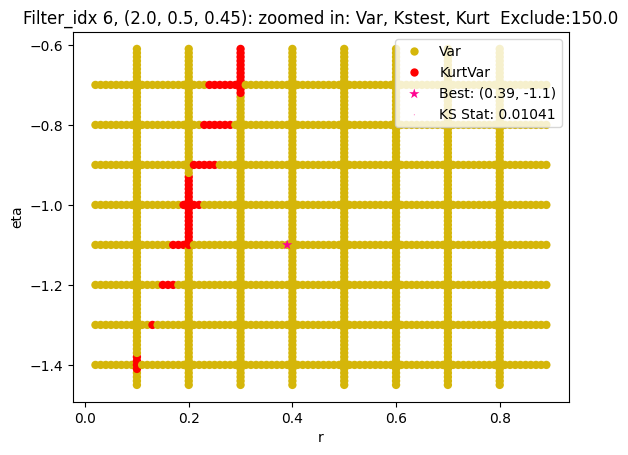

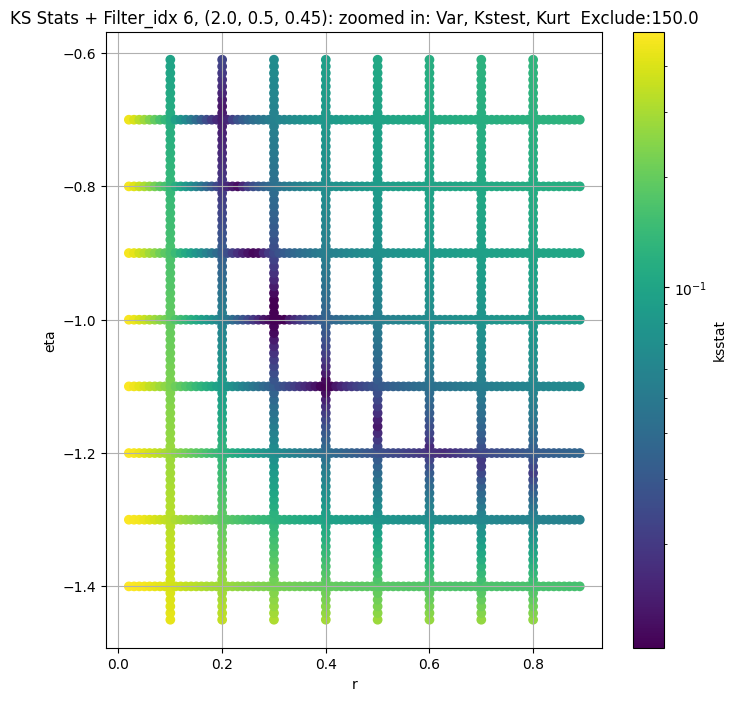

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 7, 0.0 + 100 = 100, ksstat: 0.005564030308770618, var: 65056.14453125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 7, 0.0 + 75 = 75, ksstat: 0.005055740243205875, var: 65929.1640625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 7, 0.0 + 50 = 50, ksstat: 0.004505051164493373, var: 66897.5390625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 7, 0.0 + 25 = 25, ksstat: 0.003916461205386967, var: 68023.5234375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 7, 0.0 + 0 = 0, ksstat: 0.003916461205386967, var: 69678.7578125
Number of samples: 100000, Without approximation : 65536000.0


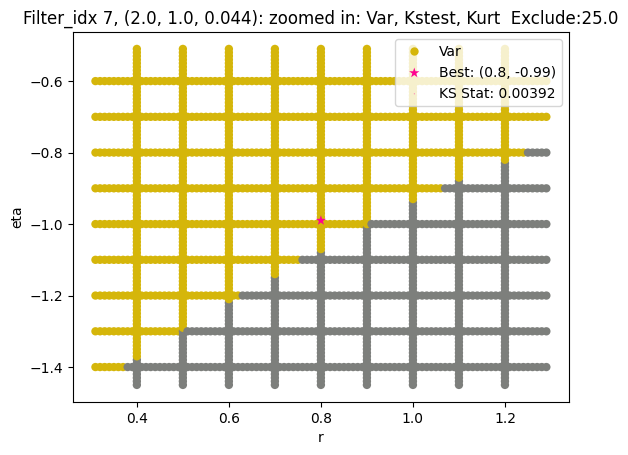

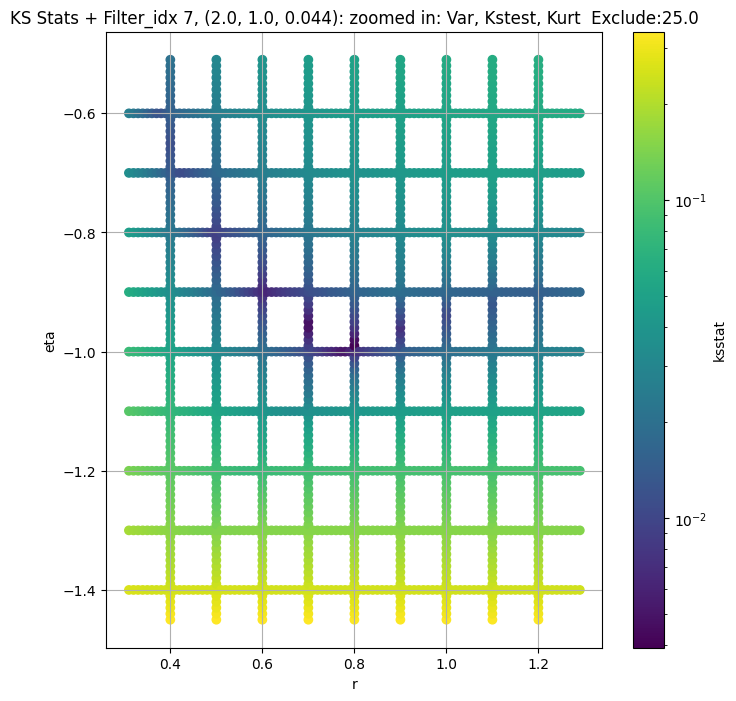

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 100 = 300, ksstat: 0.005860165190267108, var: 20716.4296875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 75 = 275, ksstat: 0.005656425899312836, var: 20940.07421875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 50 = 250, ksstat: 0.005345902960984805, var: 21173.0625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 25 = 225, ksstat: 0.005099957699866563, var: 21416.888671875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 0 = 200, ksstat: 0.004756229529365247, var: 21673.16796875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + -25 = 175, ksstat: 0.004420643562902726, var: 21943.86328125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + -50 = 150, ksstat: 0.004280404431923297, var: 22231.615234375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + -75 = 125, ksstat: 0.0040751898268749365, var: 22540.134765625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + -100 = 100, ksstat: 0.00371976883556413, var: 22874.41015625
Number of samples: 100000, Without approximation : 65536000.0


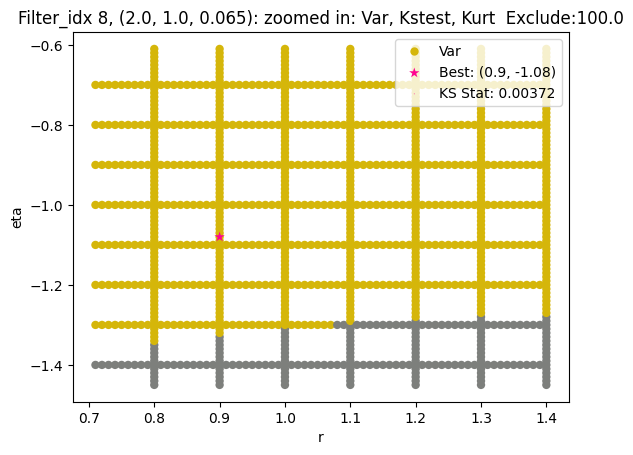

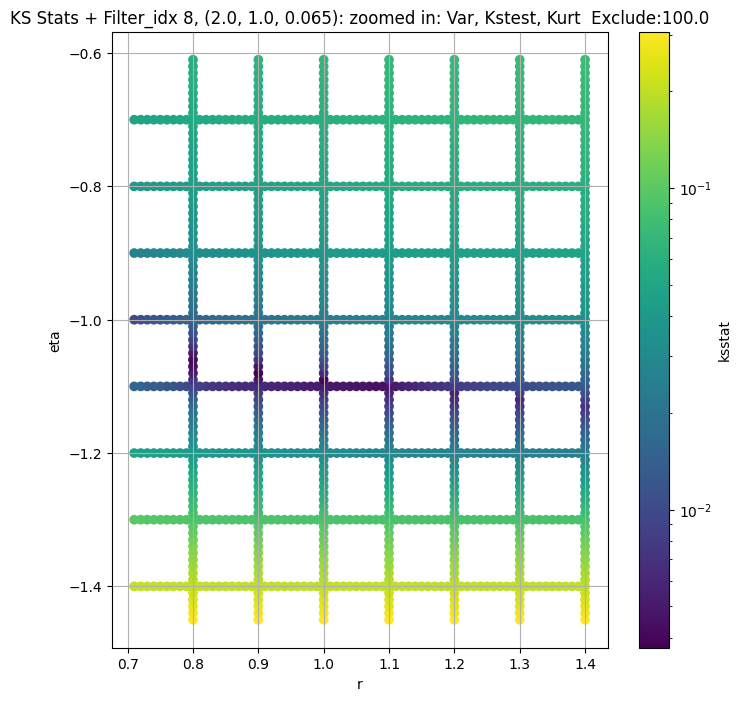

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 100 = 200, ksstat: 0.005756833919480342, var: 7812.06640625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 75 = 175, ksstat: 0.005532104748020905, var: 7924.9091796875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 50 = 150, ksstat: 0.005585211237149723, var: 8045.10888671875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 25 = 125, ksstat: 0.005635767257852642, var: 8174.31982421875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + 0 = 100, ksstat: 0.0052394217918162456, var: 8314.7470703125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + -25 = 75, ksstat: 0.0051890537538078485, var: 8469.345703125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + -50 = 50, ksstat: 0.004953367690609944, var: 8643.8076171875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + -75 = 25, ksstat: 0.005071031342324173, var: 8848.6025390625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 9, 100.0 + -100 = 0, ksstat: 0.004593988155711548, var: 9170.1787109375
Number of samples: 100000, Without approximation : 65536000.0


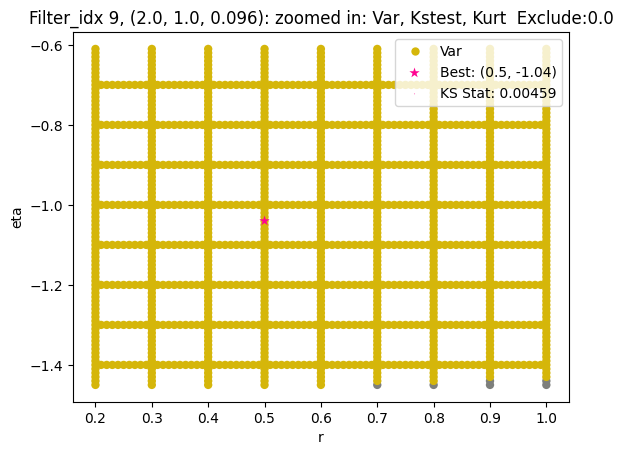

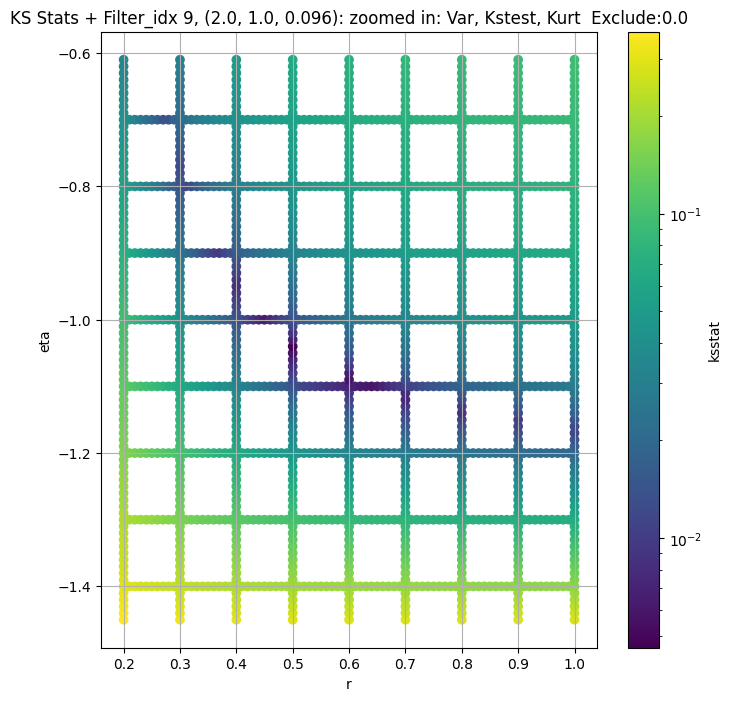

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 100 = 100, ksstat: 0.00584274836786236, var: 3043.15234375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 75 = 75, ksstat: 0.005896631793981755, var: 3109.016845703125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 50 = 50, ksstat: 0.005586709899111808, var: 3183.923828125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 25 = 25, ksstat: 0.005895362757788472, var: 3272.827392578125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 0 = 0, ksstat: 0.004505158524183497, var: 3411.785888671875
Number of samples: 100000, Without approximation : 65536000.0


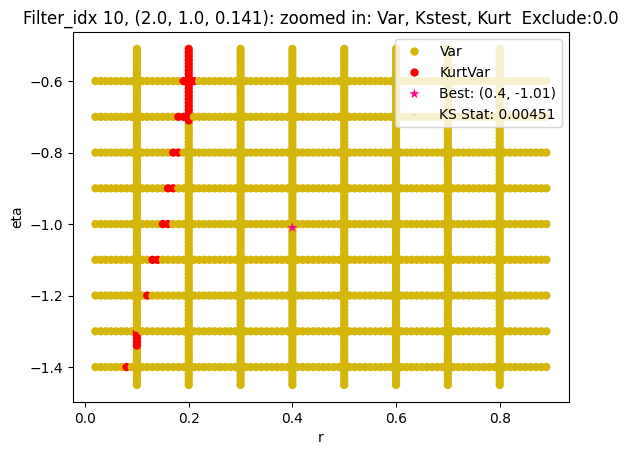

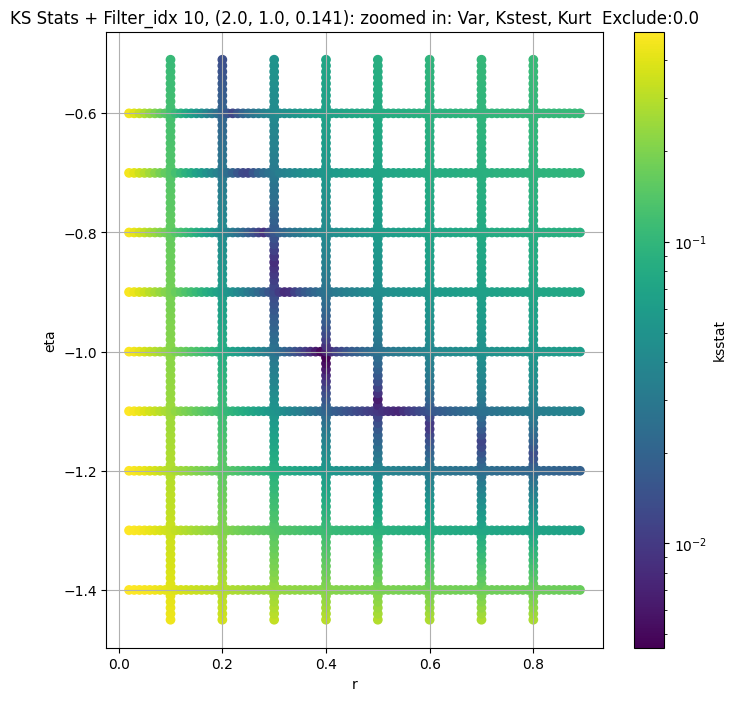

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 100 = 100, ksstat: 0.0052913453024476045, var: 1081.3072509765625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 75 = 75, ksstat: 0.004717547016193757, var: 1108.33837890625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 50 = 50, ksstat: 0.004756858619822002, var: 1139.0726318359375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 25 = 25, ksstat: 0.004085226761743832, var: 1176.5576171875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 0 = 0, ksstat: 0.0037614624252953477, var: 1237.600830078125
Number of samples: 100000, Without approximation : 65536000.0


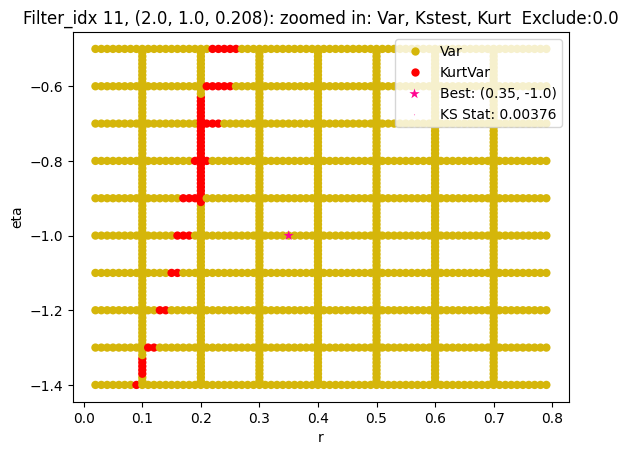

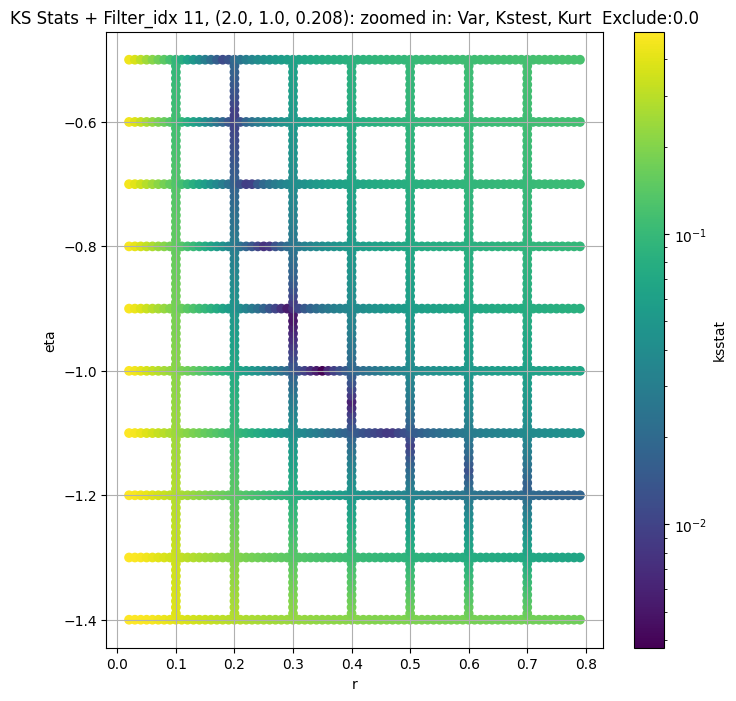

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.0055557541179254155, var: 407.3683776855469


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.00545365884400828, var: 419.09088134765625


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.0054540767910764565, var: 432.7137451171875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.005457933335218157, var: 449.43963623046875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.005453763097089892, var: 476.7568359375
Number of samples: 100000, Without approximation : 65536000.0


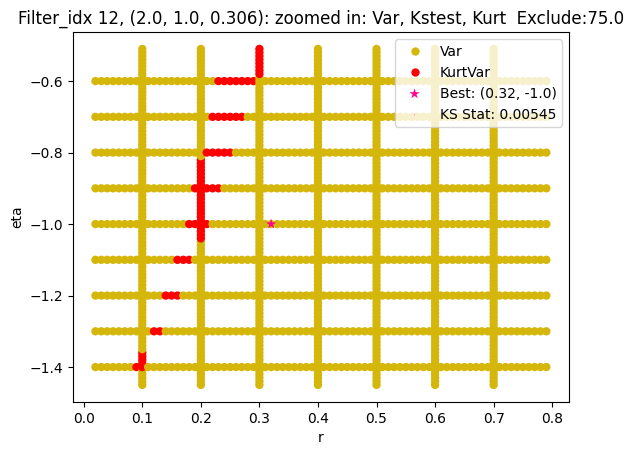

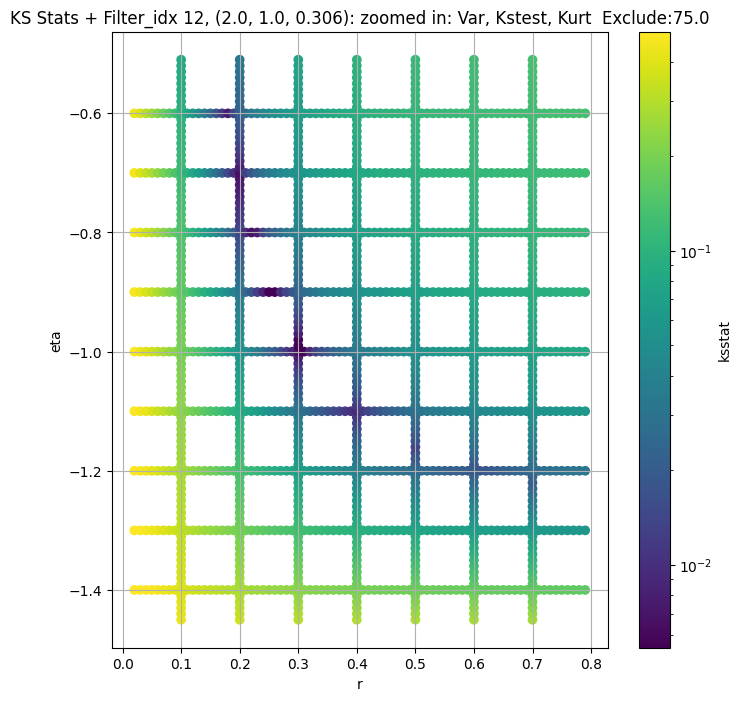

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 100 = 300, ksstat: 0.009514613572776276, var: 149.3632049560547


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 75 = 275, ksstat: 0.009515318261431371, var: 152.63565063476562


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 50 = 250, ksstat: 0.009516040078293653, var: 156.10040283203125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 25 = 225, ksstat: 0.00951678131673439, var: 159.78260803222656


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 0 = 200, ksstat: 0.009531339054206556, var: 163.7144317626953


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + -25 = 175, ksstat: 0.009513235833319922, var: 167.93630981445312


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + -50 = 150, ksstat: 0.00951412493787962, var: 172.50038146972656


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + -75 = 125, ksstat: 0.009512188111218012, var: 177.4874725341797


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + -100 = 100, ksstat: 0.009513215918180329, var: 182.99290466308594
Number of samples: 100000, Without approximation : 65536000.0


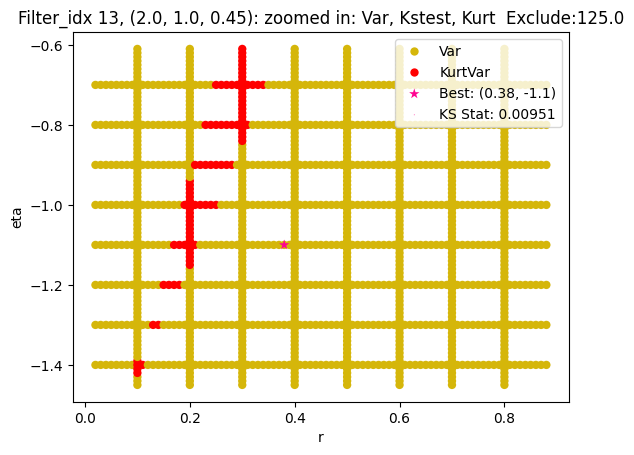

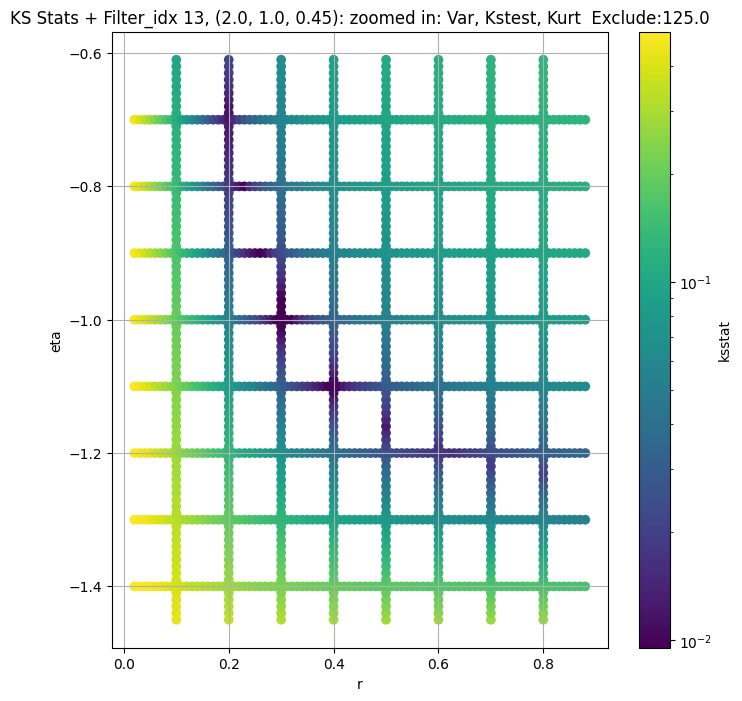

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.006220506202793574, var: 43158.1328125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.005809571188479801, var: 43736.73828125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.005145152572854396, var: 44380.5390625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.00528863208771968, var: 45129.765625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.004438416094378138, var: 46275.8125
Number of samples: 100000, Without approximation : 65536000.0


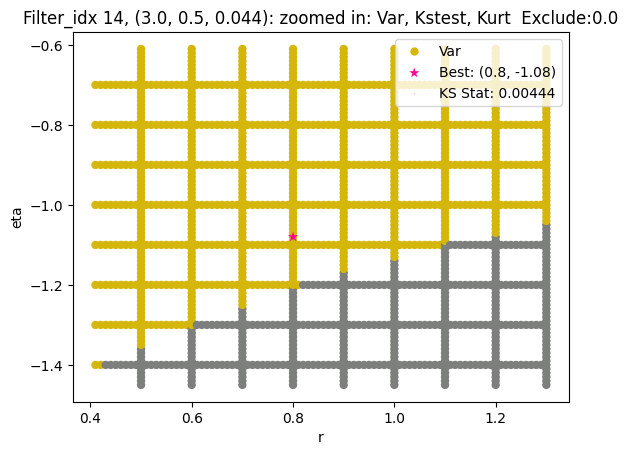

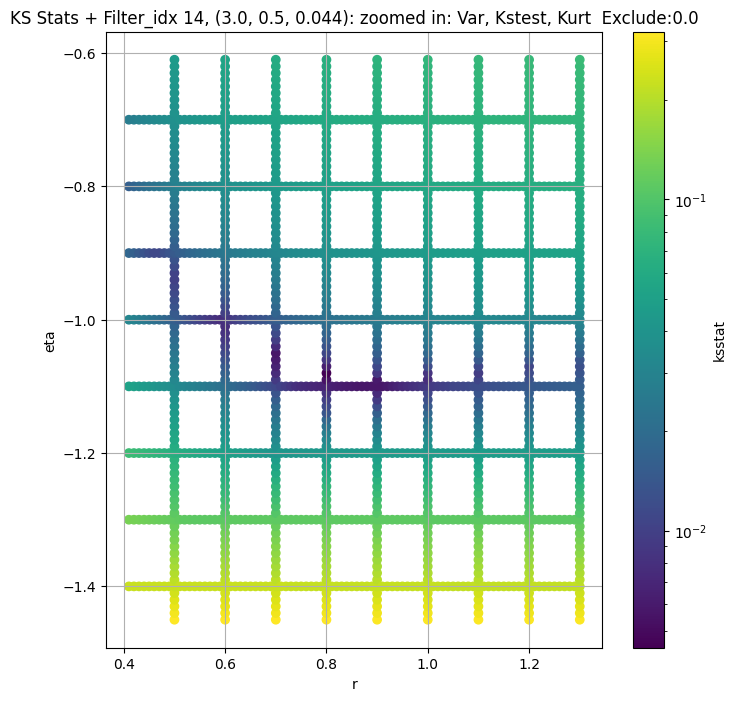

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 100 = 100, ksstat: 0.007038874618301029, var: 14933.1162109375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 75 = 75, ksstat: 0.0070141201659695285, var: 15177.7978515625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 50 = 50, ksstat: 0.00671861376863403, var: 15450.3828125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 25 = 25, ksstat: 0.00695645424192215, var: 15770.4052734375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 0.0 + 0 = 0, ksstat: 0.006901846406680179, var: 16272.880859375
Number of samples: 100000, Without approximation : 65536000.0


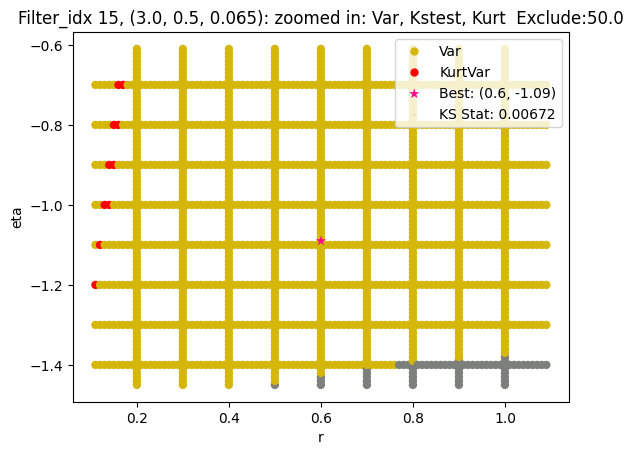

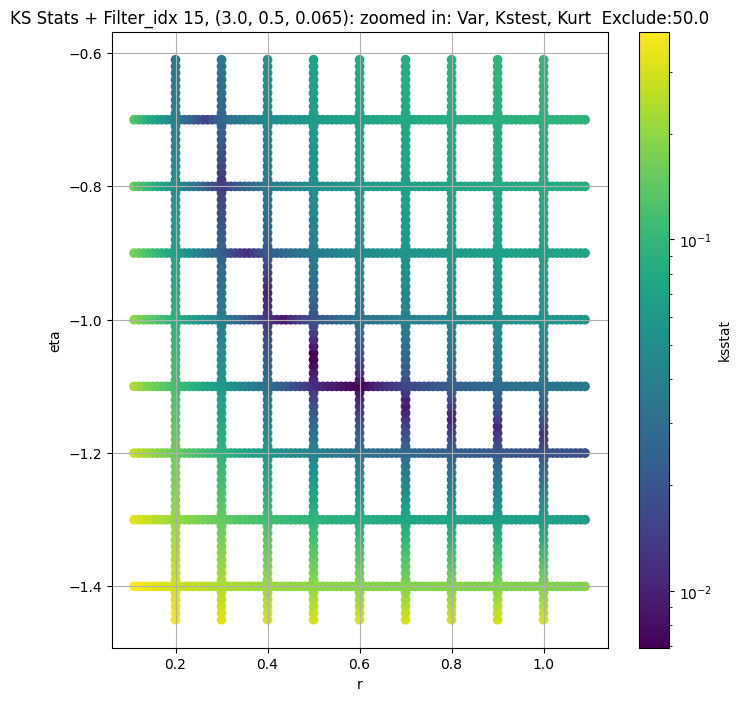

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 100 = 150, ksstat: 0.008984477263859314, var: 5058.8740234375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 75 = 125, ksstat: 0.008734538724674612, var: 5143.29833984375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 50 = 100, ksstat: 0.009602929453162212, var: 5233.93212890625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 25 = 75, ksstat: 0.009223969953352881, var: 5333.34228515625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 0 = 50, ksstat: 0.008863651790715243, var: 5445.447265625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + -25 = 25, ksstat: 0.00841205977270272, var: 5578.43701171875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + -50 = 0, ksstat: 0.007979853259154512, var: 5788.91259765625
Number of samples: 100000, Without approximation : 65536000.0


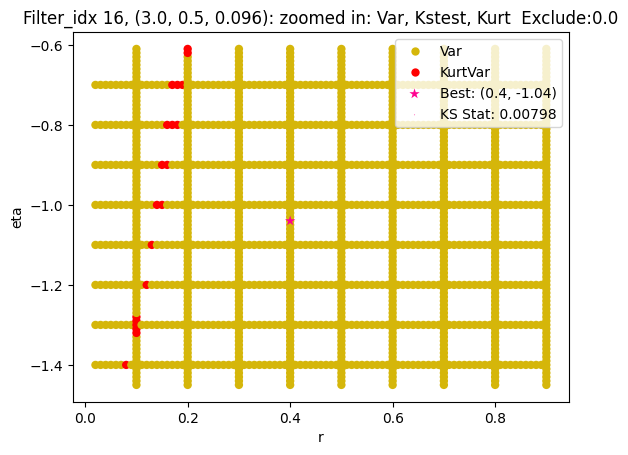

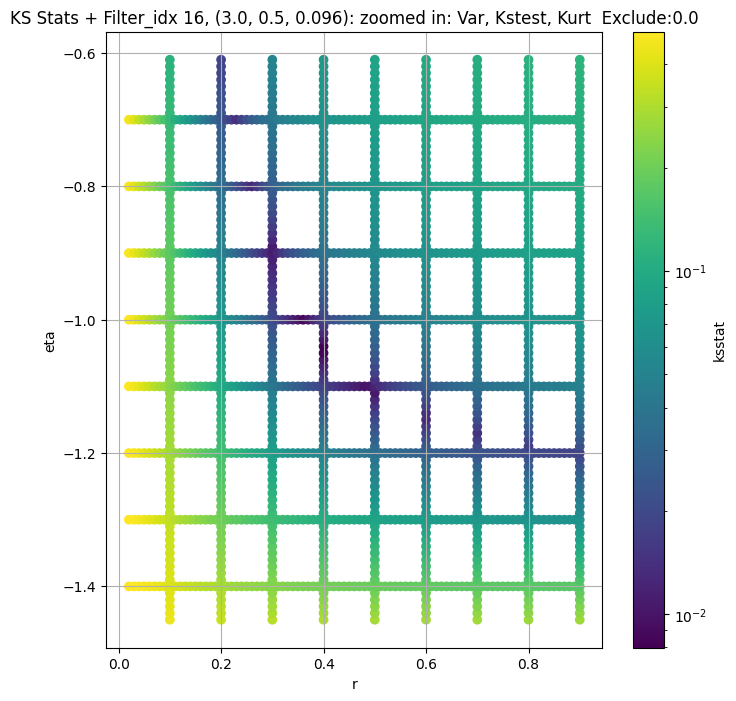

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.008629356613703974, var: 1955.0228271484375


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.008706292485714417, var: 2000.64990234375


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.007748819723665479, var: 2052.5625


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.008047545069558848, var: 2114.846435546875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.007340249554151634, var: 2220.19189453125
Number of samples: 100000, Without approximation : 65536000.0


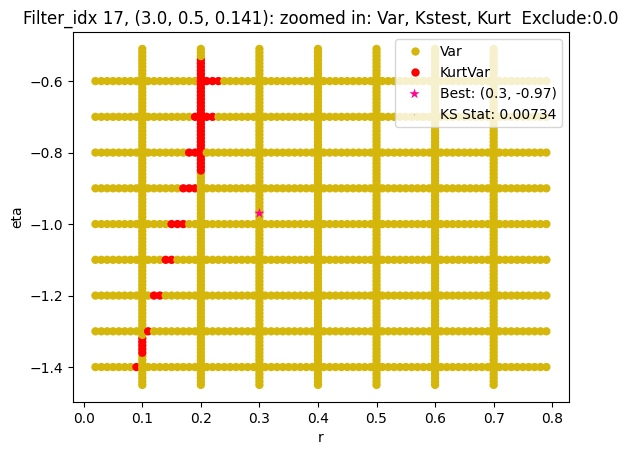

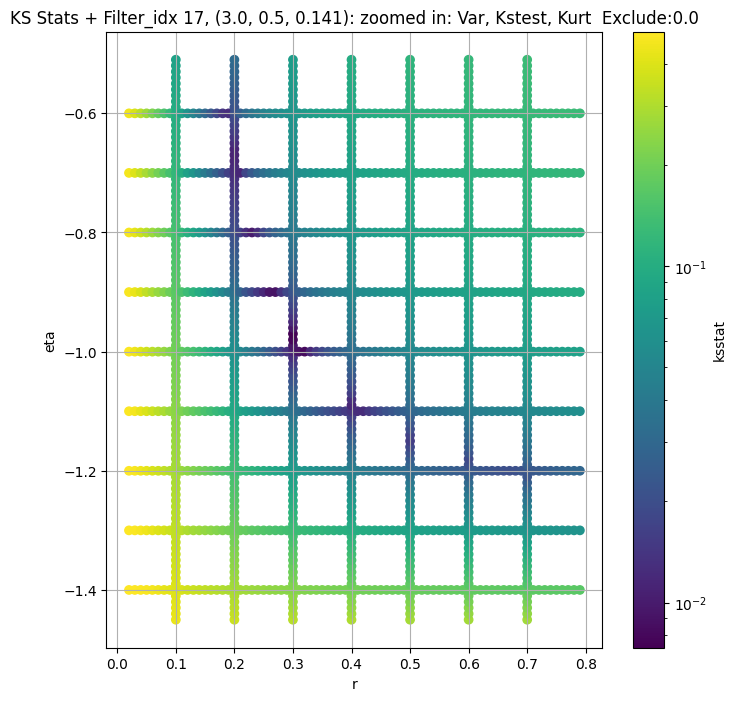

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.007583337622011244, var: 725.839111328125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.007266070396457658, var: 742.4513549804688


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.007060863549911756, var: 760.6471557617188


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.006959565286593028, var: 780.9583129882812


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.006755251768239656, var: 804.380859375


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.006618940330473423, var: 833.2801513671875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.006585973458178684, var: 881.746337890625
Number of samples: 100000, Without approximation : 65536000.0


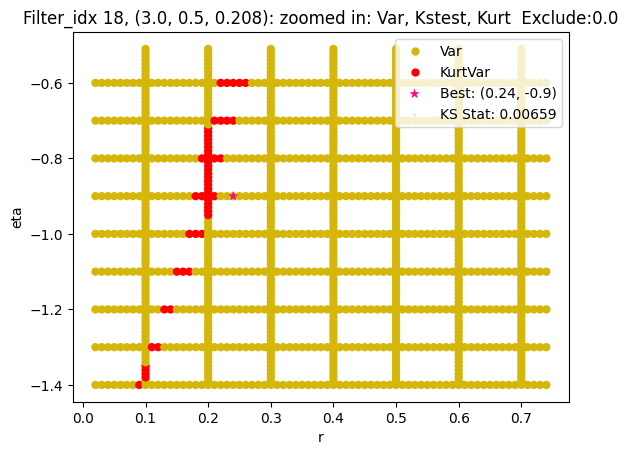

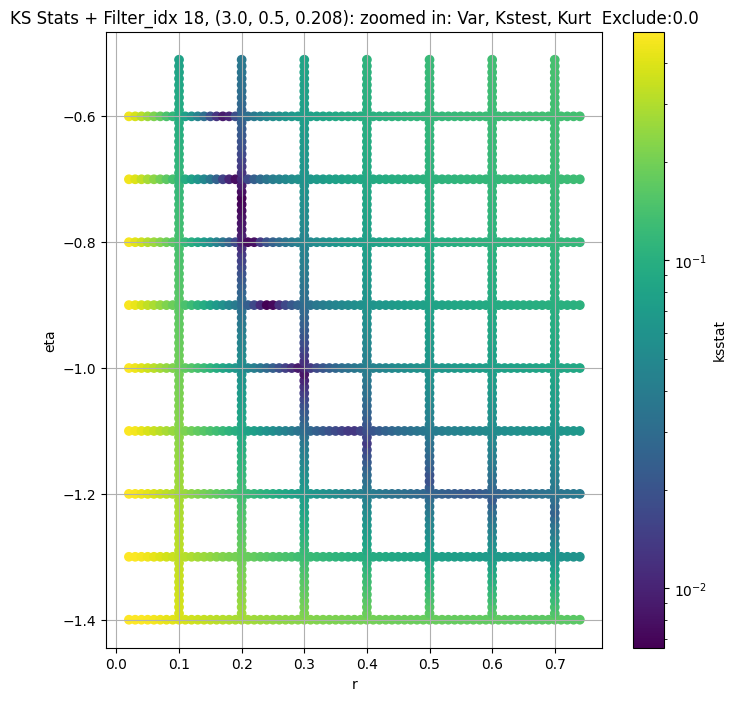

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 200.0 + 100 = 300, ksstat: 0.0075968867136383955, var: 223.7251434326172


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 200.0 + 75 = 275, ksstat: 0.007401233340341679, var: 228.60250854492188


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 200.0 + 50 = 250, ksstat: 0.0077488576166272125, var: 233.75604248046875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 200.0 + 25 = 225, ksstat: 0.007137691107121563, var: 239.2216033935547


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 200.0 + 0 = 200, ksstat: 0.00687581311466115, var: 245.04263305664062


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 200.0 + -25 = 175, ksstat: 0.006433827876479718, var: 251.26593017578125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 200.0 + -50 = 150, ksstat: 0.005969586692030959, var: 257.96759033203125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 200.0 + -75 = 125, ksstat: 0.005478854002037625, var: 265.2409973144531


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 200.0 + -100 = 100, ksstat: 0.005205481701366699, var: 273.2037658691406
Number of samples: 100000, Without approximation : 65536000.0


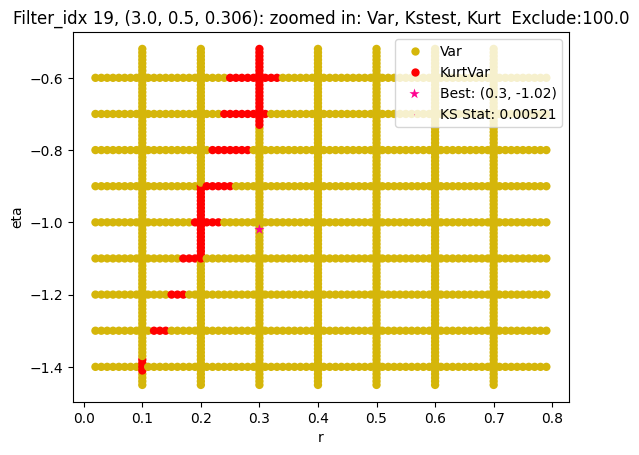

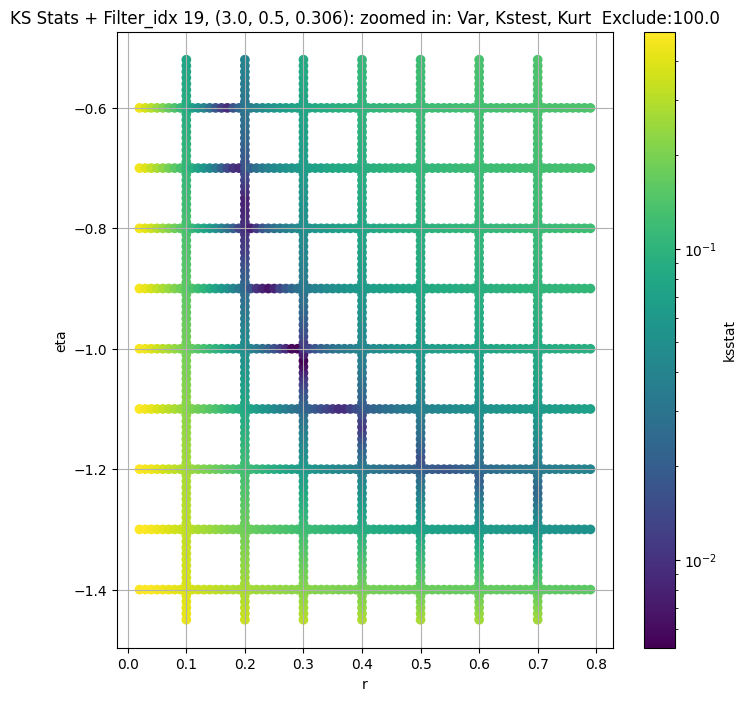

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 50.0 + 100 = 150, ksstat: 0.009125668668676479, var: 127.87152099609375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 50.0 + 75 = 125, ksstat: 0.009378854753826271, var: 131.8712921142578


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 50.0 + 50 = 100, ksstat: 0.00990990138631076, var: 136.27818298339844


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 50.0 + 25 = 75, ksstat: 0.009451932992402545, var: 141.2162628173828


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 50.0 + 0 = 50, ksstat: 0.008657368819084604, var: 146.8568115234375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 50.0 + -25 = 25, ksstat: 0.008287421180485754, var: 153.54571533203125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 50.0 + -50 = 0, ksstat: 0.008162920266691853, var: 165.3518524169922
Number of samples: 100000, Without approximation : 65536000.0


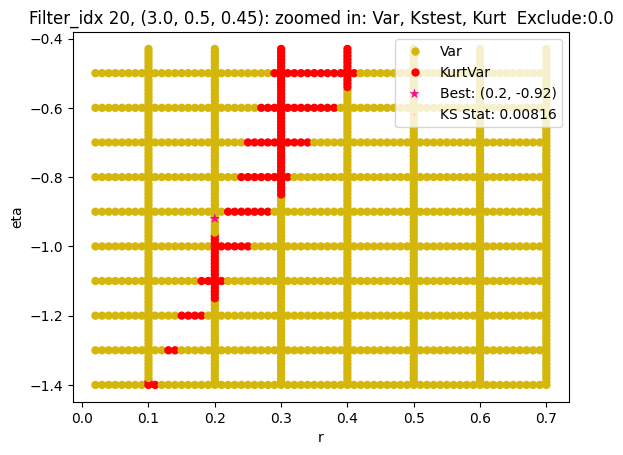

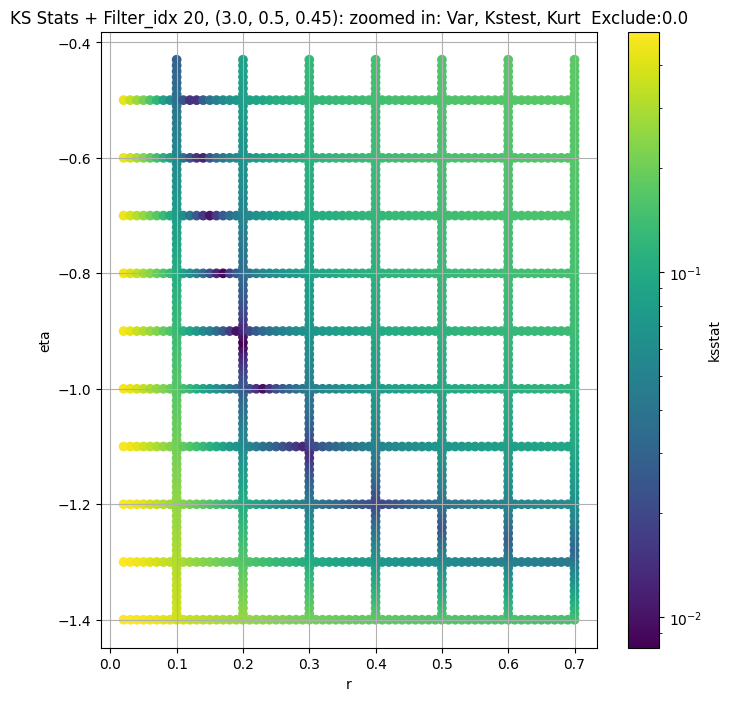

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 100.0 + 100 = 200, ksstat: 0.00550445899263495, var: 46851.84375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 100.0 + 75 = 175, ksstat: 0.006124972380884719, var: 47534.8359375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 100.0 + 50 = 150, ksstat: 0.0057039277720971615, var: 48262.4296875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 100.0 + 25 = 125, ksstat: 0.005068139702556929, var: 49044.5859375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 100.0 + 0 = 100, ksstat: 0.0055270535766724915, var: 49892.5703125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 100.0 + -25 = 75, ksstat: 0.0053161806627789465, var: 50823.04296875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 100.0 + -50 = 50, ksstat: 0.004719319172928893, var: 51872.046875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 100.0 + -75 = 25, ksstat: 0.0041922303411915385, var: 53118.16015625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 100.0 + -100 = 0, ksstat: 0.003983498887734749, var: 55034.55078125
Number of samples: 100000, Without approximation : 65536000.0


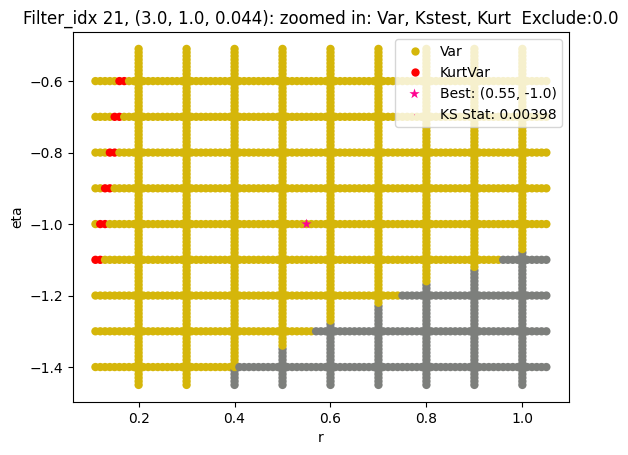

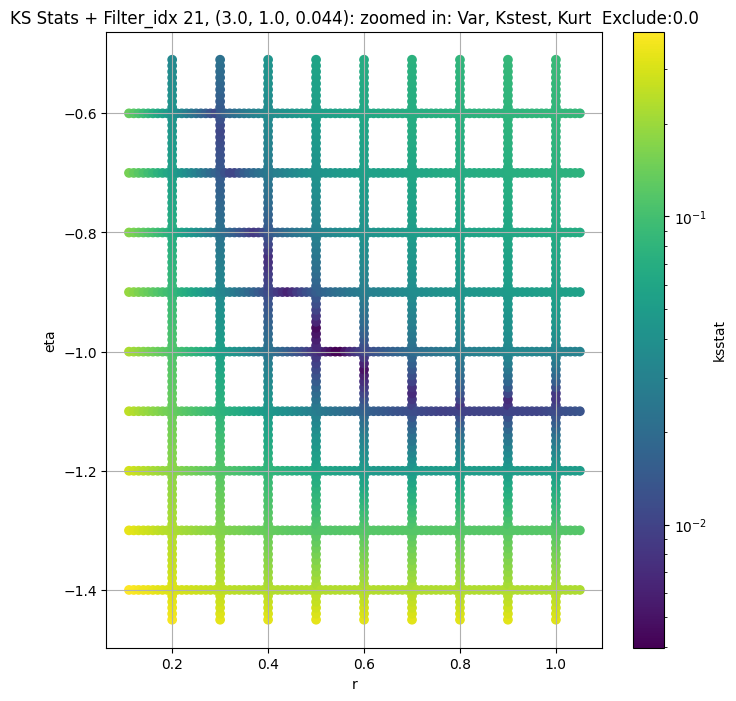

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.0069017689365602625, var: 17345.447265625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.0065568287650834, var: 17726.60546875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.006244807626493376, var: 18157.203125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.005977205705800112, var: 18662.876953125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.005689977621525177, var: 19405.798828125
Number of samples: 100000, Without approximation : 65536000.0


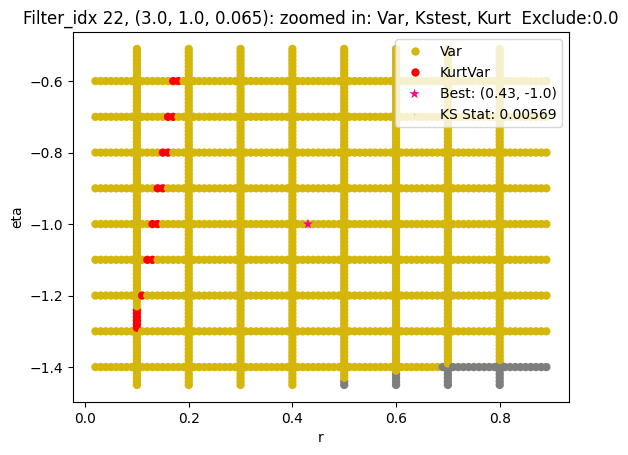

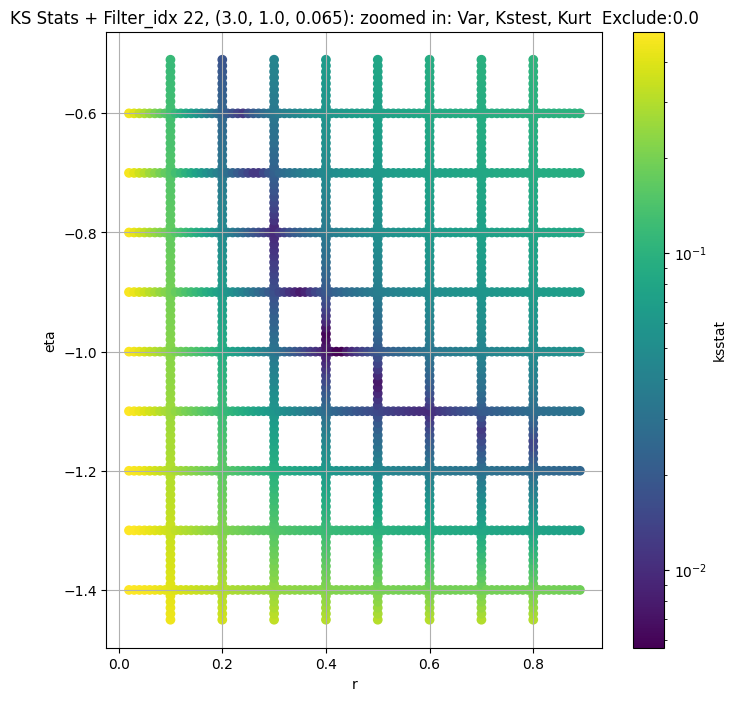

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 50.0 + 100 = 150, ksstat: 0.00871612630734897, var: 6001.185546875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 50.0 + 75 = 125, ksstat: 0.008232893250318507, var: 6136.9775390625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 50.0 + 50 = 100, ksstat: 0.00784170854732702, var: 6285.9580078125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 50.0 + 25 = 75, ksstat: 0.008233194270899982, var: 6451.99462890625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 50.0 + 0 = 50, ksstat: 0.007047974873015728, var: 6641.3818359375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 50.0 + -25 = 25, ksstat: 0.00748760428005002, var: 6867.5849609375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 50.0 + -50 = 0, ksstat: 0.00704042343819522, var: 7223.443359375
Number of samples: 100000, Without approximation : 65536000.0


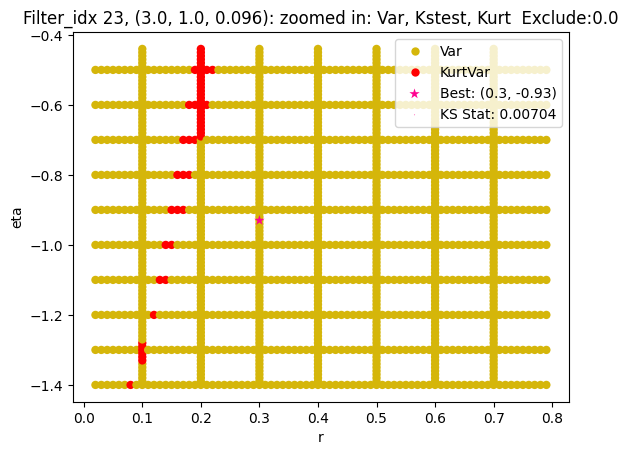

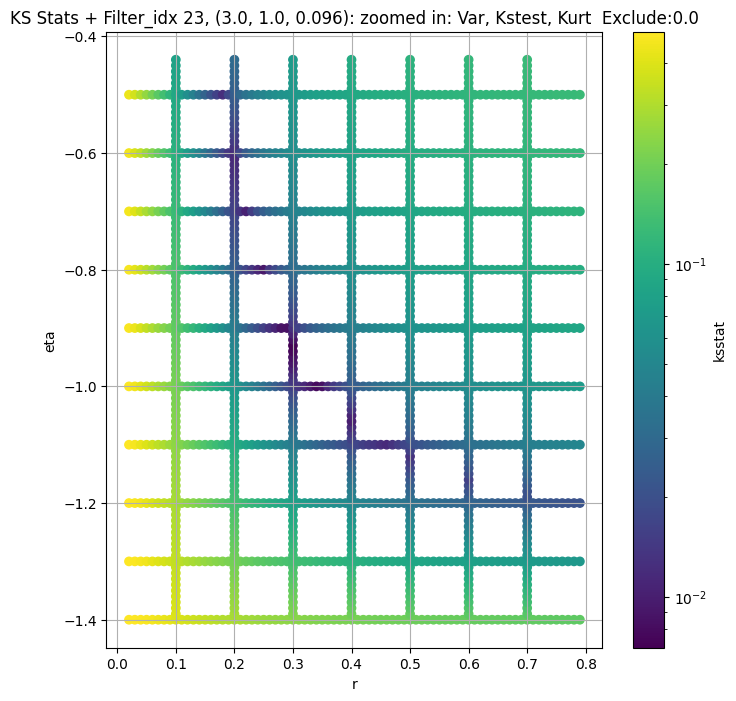

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.008453077686916388, var: 2143.42822265625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.00860992577307429, var: 2211.90869140625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.007569624404269115, var: 2291.717041015625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.007872779054413089, var: 2389.59912109375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.0072961322988562005, var: 2550.41943359375
Number of samples: 100000, Without approximation : 65536000.0


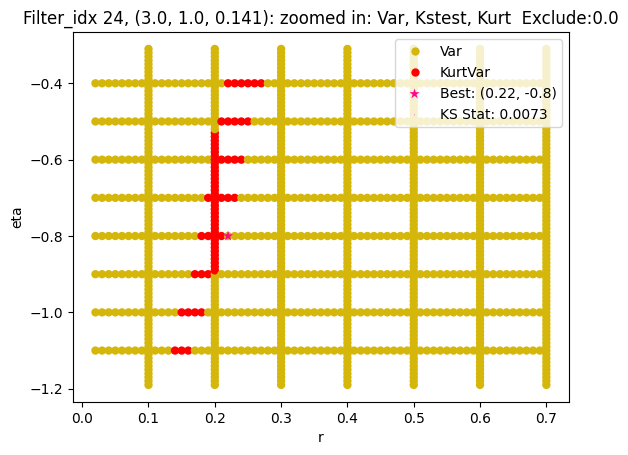

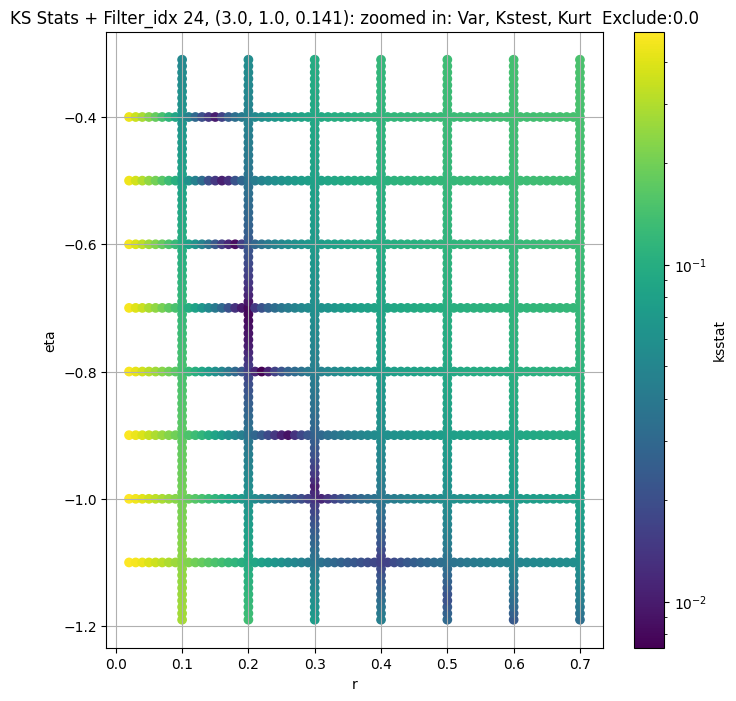

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 100.0 + 100 = 200, ksstat: 0.008341357612922096, var: 725.8199462890625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 100.0 + 75 = 175, ksstat: 0.007811664621744922, var: 744.9288330078125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 100.0 + 50 = 150, ksstat: 0.00837275347610933, var: 765.7490844726562


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 100.0 + 25 = 125, ksstat: 0.007508896780508922, var: 788.6923828125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 100.0 + 0 = 100, ksstat: 0.007815820846596357, var: 814.3456420898438


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 100.0 + -25 = 75, ksstat: 0.006788245741764842, var: 843.5416259765625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 100.0 + -50 = 50, ksstat: 0.006552778196658587, var: 877.4542846679688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 100.0 + -75 = 25, ksstat: 0.00601470931524184, var: 919.7606201171875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 100.0 + -100 = 0, ksstat: 0.006389139426276058, var: 993.3363037109375
Number of samples: 100000, Without approximation : 65536000.0


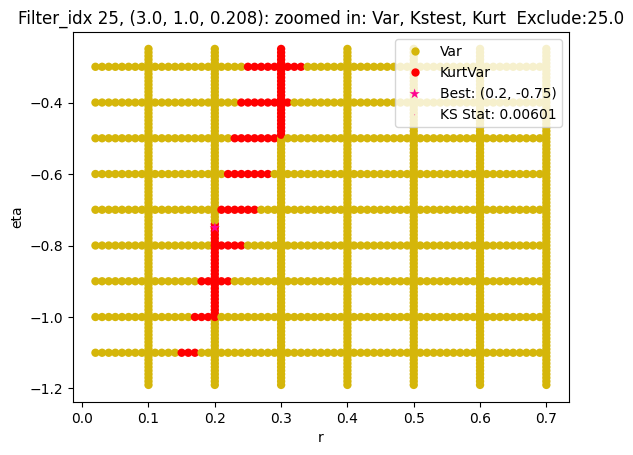

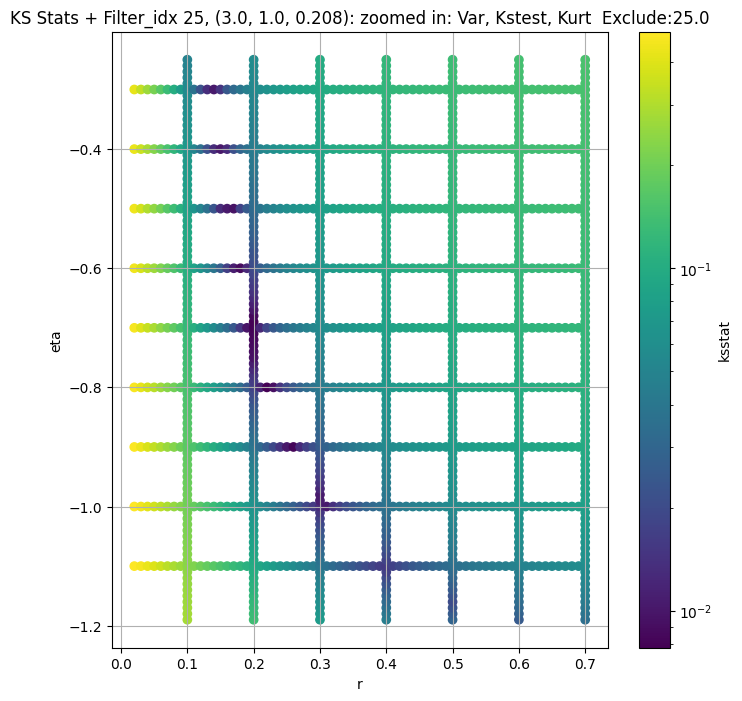

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 50.0 + 100 = 150, ksstat: 0.006440793071511117, var: 277.48175048828125


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 50.0 + 75 = 125, ksstat: 0.0057407623548839035, var: 287.0671691894531


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 50.0 + 50 = 100, ksstat: 0.005511116840012455, var: 297.92529296875


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 50.0 + 25 = 75, ksstat: 0.005143245299895738, var: 310.470458984375


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 50.0 + 0 = 50, ksstat: 0.005097853234668416, var: 325.42987060546875


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 50.0 + -25 = 25, ksstat: 0.004256340320688667, var: 344.2458801269531


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 50.0 + -50 = 0, ksstat: 0.004287229830635453, var: 378.0452880859375
Number of samples: 100000, Without approximation : 65536000.0


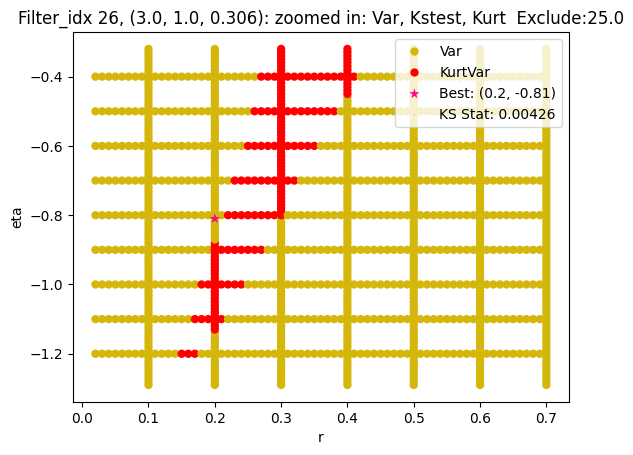

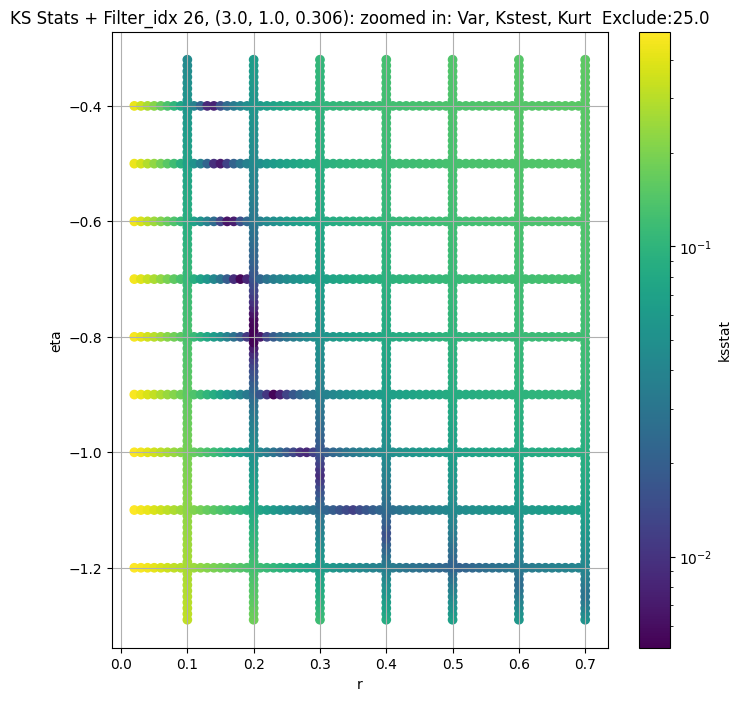

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 100 = 150, ksstat: 0.008108689318576667, var: 120.30073547363281


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 75 = 125, ksstat: 0.007795554441072404, var: 124.84017181396484


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 50 = 100, ksstat: 0.006692287892684015, var: 130.0544891357422


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 25 = 75, ksstat: 0.006599753448978951, var: 136.20692443847656


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 0 = 50, ksstat: 0.00688831202617185, var: 143.7198028564453


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + -25 = 25, ksstat: 0.0068737404410678105, var: 153.4938507080078


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + -50 = 0, ksstat: 0.00706622745825447, var: 170.64552307128906
Number of samples: 100000, Without approximation : 65536000.0


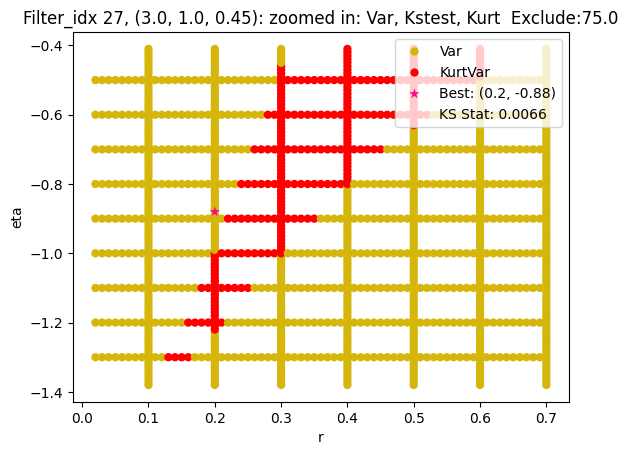

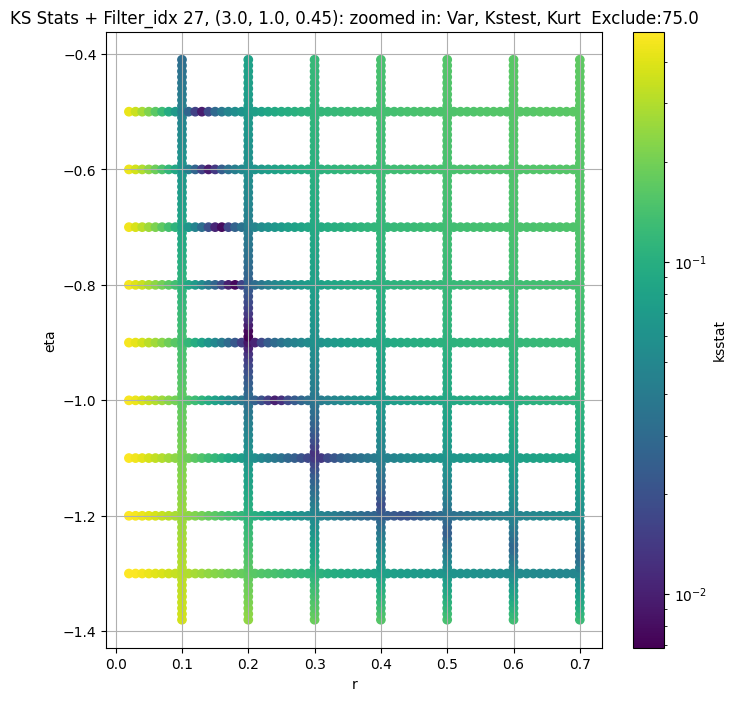

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.005777174881755387, var: 41222.4765625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.0052777627876146455, var: 41801.234375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.004855126660272158, var: 42447.171875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.004069450907954117, var: 43200.1171875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.003935105505244896, var: 44368.47265625
Number of samples: 100000, Without approximation : 65536000.0


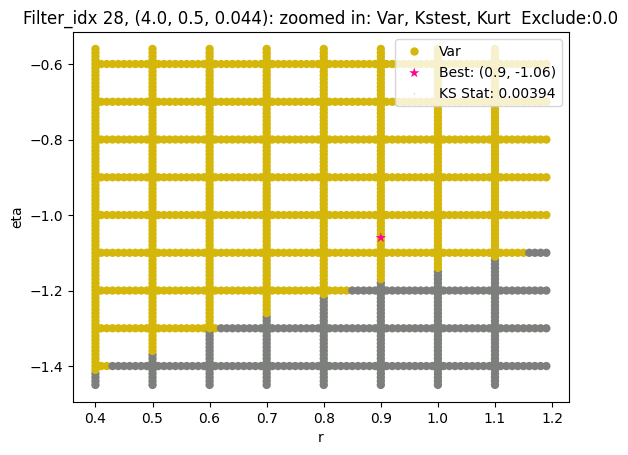

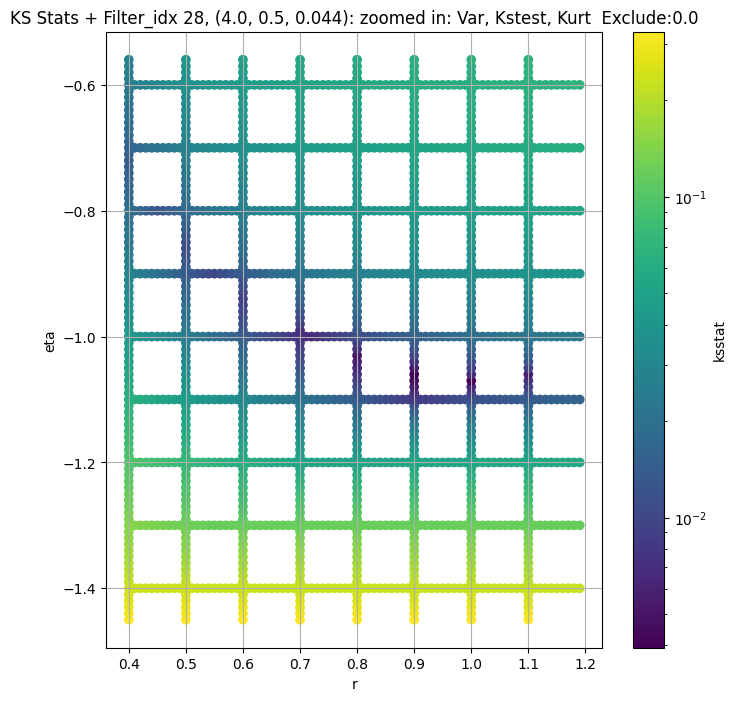

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 29, 0.0 + 100 = 100, ksstat: 0.006977989554101505, var: 14350.220703125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 29, 0.0 + 75 = 75, ksstat: 0.00680381703532329, var: 14594.8037109375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 29, 0.0 + 50 = 50, ksstat: 0.006608802967126848, var: 14869.8125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 29, 0.0 + 25 = 25, ksstat: 0.007122268577615665, var: 15194.1728515625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 29, 0.0 + 0 = 0, ksstat: 0.006024841899643862, var: 15727.4033203125
Number of samples: 100000, Without approximation : 65536000.0


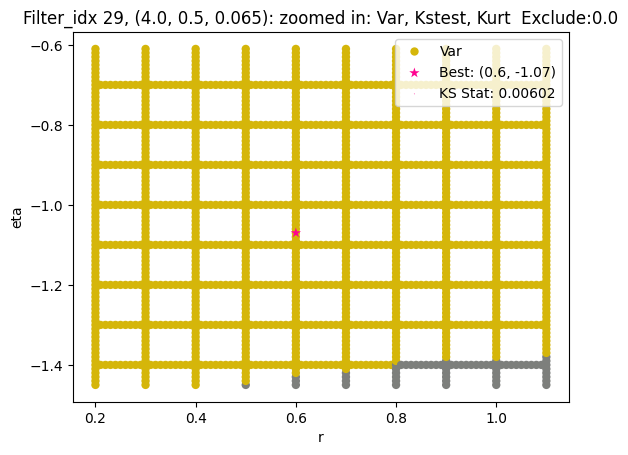

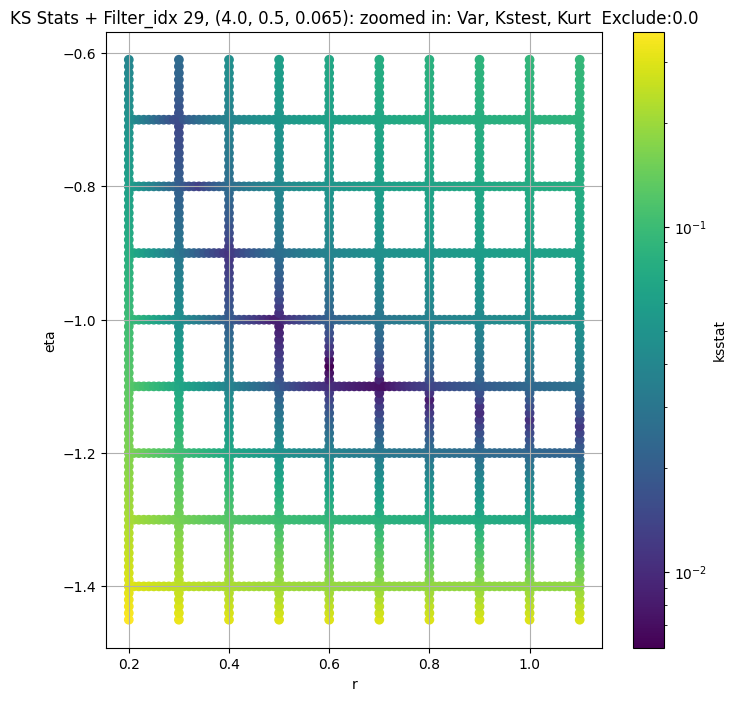

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.009075427027568417, var: 4939.16845703125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.009730906143136542, var: 5042.19287109375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.009403562708817703, var: 5159.08837890625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.009815648683906164, var: 5299.78662109375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.00878253476484836, var: 5532.07373046875
Number of samples: 100000, Without approximation : 65536000.0


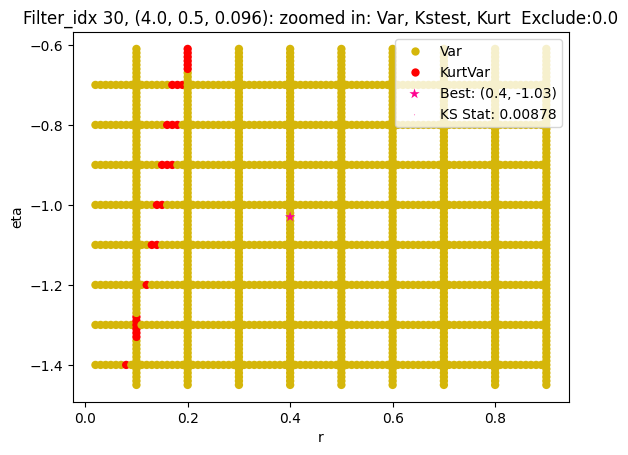

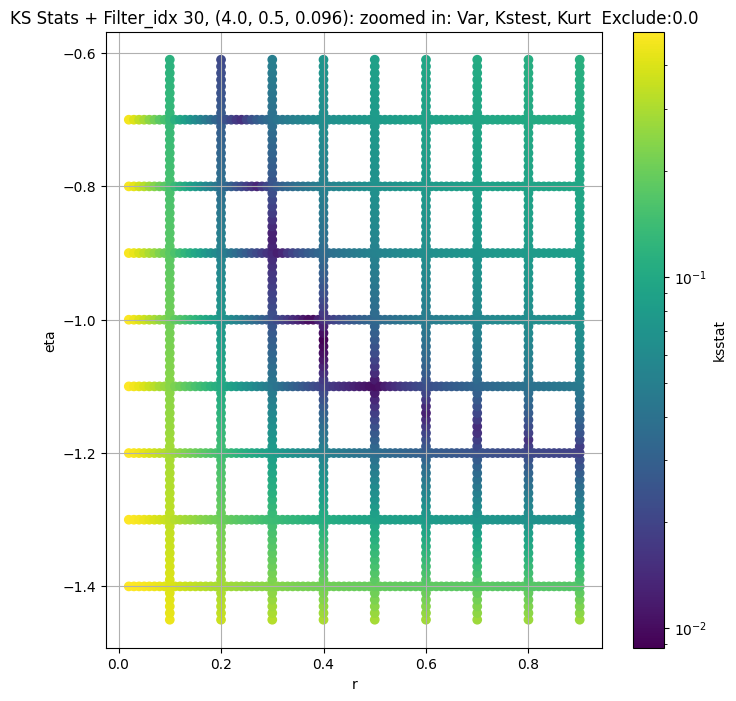

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 200.0 + 100 = 300, ksstat: 0.010630790573548488, var: 1624.6636962890625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 200.0 + 75 = 275, ksstat: 0.010456937678580691, var: 1649.775146484375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 200.0 + 50 = 250, ksstat: 0.01078207486751337, var: 1676.211181640625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 200.0 + 25 = 225, ksstat: 0.010605106315345503, var: 1704.139404296875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 200.0 + 0 = 200, ksstat: 0.010840682571942935, var: 1733.7667236328125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 200.0 + -25 = 175, ksstat: 0.01050900447041292, var: 1765.383056640625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 200.0 + -50 = 150, ksstat: 0.01016008445785066, var: 1799.3497314453125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 200.0 + -75 = 125, ksstat: 0.0093833165617222, var: 1836.16357421875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 200.0 + -100 = 100, ksstat: 0.008949910464786326, var: 1876.5714111328125
Number of samples: 100000, Without approximation : 65536000.0


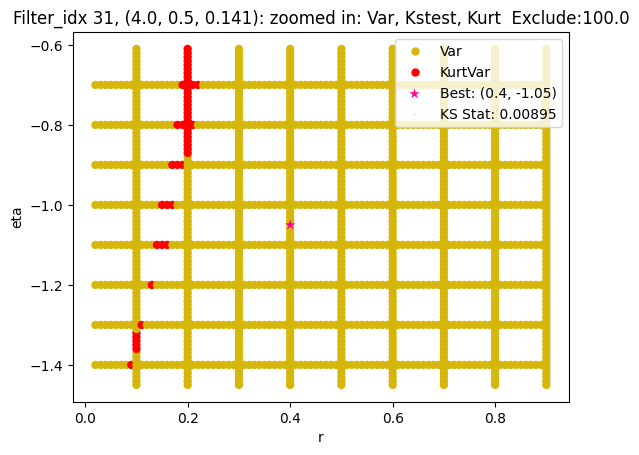

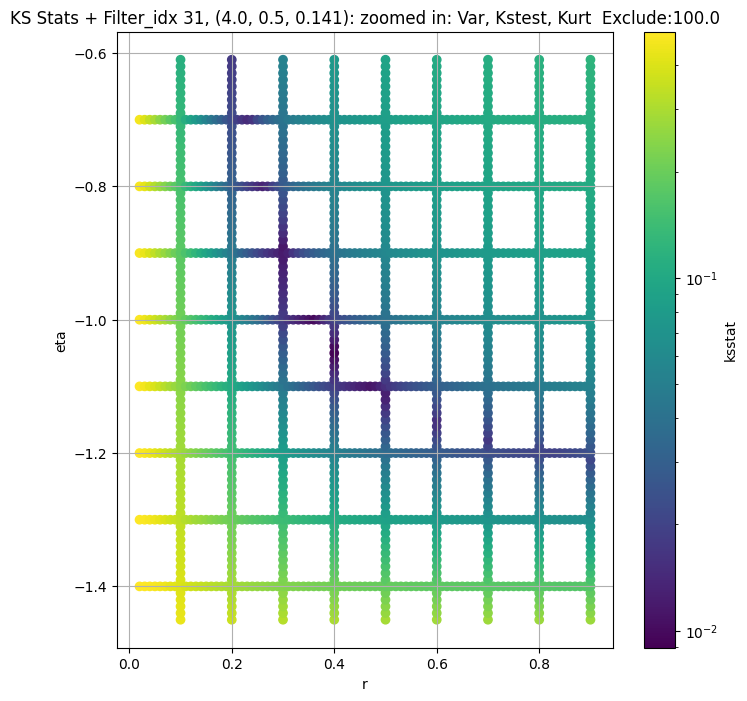

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 32, 50.0 + 100 = 150, ksstat: 0.008519163977984662, var: 672.09521484375


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 32, 50.0 + 75 = 125, ksstat: 0.007852958270307984, var: 688.509765625


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 32, 50.0 + 50 = 100, ksstat: 0.007687490190892057, var: 706.7017211914062


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 32, 50.0 + 25 = 75, ksstat: 0.007109295368494133, var: 727.30078125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 32, 50.0 + 0 = 50, ksstat: 0.007068198022420091, var: 751.4292602539062


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 32, 50.0 + -25 = 25, ksstat: 0.007222575002336584, var: 781.6484375


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 32, 50.0 + -50 = 0, ksstat: 0.006472808424535237, var: 836.758544921875
Number of samples: 100000, Without approximation : 65536000.0


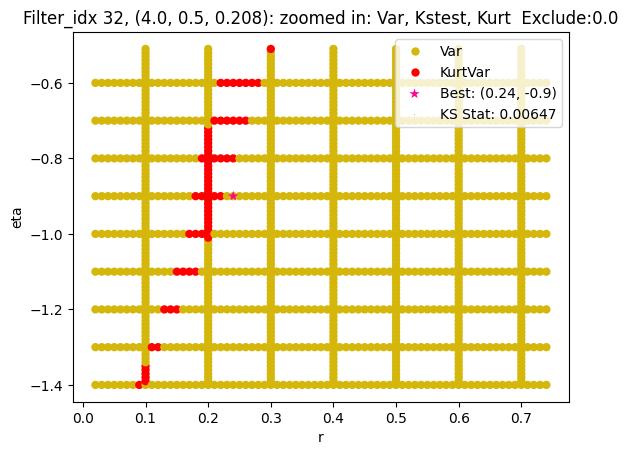

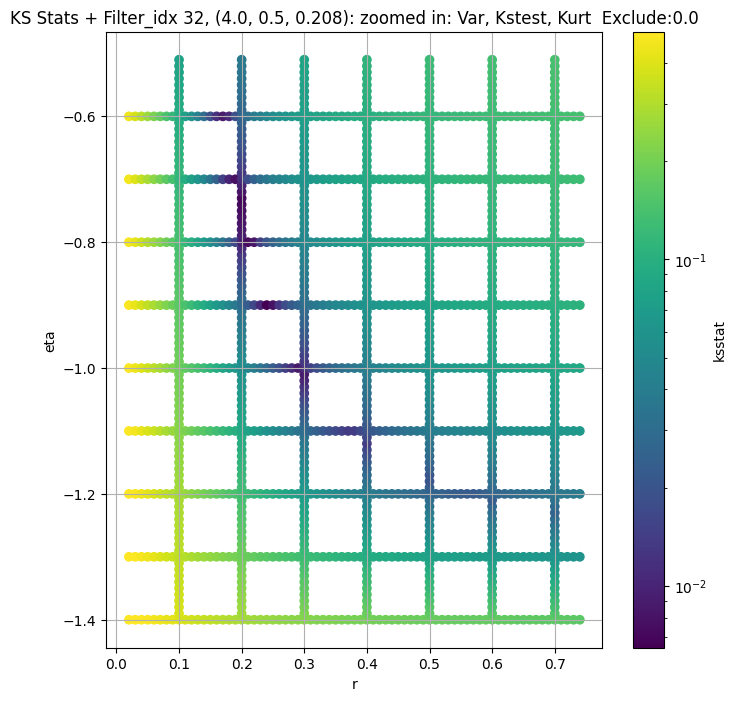

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 100 = 100, ksstat: 0.005848150939904206, var: 286.962158203125


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 75 = 75, ksstat: 0.0052733615597451815, var: 296.1327209472656


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 50 = 50, ksstat: 0.004788197984012088, var: 306.8105773925781


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 25 = 25, ksstat: 0.005138535181936632, var: 320.0106201171875


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 0 = 0, ksstat: 0.004286275039544929, var: 344.8192138671875
Number of samples: 100000, Without approximation : 65536000.0


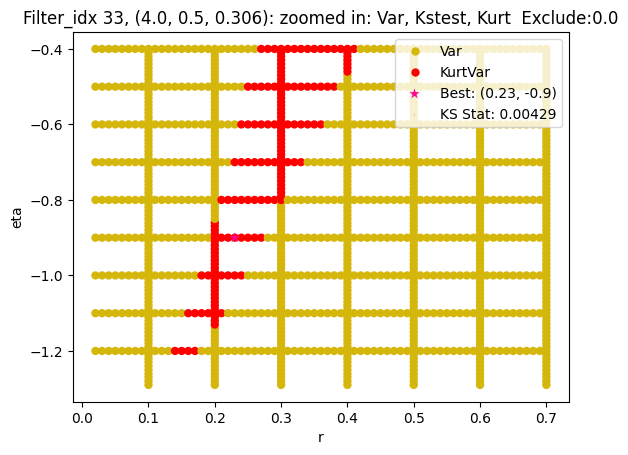

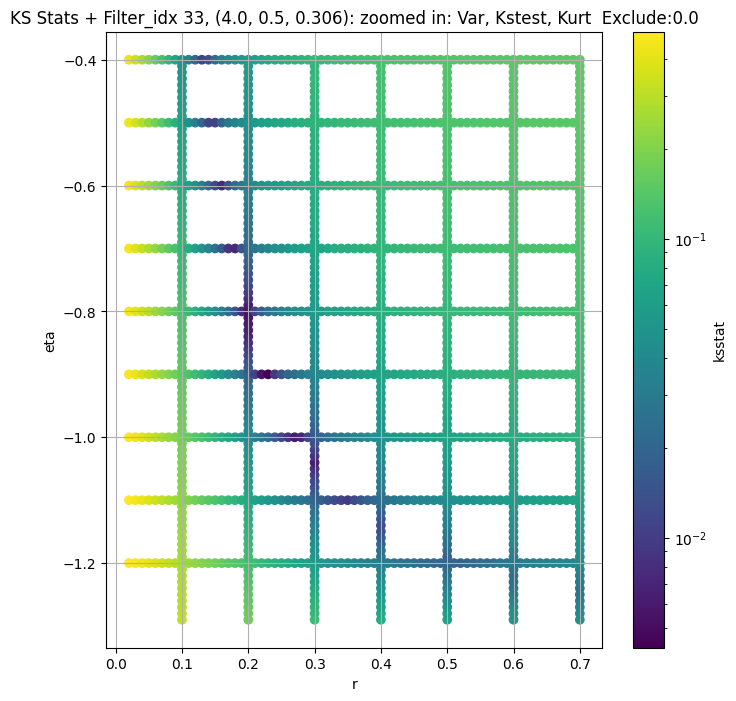

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 100 = 300, ksstat: 0.01375361749666193, var: 91.62366485595703


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 75 = 275, ksstat: 0.013032141161632538, var: 93.78081512451172


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 50 = 250, ksstat: 0.0123138168571576, var: 96.06389617919922


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 25 = 225, ksstat: 0.011654642043088193, var: 98.4896469116211


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 0 = 200, ksstat: 0.012900922494285982, var: 101.08636474609375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + -25 = 175, ksstat: 0.012521546880726611, var: 103.88107299804688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + -50 = 150, ksstat: 0.012113244816508897, var: 106.90648651123047


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + -75 = 125, ksstat: 0.01166748607702222, var: 110.21160888671875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + -100 = 100, ksstat: 0.011343772467375945, var: 113.86150360107422
Number of samples: 100000, Without approximation : 65536000.0


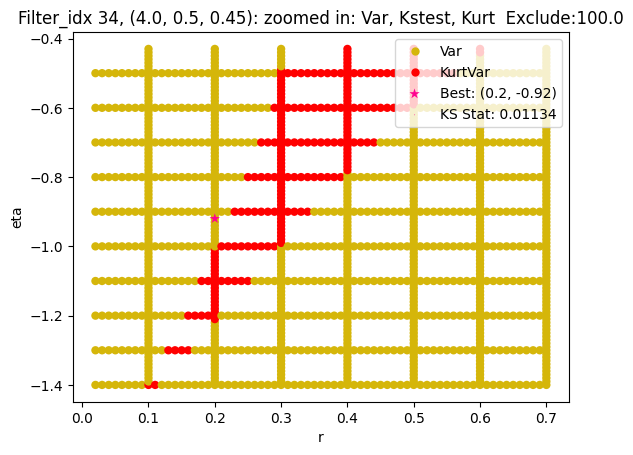

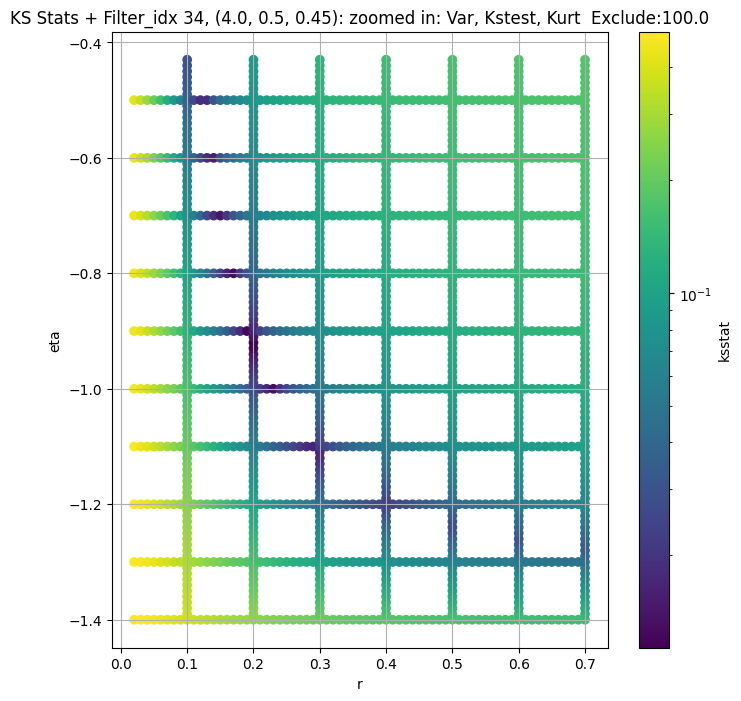

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 100.0 + 100 = 200, ksstat: 0.004351611586435267, var: 41542.78125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 100.0 + 75 = 175, ksstat: 0.00399271178515637, var: 42184.81640625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 100.0 + 50 = 150, ksstat: 0.003747936938029217, var: 42869.203125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 100.0 + 25 = 125, ksstat: 0.0034392702566917732, var: 43603.76171875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 100.0 + 0 = 100, ksstat: 0.0029526328747715644, var: 44399.96875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 100.0 + -25 = 75, ksstat: 0.002823828506105963, var: 45276.0078125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 100.0 + -50 = 50, ksstat: 0.0028746861798850665, var: 46268.54296875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 100.0 + -75 = 25, ksstat: 0.002905909220759395, var: 47448.60546875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 100.0 + -100 = 0, ksstat: 0.002761230092635847, var: 49227.171875
Number of samples: 100000, Without approximation : 65536000.0


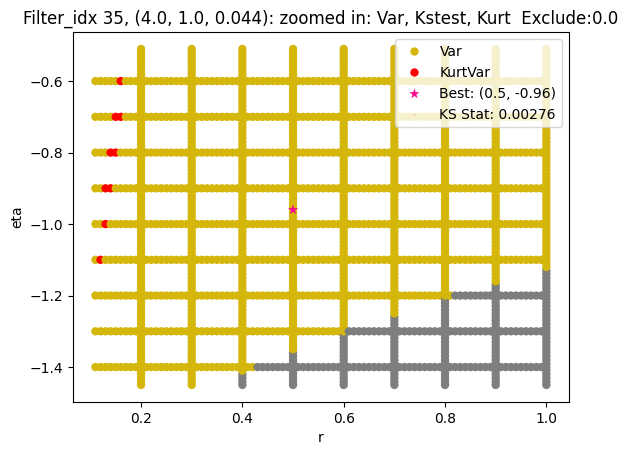

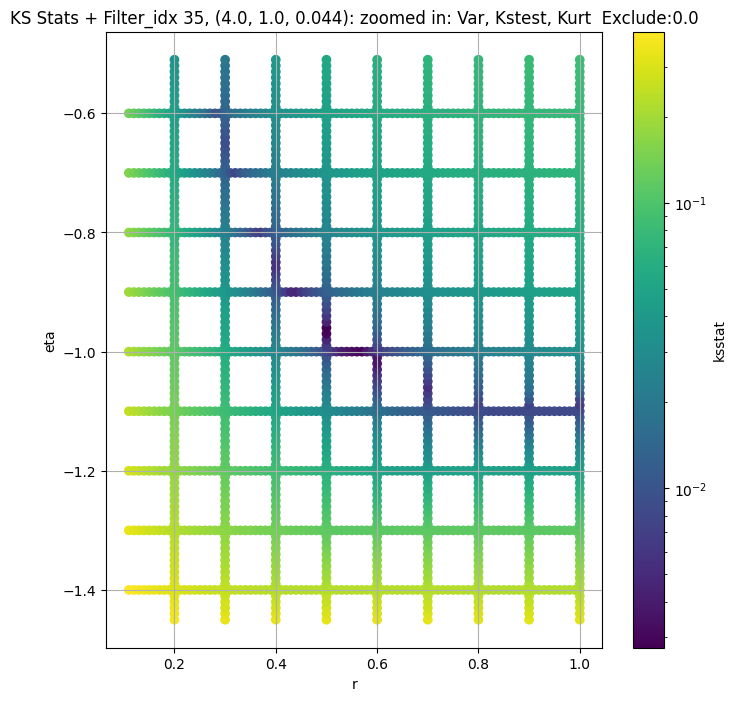

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 100 = 100, ksstat: 0.0046531074238285175, var: 15927.6865234375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 75 = 75, ksstat: 0.004355534120433047, var: 16327.330078125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 50 = 50, ksstat: 0.004084776217450806, var: 16783.474609375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 25 = 25, ksstat: 0.004276310042199305, var: 17333.07421875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 0 = 0, ksstat: 0.004692934939949267, var: 18242.84375
Number of samples: 100000, Without approximation : 65536000.0


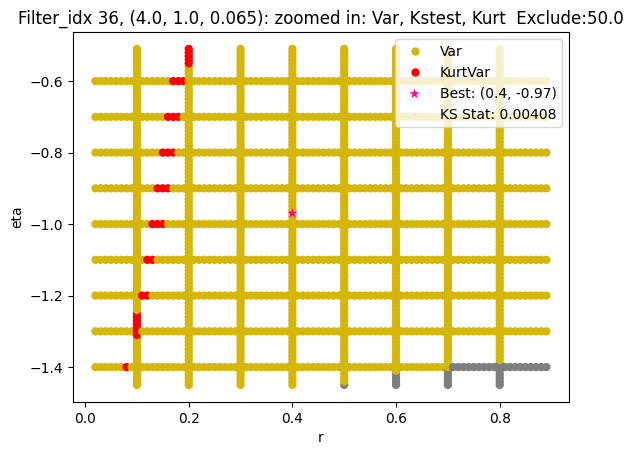

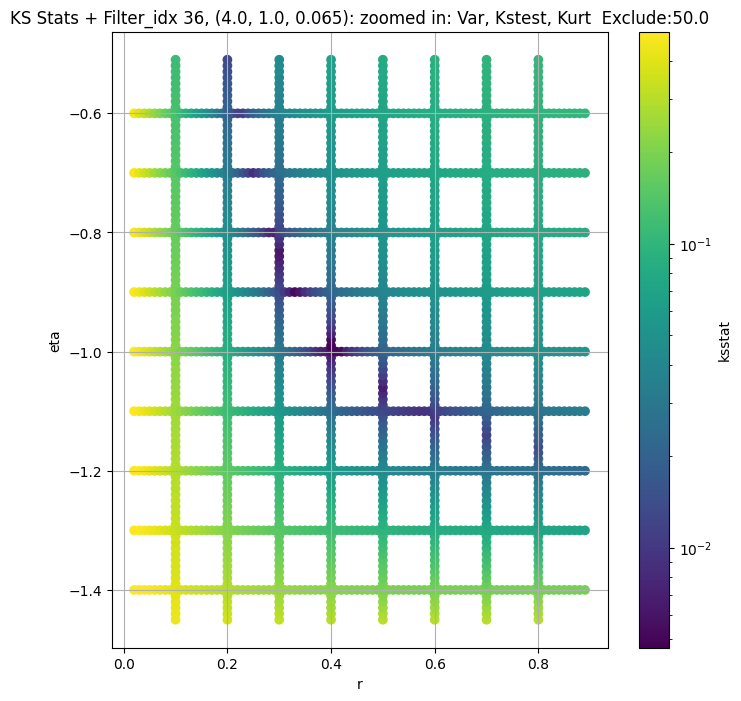

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 50.0 + 100 = 150, ksstat: 0.007583865379283128, var: 5299.79638671875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 50.0 + 75 = 125, ksstat: 0.007223394232767633, var: 5428.38720703125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 50.0 + 50 = 100, ksstat: 0.00759445531043712, var: 5569.98974609375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 50.0 + 25 = 75, ksstat: 0.007291257154209654, var: 5728.27099609375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 50.0 + 0 = 50, ksstat: 0.0067146200732297046, var: 5909.20654296875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 50.0 + -25 = 25, ksstat: 0.006065235968209293, var: 6125.83935546875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 50.0 + -50 = 0, ksstat: 0.006237248626445646, var: 6475.427734375
Number of samples: 100000, Without approximation : 65536000.0


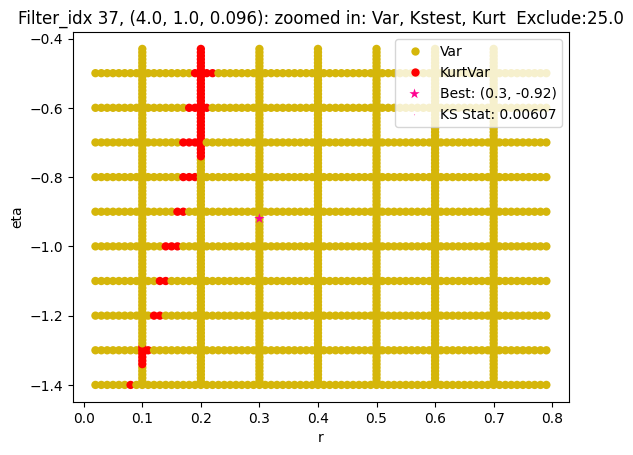

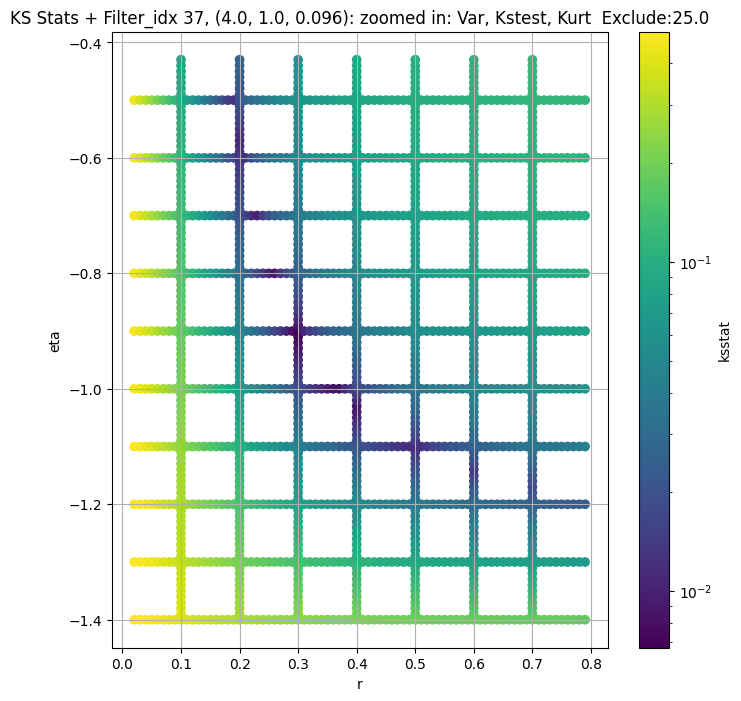

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 50.0 + 100 = 150, ksstat: 0.007537307119104497, var: 1888.6810302734375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 50.0 + 75 = 125, ksstat: 0.007432530575649965, var: 1945.0089111328125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 50.0 + 50 = 100, ksstat: 0.007854366187728057, var: 2007.8282470703125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 50.0 + 25 = 75, ksstat: 0.00710819518326733, var: 2079.07275390625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 50.0 + 0 = 50, ksstat: 0.007495385454251324, var: 2161.566162109375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 50.0 + -25 = 25, ksstat: 0.006392708738588548, var: 2260.686279296875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 50.0 + -50 = 0, ksstat: 0.00564762957363929, var: 2418.435791015625
Number of samples: 100000, Without approximation : 65536000.0


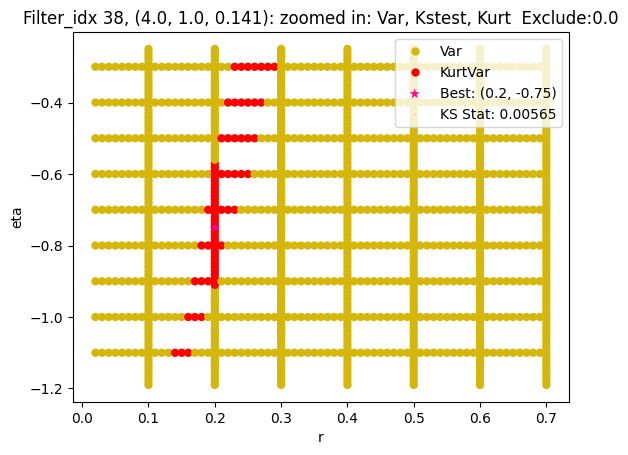

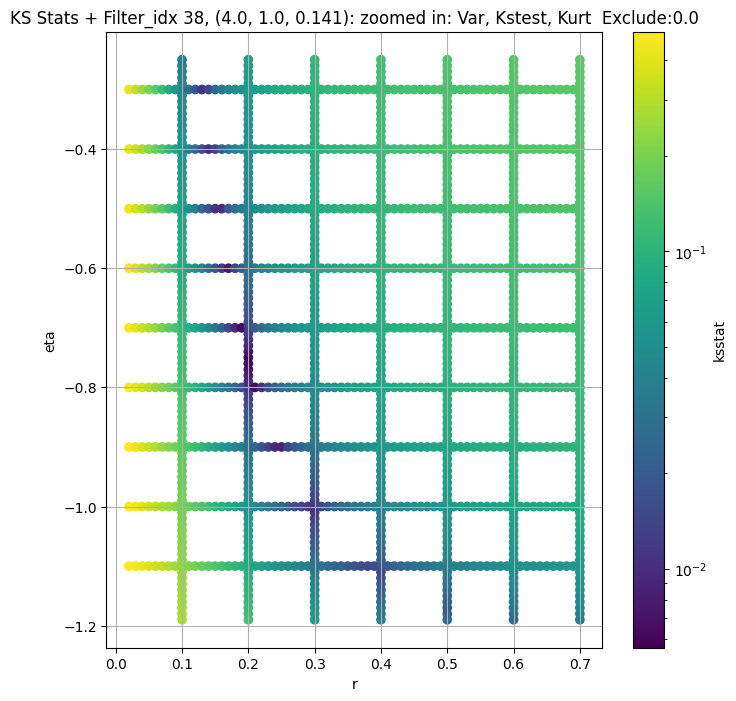

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 39, 0.0 + 100 = 100, ksstat: 0.008614610904270167, var: 757.7802734375


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 39, 0.0 + 75 = 75, ksstat: 0.007270081900564551, var: 788.7313232421875


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 39, 0.0 + 50 = 50, ksstat: 0.005860087137069869, var: 825.4807739257812


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 39, 0.0 + 25 = 25, ksstat: 0.005851165768979261, var: 872.141357421875


  0%|          | 0/747 [00:00<?, ?it/s]

Finding Minimum after computing 747 CDFs
filter_idx 39, 0.0 + 0 = 0, ksstat: 0.003971218191467174, var: 964.7728271484375
Number of samples: 100000, Without approximation : 65536000.0


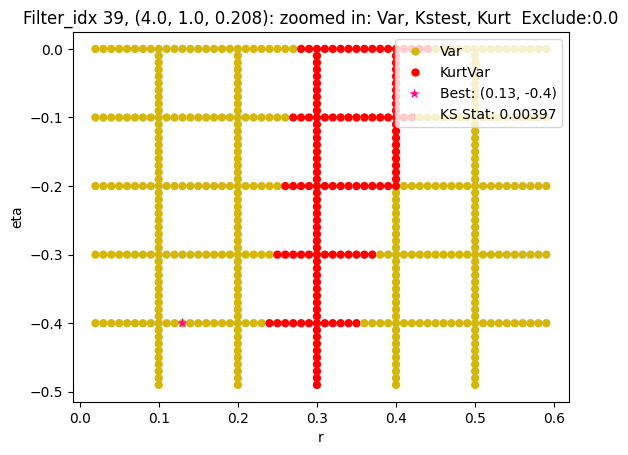

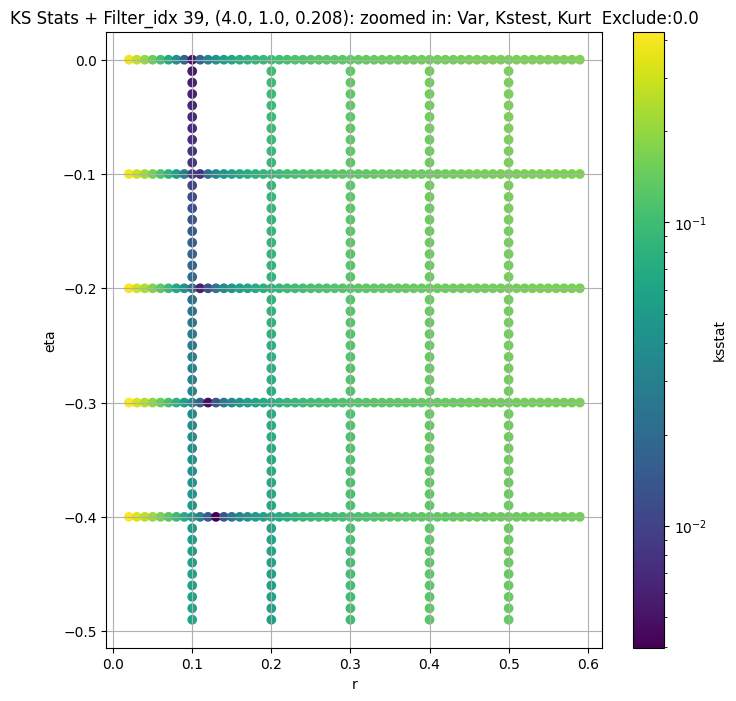

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 100 = 150, ksstat: 0.005101108375909269, var: 263.47491455078125


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 75 = 125, ksstat: 0.004427052183831541, var: 273.3196105957031


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 50 = 100, ksstat: 0.004499432385810298, var: 284.5168762207031


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 25 = 75, ksstat: 0.0038828779613940823, var: 297.48590087890625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 0 = 50, ksstat: 0.0031891033742017516, var: 313.1163635253906


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + -25 = 25, ksstat: 0.003065365624654093, var: 333.357177734375


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + -50 = 0, ksstat: 0.002789841621505307, var: 374.26287841796875
Number of samples: 100000, Without approximation : 65536000.0


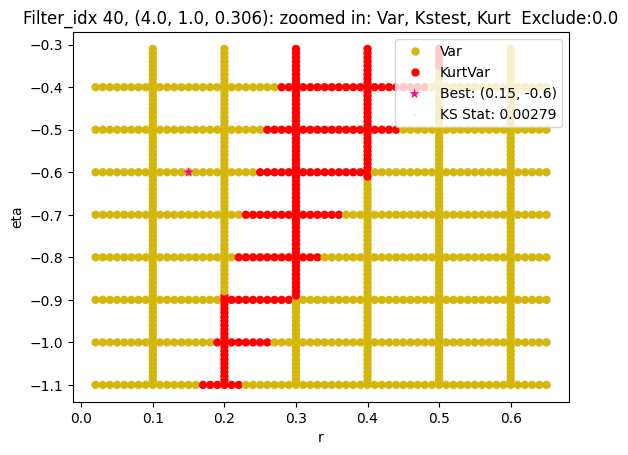

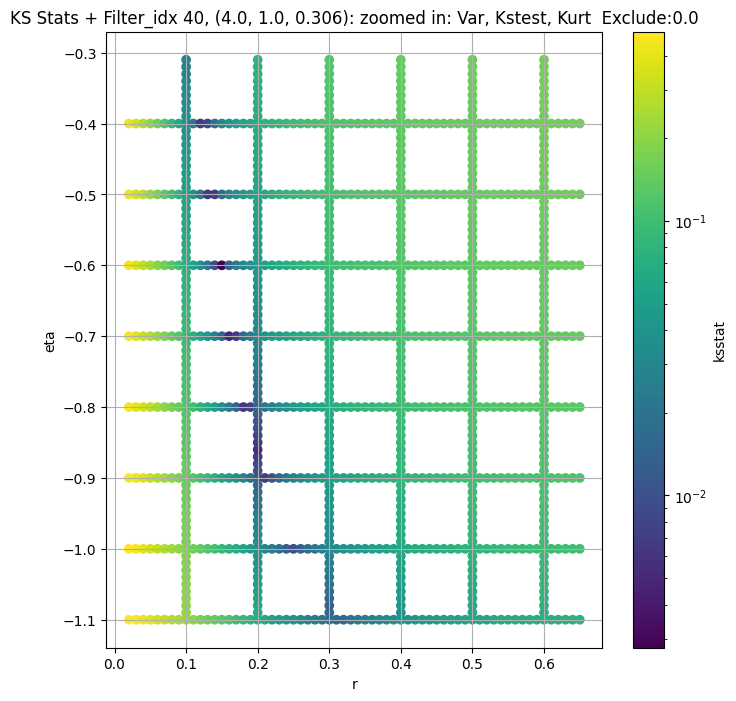

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/927 [00:00<?, ?it/s]

Finding Minimum after computing 927 CDFs
filter_idx 41, 0.0 + 100 = 100, ksstat: 0.011296618511141963, var: 115.95442962646484


  0%|          | 0/927 [00:00<?, ?it/s]

Finding Minimum after computing 927 CDFs
filter_idx 41, 0.0 + 75 = 75, ksstat: 0.009592543467952228, var: 122.31906127929688


  0%|          | 0/927 [00:00<?, ?it/s]

Finding Minimum after computing 927 CDFs
filter_idx 41, 0.0 + 50 = 50, ksstat: 0.009924679399133572, var: 130.2273712158203


  0%|          | 0/927 [00:00<?, ?it/s]

Finding Minimum after computing 927 CDFs
filter_idx 41, 0.0 + 25 = 25, ksstat: 0.010119140820409878, var: 140.77792358398438


  0%|          | 0/927 [00:00<?, ?it/s]

Finding Minimum after computing 927 CDFs
filter_idx 41, 0.0 + 0 = 0, ksstat: 0.007788812181372284, var: 161.14639282226562
Number of samples: 100000, Without approximation : 65536000.0


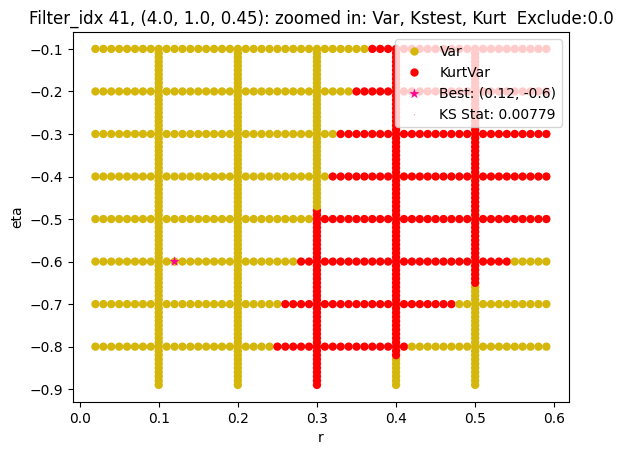

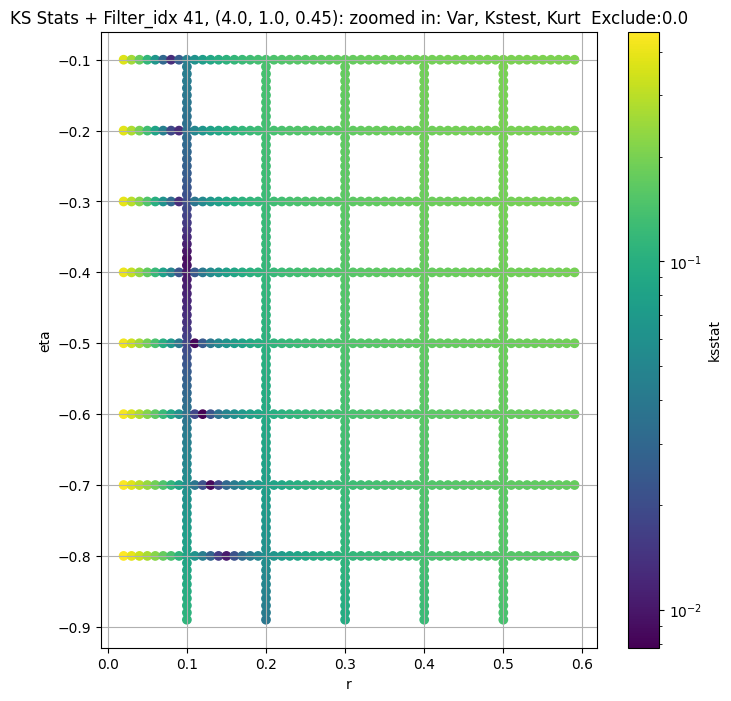

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",49240.44000,38882.65000,60244.74600,4.773906,2.801561,11.781327,65536000.0,"(2.0, 0.5, 0.044)",0.010135,...,6.988049e+04,100.0,49240.441406,0.000168,0.006354,0.90,-1.05,9.753571e+04,0.0,48000
1,"(2.0, 0.5, 0.065)",17537.88500,13703.03100,22308.49800,6.268736,3.636876,14.473557,65536000.0,"(2.0, 0.5, 0.065)",0.006708,...,3.248583e+04,50.0,17537.884766,0.000168,0.005707,0.77,-1.10,3.198206e+04,0.0,54000
2,"(2.0, 0.5, 0.096)",6263.64750,4817.59230,8065.39060,8.682725,4.491842,22.594627,65536000.0,"(2.0, 0.5, 0.096)",0.007730,...,6.773260e+03,50.0,5955.544434,0.000168,0.007467,0.61,-1.10,7.034449e+03,50.0,32000
3,"(2.0, 0.5, 0.141)",2366.95400,1740.60230,3189.22300,11.592262,5.991223,32.245300,65536000.0,"(2.0, 0.5, 0.141)",0.008108,...,1.546723e+03,50.0,2366.954102,0.000168,0.007011,0.40,-1.04,5.611279e+02,0.0,36000
4,"(2.0, 0.5, 0.208)",947.27313,670.49140,1259.57480,13.660814,7.580907,37.590374,65536000.0,"(2.0, 0.5, 0.208)",0.009855,...,2.204424e+01,50.0,884.612366,0.000168,0.006269,0.40,-1.06,2.264114e+02,50.0,48000
5,"(2.0, 0.5, 0.306)",332.07900,220.95845,459.92392,18.274677,8.888781,51.722927,65536000.0,"(2.0, 0.5, 0.306)",0.008180,...,1.089171e+01,100.0,275.971802,0.000168,0.008173,0.40,-1.09,7.965627e+01,150.0,27000
6,"(2.0, 0.5, 0.45)",206.10092,141.26283,293.74957,18.116974,9.422618,55.211193,65536000.0,"(2.0, 0.5, 0.45)",0.010424,...,4.951585e+01,200.0,171.759354,0.000168,0.010413,0.39,-1.10,4.608722e+01,150.0,18000
7,"(2.0, 1.0, 0.044)",69678.76000,56125.30500,86983.69000,5.744799,3.133826,17.976940,65536000.0,"(2.0, 1.0, 0.044)",0.006721,...,1.000000e+05,0.0,68023.523438,0.000168,0.003916,0.80,-0.99,1.000000e+05,25.0,121500
8,"(2.0, 1.0, 0.065)",24894.46500,19084.35500,32298.96900,8.052679,3.912416,27.094390,65536000.0,"(2.0, 1.0, 0.065)",0.004756,...,6.258475e+04,200.0,22874.410156,0.000168,0.003720,0.90,-1.08,4.870903e+04,100.0,128000


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

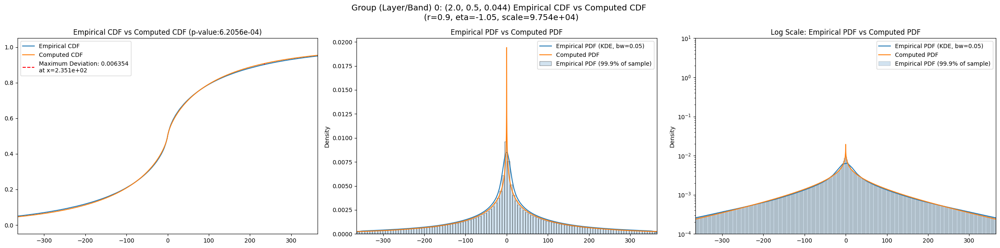

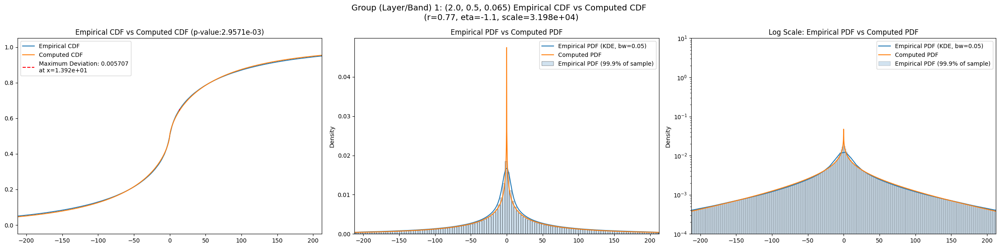

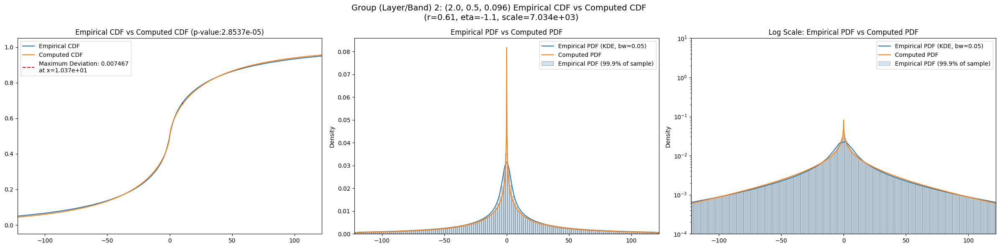

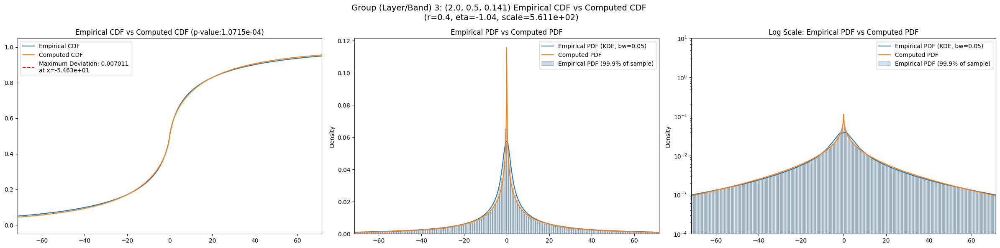

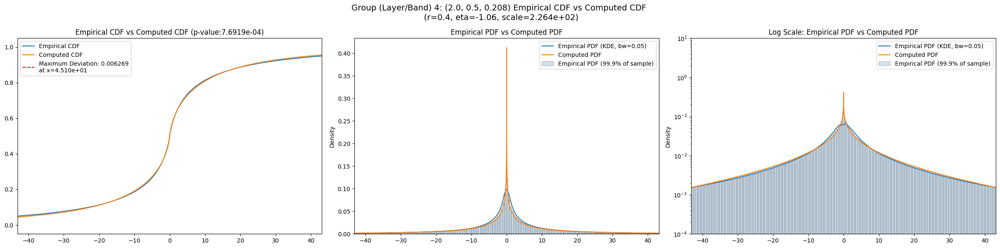

...

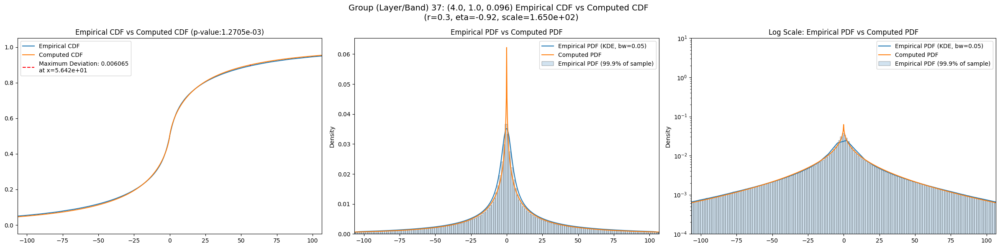

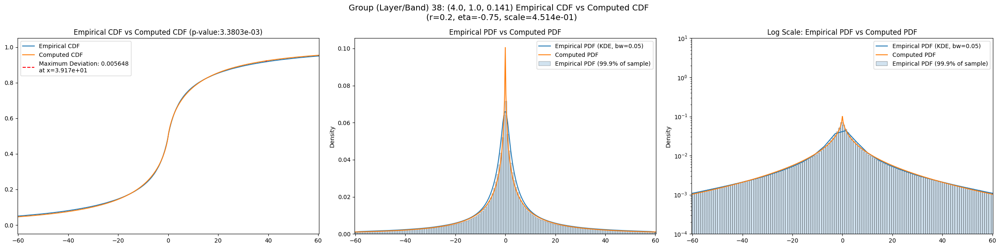

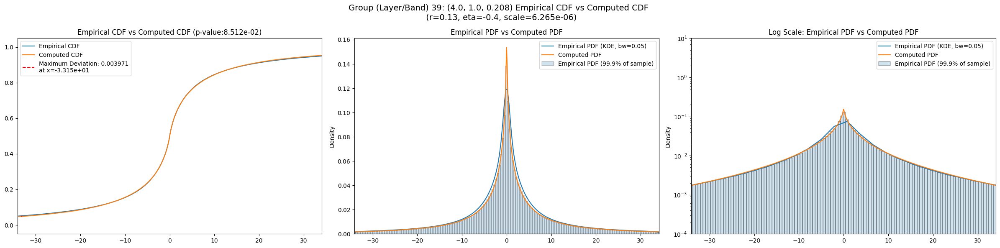

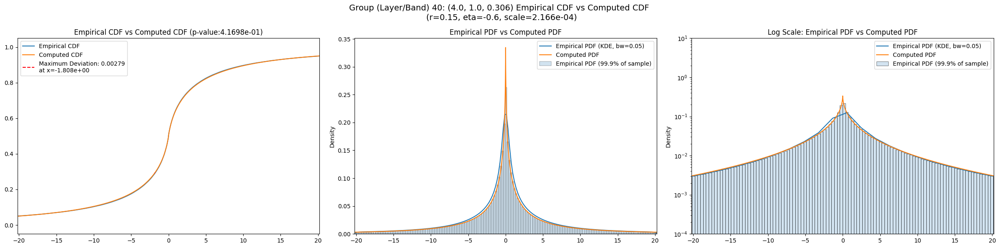

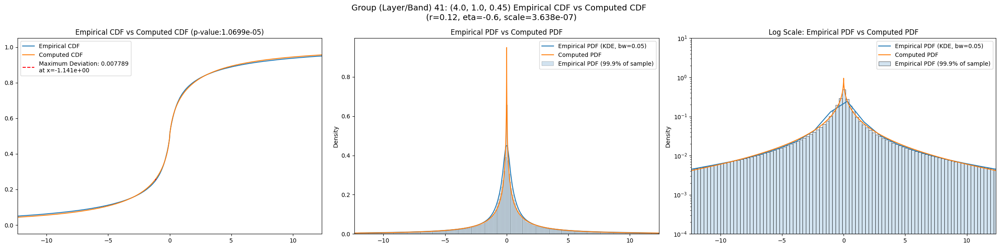

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",49240.44000,38882.65000,60244.74600,4.773906,2.801561,11.781327,65536000.0,"(2.0, 0.5, 0.044)",0.010135,...,130.98200,0.062968,0.0,111.49600,0.037978,0.0,89.11130,0.041758,0.0,0.0
1,"(2.0, 0.5, 0.065)",17537.88500,13703.03100,22308.49800,6.268736,3.636876,14.473557,65536000.0,"(2.0, 0.5, 0.065)",0.006708,...,68.66720,0.070504,0.0,58.54250,0.045417,0.0,46.26600,0.048222,0.0,0.0
2,"(2.0, 0.5, 0.096)",6263.64750,4817.59230,8065.39060,8.682725,4.491842,22.594627,65536000.0,"(2.0, 0.5, 0.096)",0.007730,...,36.01240,0.075475,0.0,30.96910,0.049912,0.0,24.22950,0.051443,0.0,0.0
3,"(2.0, 0.5, 0.141)",2366.95400,1740.60230,3189.22300,11.592262,5.991223,32.245300,65536000.0,"(2.0, 0.5, 0.141)",0.008108,...,19.64910,0.077946,0.0,17.04420,0.052272,0.0,13.22220,0.052668,0.0,0.0
4,"(2.0, 0.5, 0.208)",947.27313,670.49140,1259.57480,13.660814,7.580907,37.590374,65536000.0,"(2.0, 0.5, 0.208)",0.009855,...,11.58690,0.077110,0.0,10.10770,0.051518,0.0,7.80066,0.051272,0.0,0.0
5,"(2.0, 0.5, 0.306)",332.07900,220.95845,459.92392,18.274677,8.888781,51.722927,65536000.0,"(2.0, 0.5, 0.306)",0.008180,...,5.97028,0.078849,0.0,5.19747,0.053747,0.0,3.98990,0.053362,0.0,0.0
6,"(2.0, 0.5, 0.45)",206.10092,141.26283,293.74957,18.116974,9.422618,55.211193,65536000.0,"(2.0, 0.5, 0.45)",0.010424,...,4.52703,0.081897,0.0,3.94346,0.056784,0.0,3.02857,0.056167,0.0,0.0
7,"(2.0, 1.0, 0.044)",69678.76000,56125.30500,86983.69000,5.744799,3.133826,17.976940,65536000.0,"(2.0, 1.0, 0.044)",0.006721,...,161.29000,0.055204,0.0,137.85200,0.029753,0.0,110.32600,0.033633,0.0,0.0
8,"(2.0, 1.0, 0.065)",24894.46500,19084.35500,32298.96900,8.052679,3.912416,27.094390,65536000.0,"(2.0, 1.0, 0.065)",0.004756,...,85.18120,0.062728,0.0,72.62940,0.037632,0.0,57.68260,0.040923,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.010135,0.000168,0.006354,0.062968,0.037978,0.041758
1,0.006708,0.000168,0.005707,0.070504,0.045417,0.048222
2,0.007730,0.000168,0.007467,0.075475,0.049912,0.051443
3,0.008108,0.000168,0.007011,0.077946,0.052272,0.052668
4,0.009855,0.000168,0.006269,0.077110,0.051518,0.051272
5,0.008180,0.000168,0.008173,0.078849,0.053747,0.053362
6,0.010424,0.000168,0.010413,0.081897,0.056784,0.056167
7,0.006721,0.000168,0.003916,0.055204,0.029753,0.033633
8,0.004756,0.000168,0.003720,0.062728,0.037632,0.040923


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,49240.441406,0.006354,0.90,-1.05,9.753571e+04,0.0
1,17537.884766,0.005707,0.77,-1.10,3.198206e+04,0.0
2,5955.544434,0.007467,0.61,-1.10,7.034449e+03,50.0
3,2366.954102,0.007011,0.40,-1.04,5.611279e+02,0.0
4,884.612366,0.006269,0.40,-1.06,2.264114e+02,50.0
5,275.971802,0.008173,0.40,-1.09,7.965627e+01,150.0
6,171.759354,0.010413,0.39,-1.10,4.608722e+01,150.0
7,68023.523438,0.003916,0.80,-0.99,1.000000e+05,25.0
8,22874.410156,0.003720,0.90,-1.08,4.870903e+04,100.0
